In [1]:
import pandas_profiling as pp
import pandas as pd
import plotly.express as px
import seaborn as sns
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
import scipy.stats as stats
%config InlineBackend.figure_format = 'retina' #set 'png' here when working on notebook
%matplotlib inline
sns.set(color_codes=True)
from sklearn.preprocessing import power_transform
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import QuantileTransformer
from matplotlib.axes._axes import _log as matplotlib_axes_logger
matplotlib_axes_logger.setLevel('ERROR')
from sklearn.model_selection import KFold, cross_val_score
from sklearn.linear_model import Ridge, RidgeCV, ElasticNet, LassoCV, LassoLarsCV

In [2]:
train = pd.read_csv('train.csv')
test = pd.read_csv('test.csv')

In [3]:
all_df = pd.concat([train, test])

In [3]:
y = train.SalePrice

In [4]:
train = train.drop(['SalePrice', 'Id'],  axis = 1)

In [6]:
all_df.shape

(2919, 81)

In [7]:
all_df = all_df.drop(['SalePrice', 'Id'],  axis = 1)

In [5]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 79 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   MSSubClass     1460 non-null   int64  
 1   MSZoning       1460 non-null   object 
 2   LotFrontage    1201 non-null   float64
 3   LotArea        1460 non-null   int64  
 4   Street         1460 non-null   object 
 5   Alley          91 non-null     object 
 6   LotShape       1460 non-null   object 
 7   LandContour    1460 non-null   object 
 8   Utilities      1460 non-null   object 
 9   LotConfig      1460 non-null   object 
 10  LandSlope      1460 non-null   object 
 11  Neighborhood   1460 non-null   object 
 12  Condition1     1460 non-null   object 
 13  Condition2     1460 non-null   object 
 14  BldgType       1460 non-null   object 
 15  HouseStyle     1460 non-null   object 
 16  OverallQual    1460 non-null   int64  
 17  OverallCond    1460 non-null   int64  
 18  YearBuil

In [9]:
# for categorical data
train

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,...,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,...,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal
1,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,...,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal
2,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,...,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal
3,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,...,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml
4,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,...,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,60,RL,62.0,7917,Pave,NaN,Reg,Lvl,AllPub,Inside,...,0,0,NaN,NaN,NaN,0,8,2007,WD,Normal
1456,20,RL,85.0,13175,Pave,NaN,Reg,Lvl,AllPub,Inside,...,0,0,NaN,MnPrv,NaN,0,2,2010,WD,Normal
1457,70,RL,66.0,9042,Pave,NaN,Reg,Lvl,AllPub,Inside,...,0,0,NaN,GdPrv,Shed,2500,5,2010,WD,Normal
1458,20,RL,68.0,9717,Pave,NaN,Reg,Lvl,AllPub,Inside,...,0,0,NaN,NaN,NaN,0,4,2010,WD,Normal


In [10]:
# for numerical data
train.describe().T

,count,mean,std,min,25%,50%,75%,max
MSSubClass,1460.0,56.897260,42.300571,20.0,20.00,50.0,70.00,190.0
LotFrontage,1201.0,70.049958,24.284752,21.0,59.00,69.0,80.00,313.0
LotArea,1460.0,10516.828082,9981.264932,1300.0,7553.50,9478.5,11601.50,215245.0
OverallQual,1460.0,6.099315,1.382997,1.0,5.00,6.0,7.00,10.0
OverallCond,1460.0,5.575342,1.112799,1.0,5.00,5.0,6.00,9.0
YearBuilt,1460.0,1971.267808,30.202904,1872.0,1954.00,1973.0,2000.00,2010.0
YearRemodAdd,1460.0,1984.865753,20.645407,1950.0,1967.00,1994.0,2004.00,2010.0
MasVnrArea,1452.0,103.685262,181.066207,0.0,0.00,0.0,166.00,1600.0
BsmtFinSF1,1460.0,443.639726,456.098091,0.0,0.00,383.5,712.25,5644.0
BsmtFinSF2,1460.0,46.549315,161.319273,0.0,0.00,0.0,0.00,1474.0


In [11]:
# many numerical signs have many zeros in the data

In [7]:
numerical = train.select_dtypes(include='number').columns
categorial = train.select_dtypes(include='object').columns

In [13]:
# look at the distribution by numerical characteristics

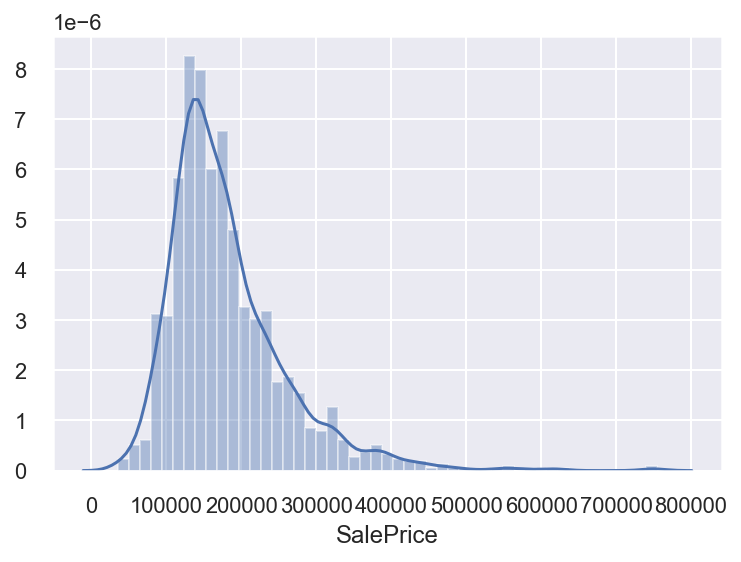

In [14]:
sns.distplot(y); 

In [15]:
#  skewed distribution of the dependent variable

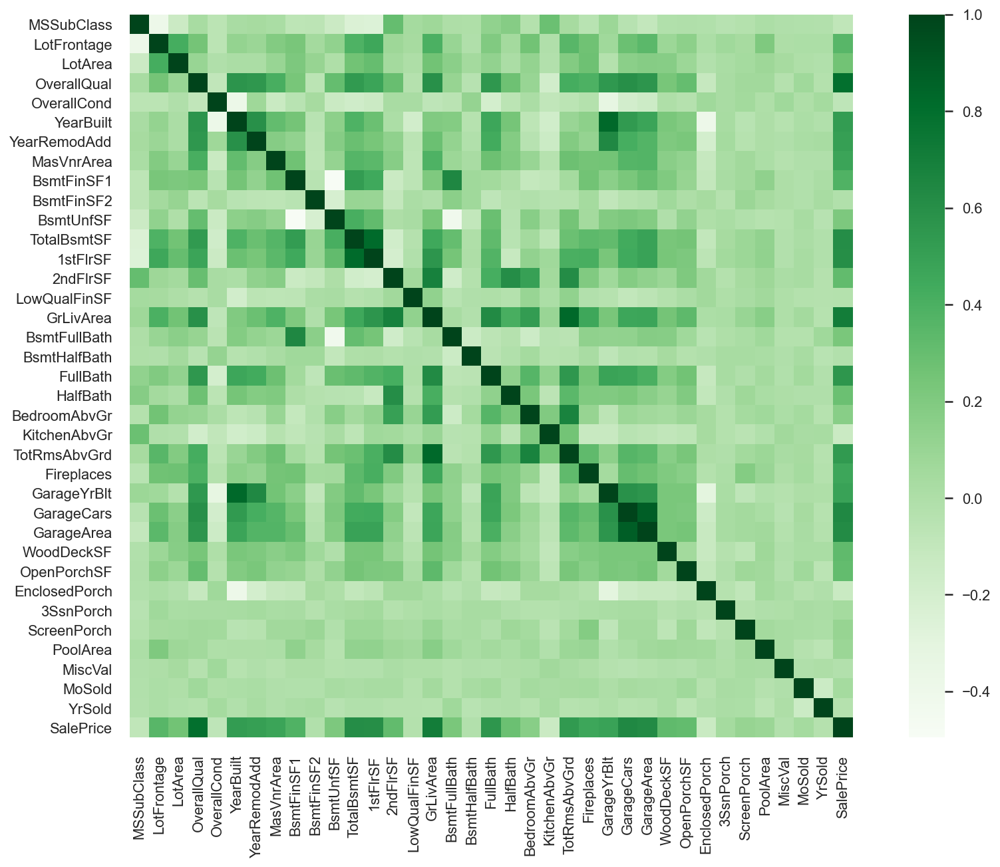

In [16]:
# Which features are the most correlated to our target variable, SalePrice?
corr_matrix = pd.concat([train, y], axis = 1).corr()
plt.subplots(figsize=(15,10))
sns.heatmap(corr_matrix, vmax=1.0, square=True, cmap="Greens");

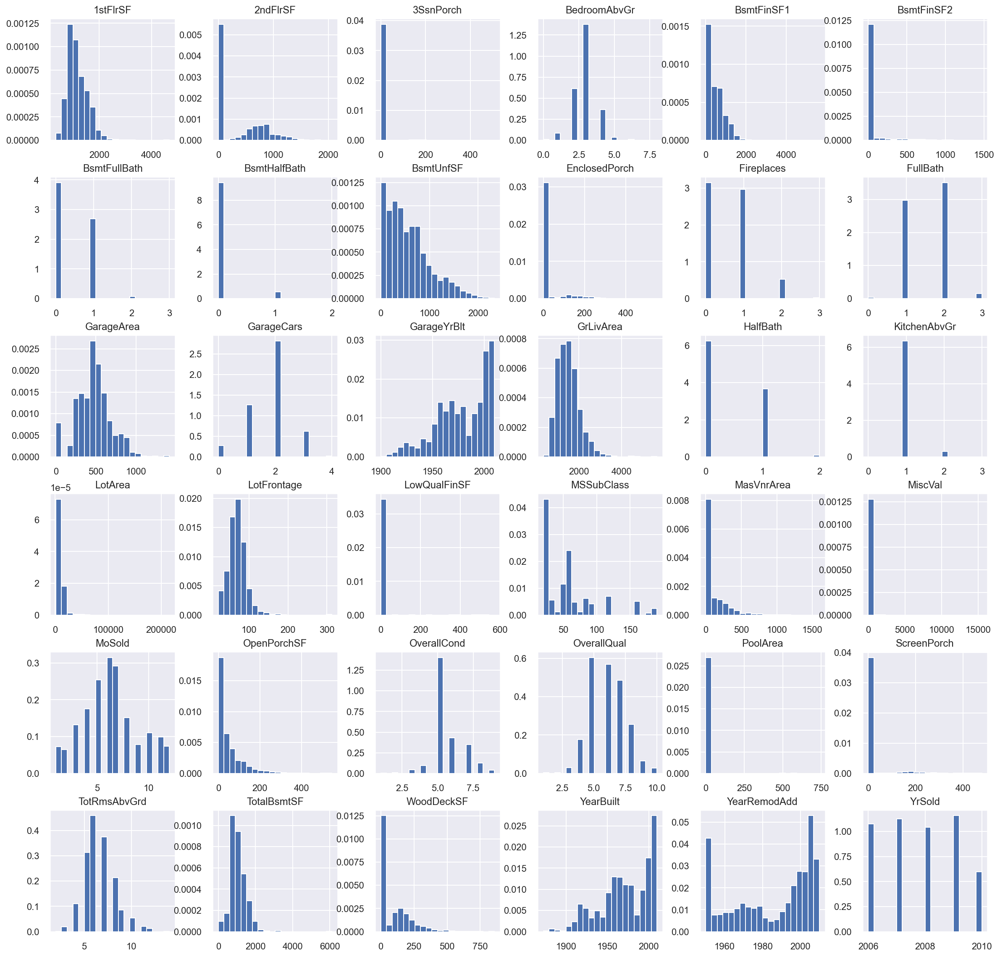

In [8]:
train[numerical].hist(figsize = (20, 20), bins = 20, density = True);

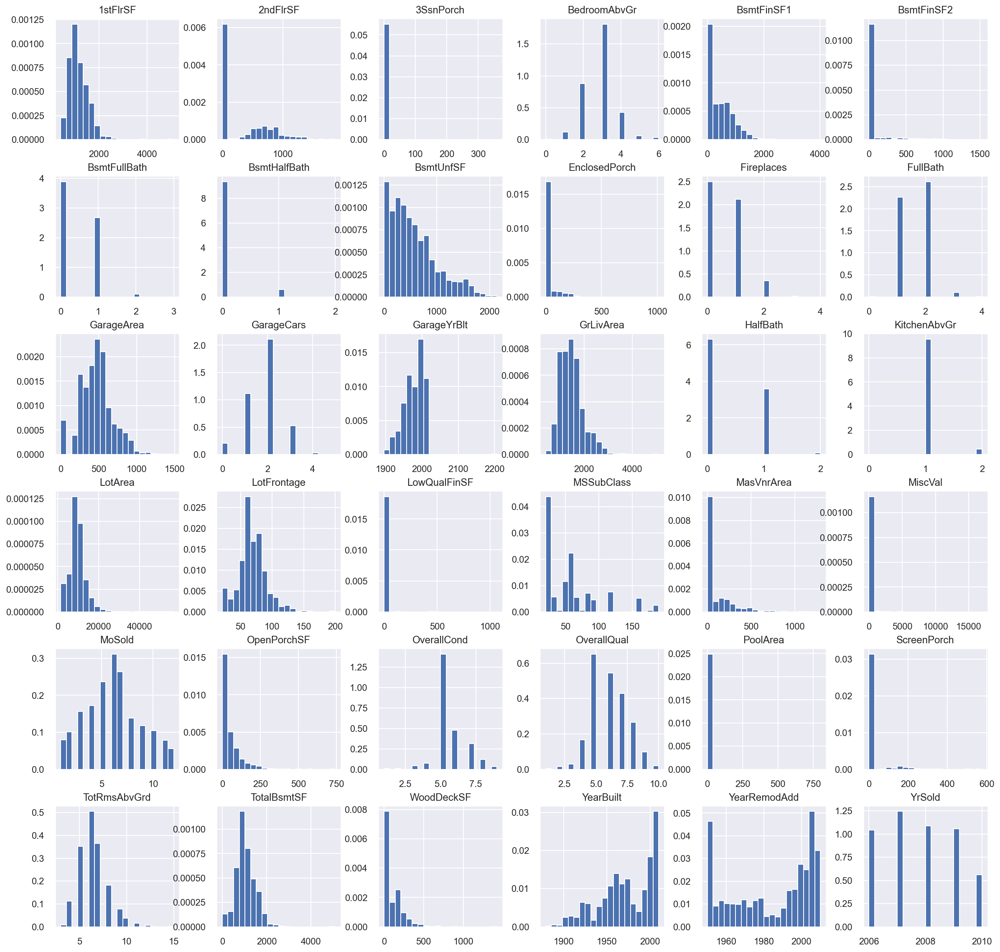

In [18]:
test[numerical].hist(figsize = (20, 20), bins = 20, density = True);

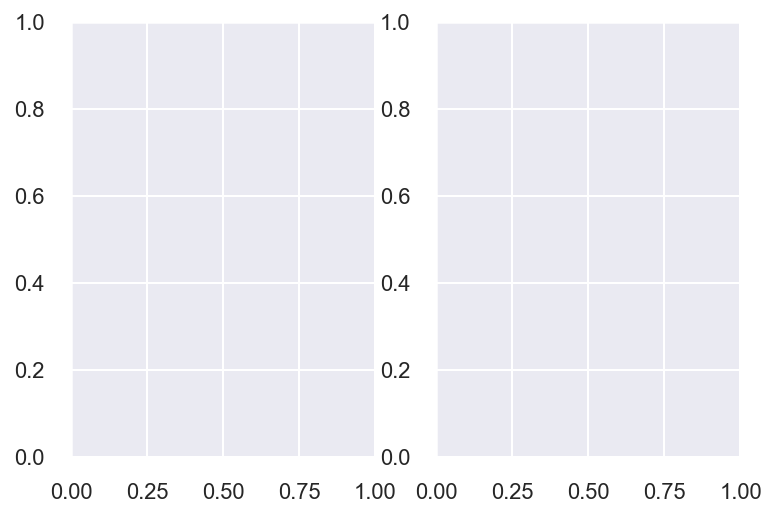

In [17]:
f, ax = plt.subplots(1, 2)

In [19]:
ax[1]

In [100]:
sum(train['BsmtFinSF2']==0)/1457

0.8860672614962252

In [101]:
sum(train['LowQualFinSF']==0)/1457

0.9821551132463967

In [102]:
numerical

Index(['MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual', 'OverallCond',
       'YearBuilt', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2',
       'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF',
       'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd', 'Fireplaces',
       'GarageYrBlt', 'GarageCars', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF',
       'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'MiscVal',
       'MoSold', 'YrSold'],
      dtype='object')

In [103]:
sum(train['EnclosedPorch']==0)/1457

0.8579272477693891

In [104]:
sum(train['3SsnPorch']==0)/1457

0.9835277968428278

In [105]:
sum(train['MiscVal']==0)/1457

0.9643102264927934

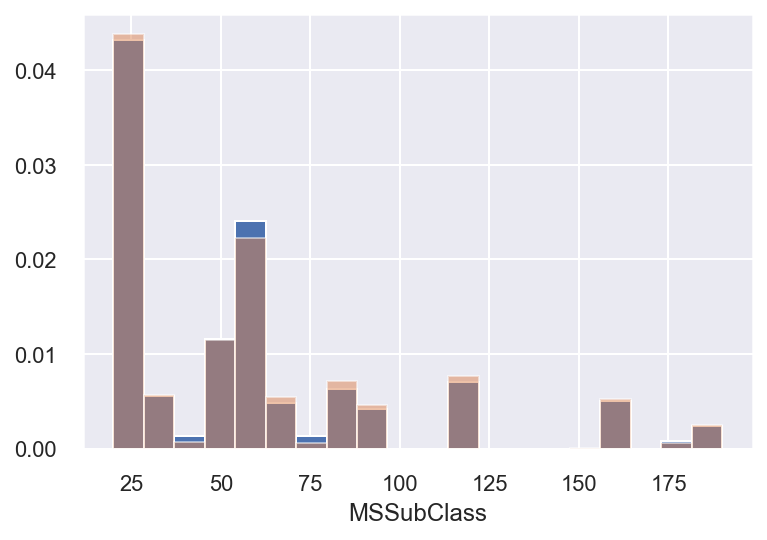

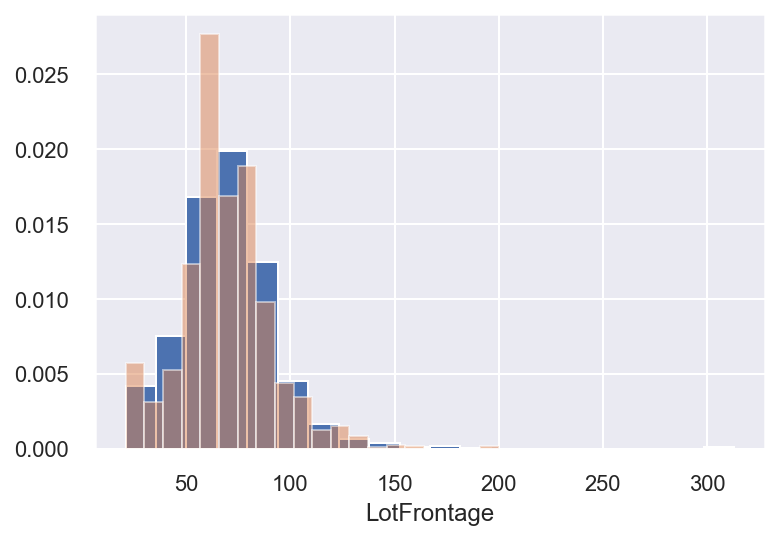

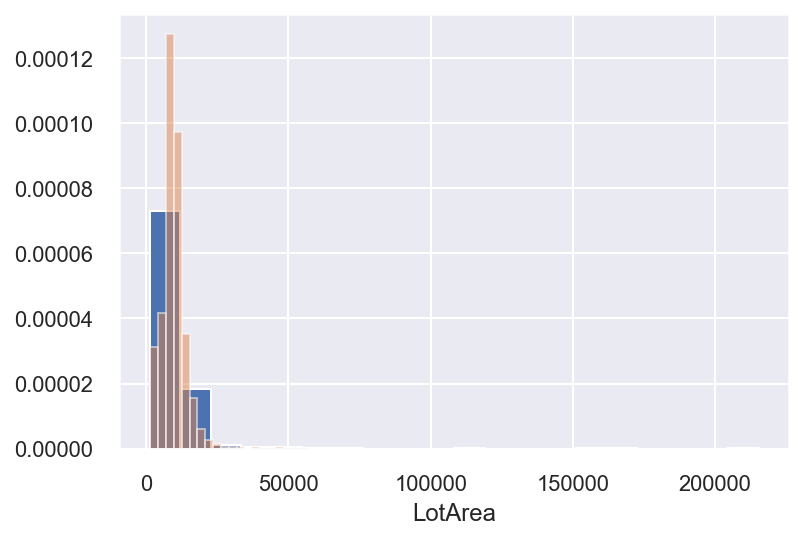

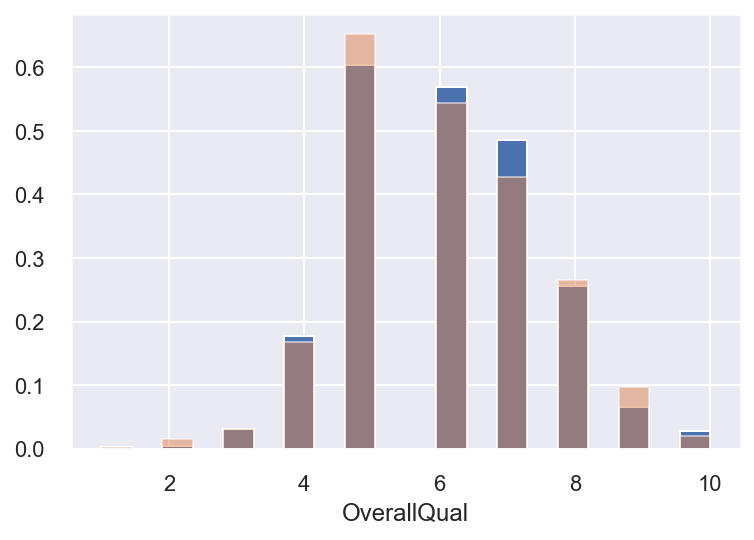

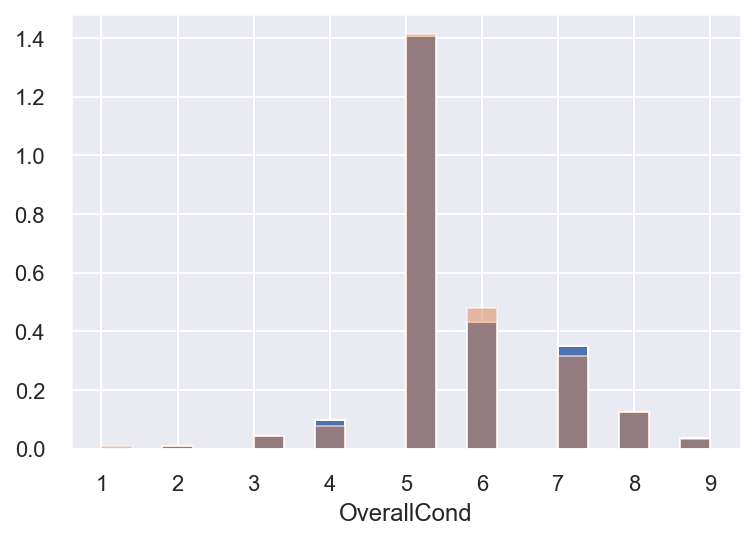

...

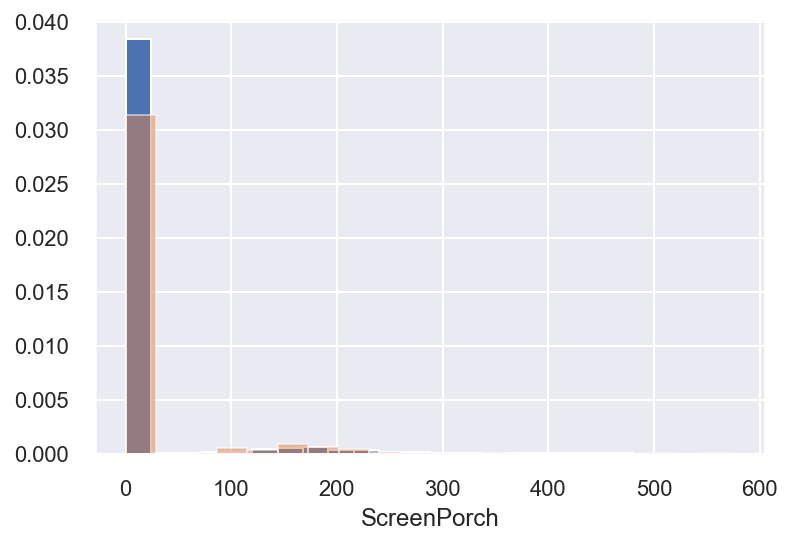

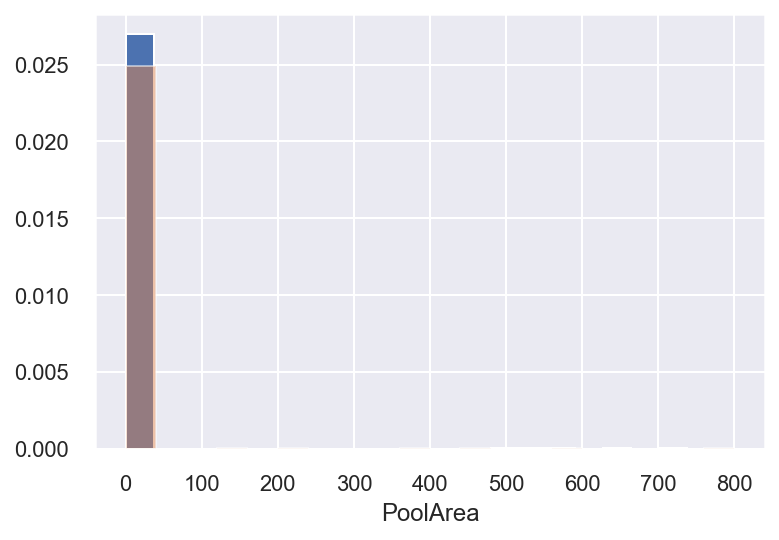

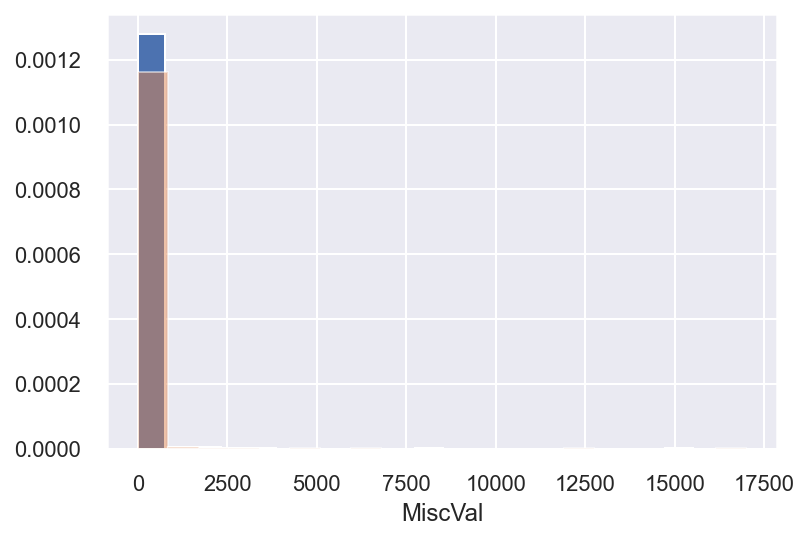

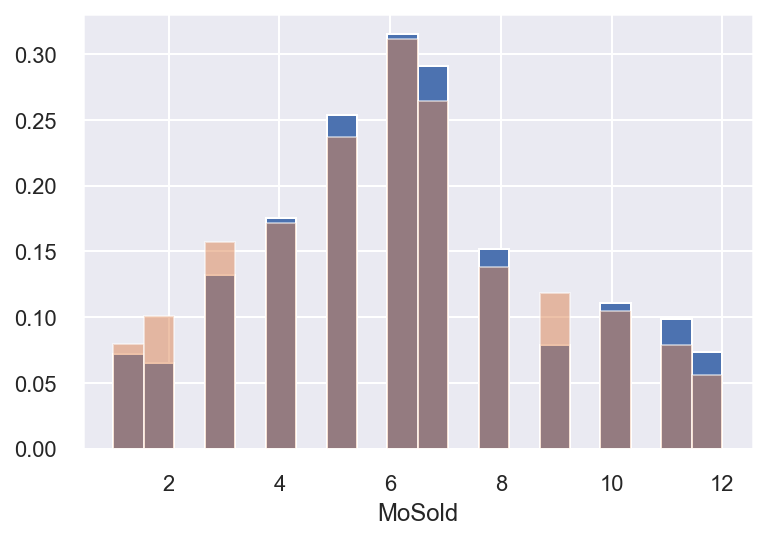

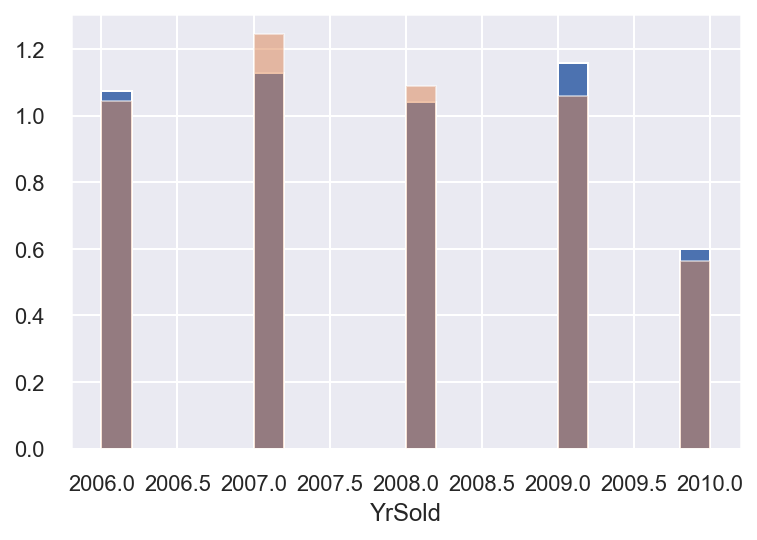

In [26]:
for i in numerical:
    f, ax = plt.subplots()
    ax.hist(train[i],  bins = 20, density = True, );
    ax.hist(test[i], bins = 20, density = True, alpha = 0.5);
    ax.set_xlabel(i)
    plt.show();

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



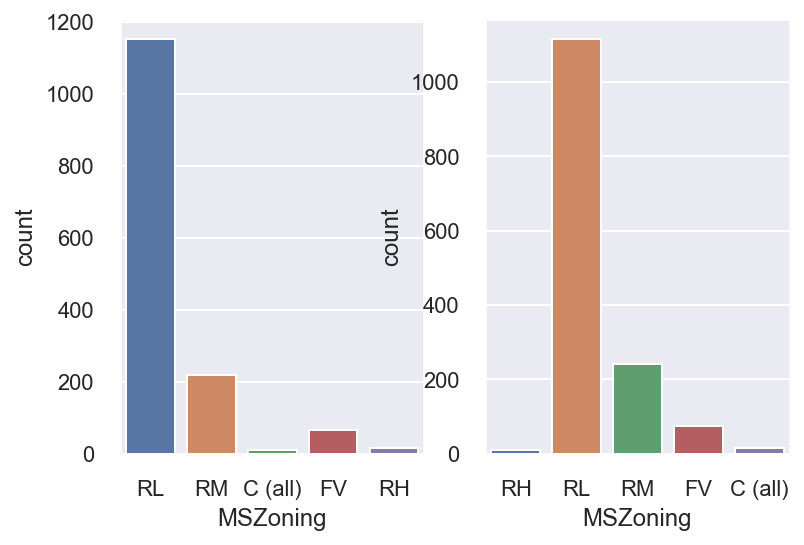

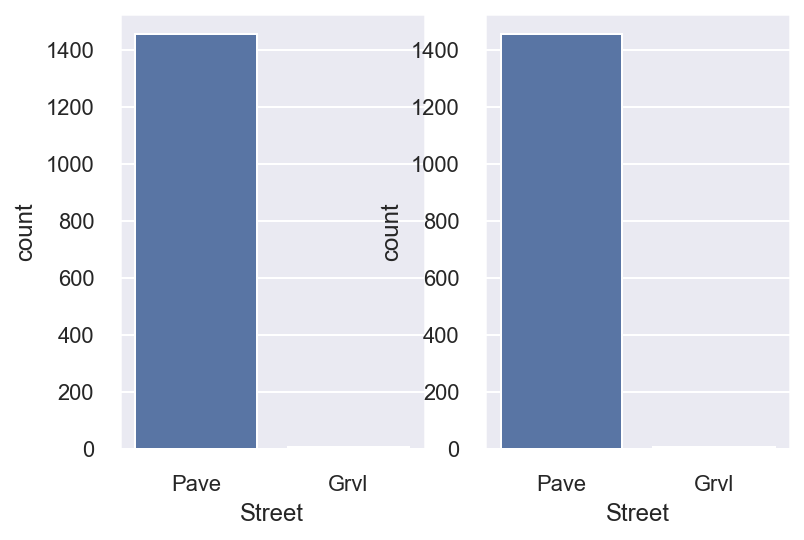

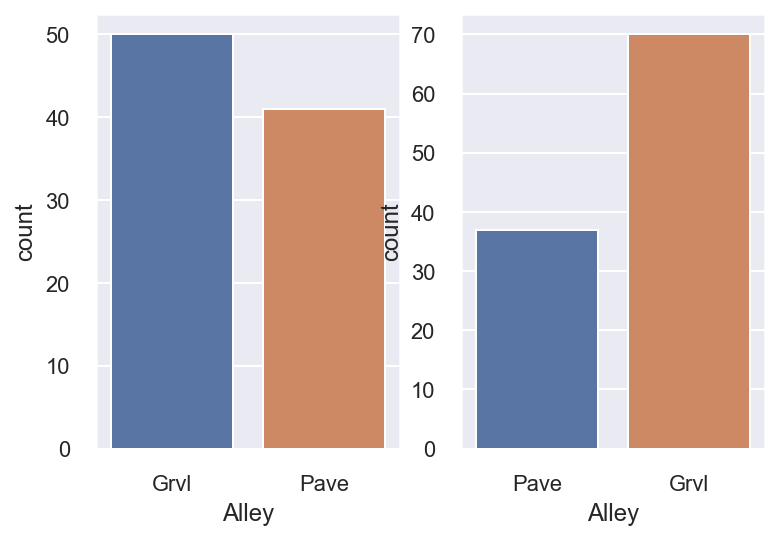

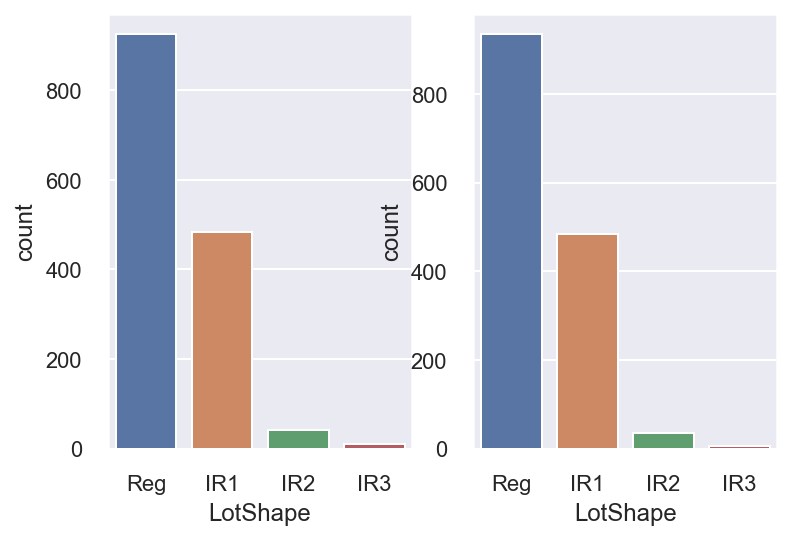

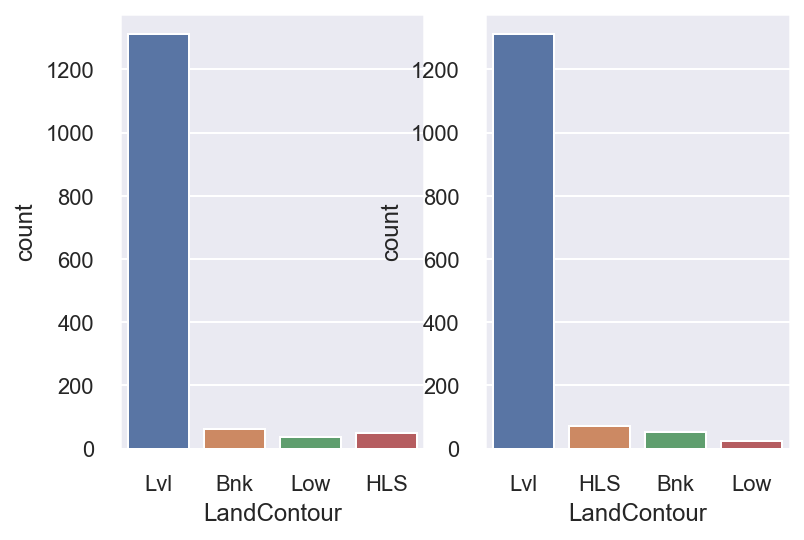

...

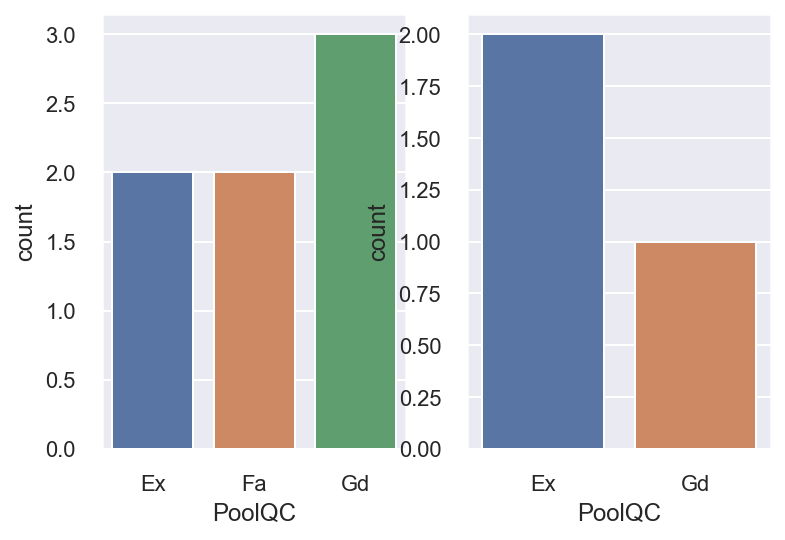

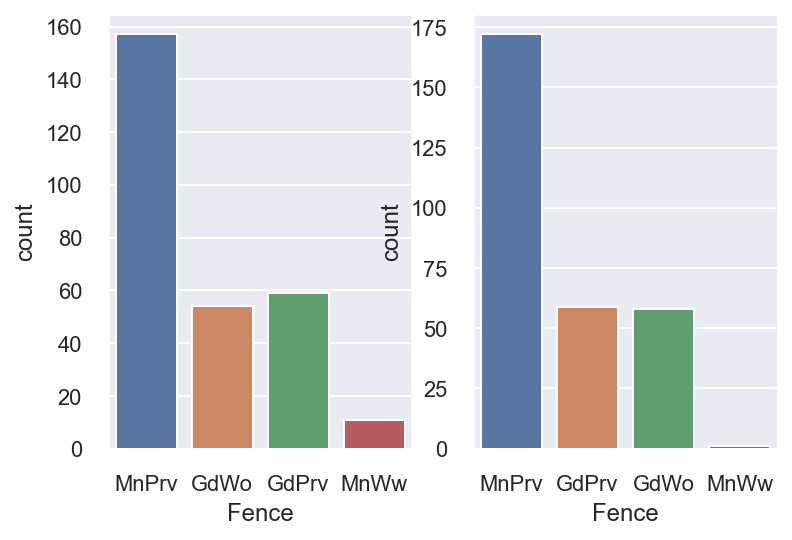

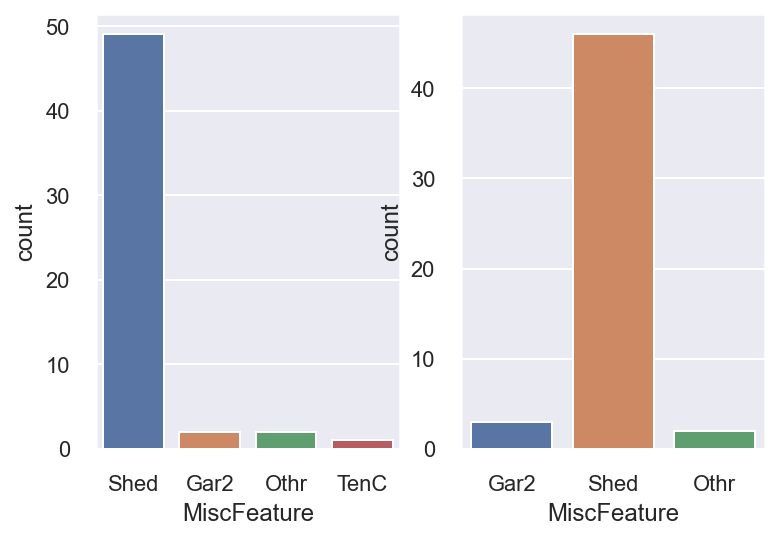

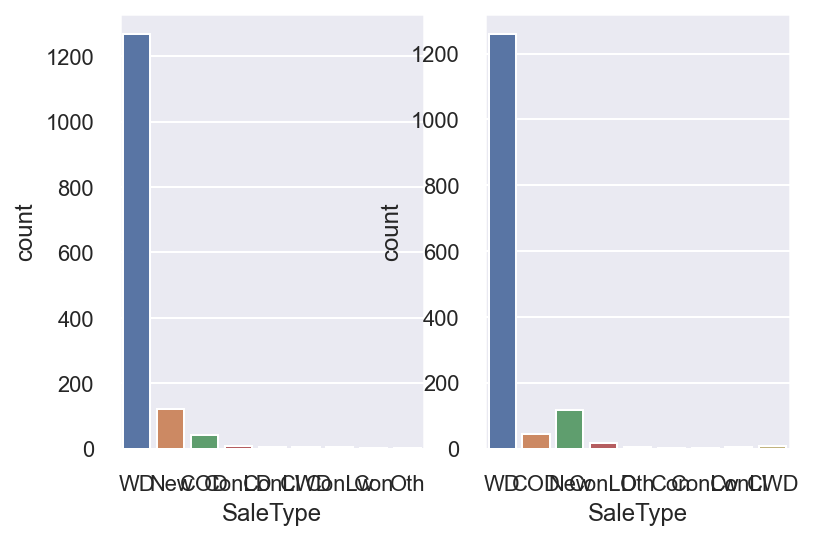

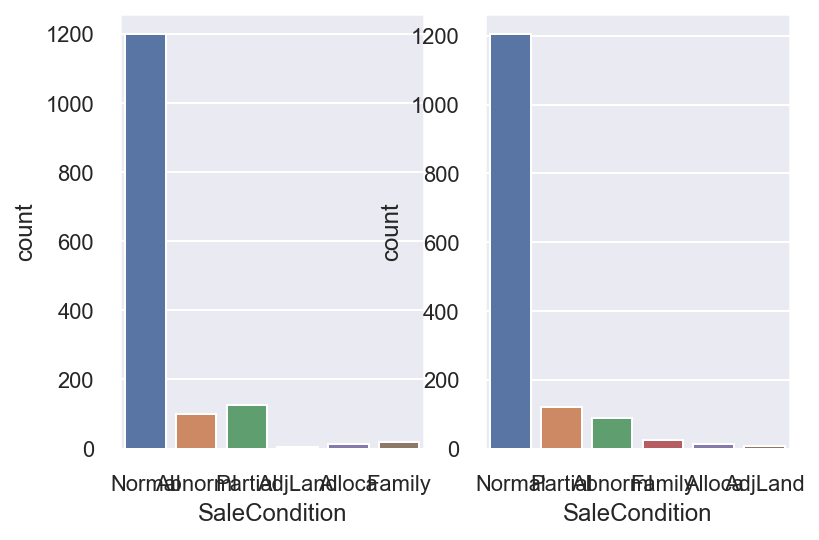

In [31]:
for i in categorial:
    f, ax = plt.subplots(1, 2)
    sns.countplot(train[i], ax=ax[0])
    sns.countplot(test[i], ax=ax[1])
    f.show();

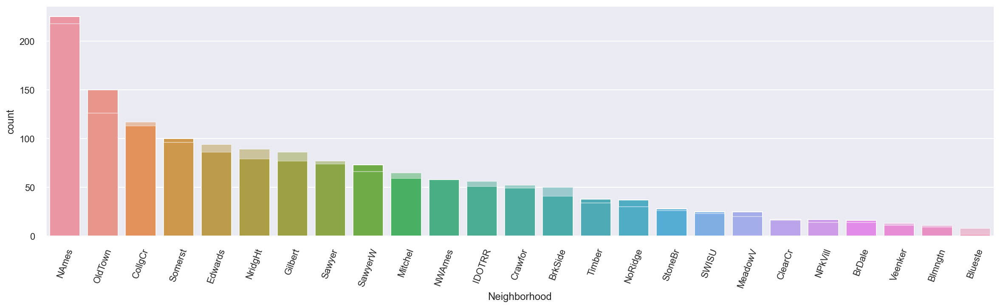

In [77]:
f = plt.figure(figsize = (20, 5))
sns.countplot(train['Neighborhood'], order = train['Neighborhood'].value_counts().index)
sns.countplot(test['Neighborhood'], order = test['Neighborhood'].value_counts().index, alpha = 0.5 )
plt.xticks(rotation=70)
plt.show();

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:8: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



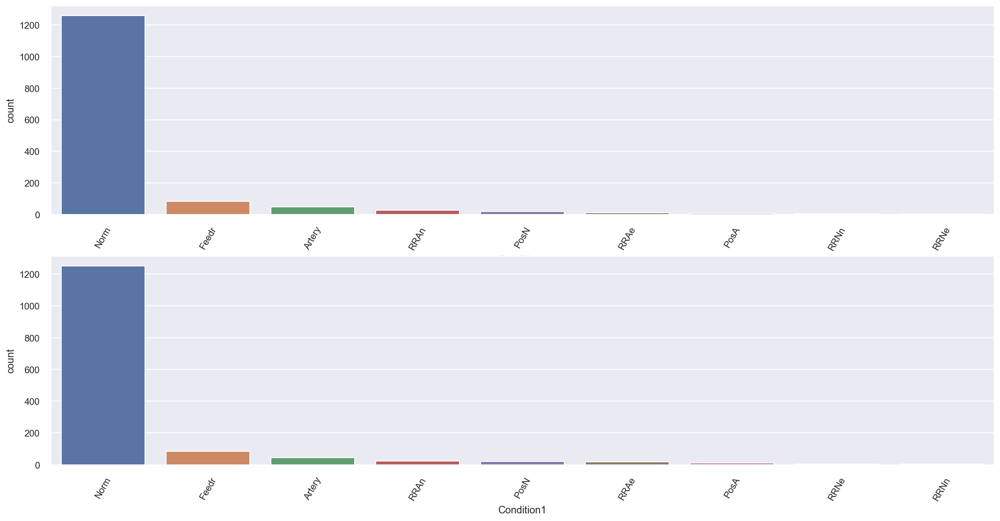

In [80]:
f, ax = plt.subplots(2,1,  figsize = (20, 10))
sns.countplot(train['Condition1'],  ax=ax[0], order = train['Condition1'].value_counts().index)
# plt.xticks(rotation=70)
sns.countplot(test['Condition1'], ax=ax[1], order = test['Condition1'].value_counts().index)
# plt.xticks(rotation=70)
ax[0].set_xticklabels(ax[0].get_xticklabels(),rotation=60)
ax[1].set_xticklabels(ax[1].get_xticklabels(),rotation=60)
f.show();

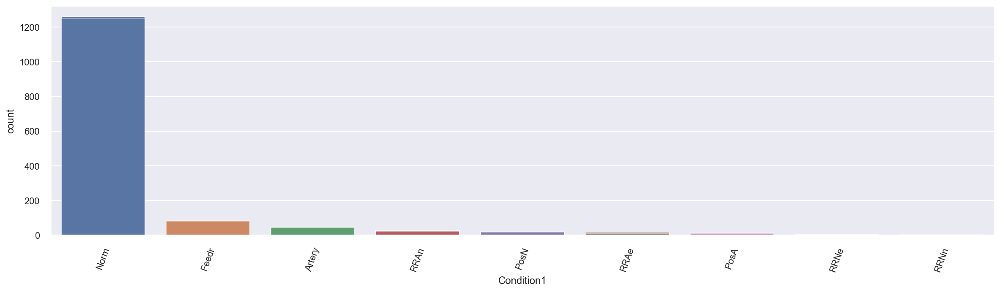

In [79]:
f = plt.figure(figsize = (20, 5))
sns.countplot(train['Condition1'], order = train['Condition1'].value_counts().index)
sns.countplot(test['Condition1'], order = test['Condition1'].value_counts().index, alpha = 0.5 )
plt.xticks(rotation=70)
plt.show();

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:8: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



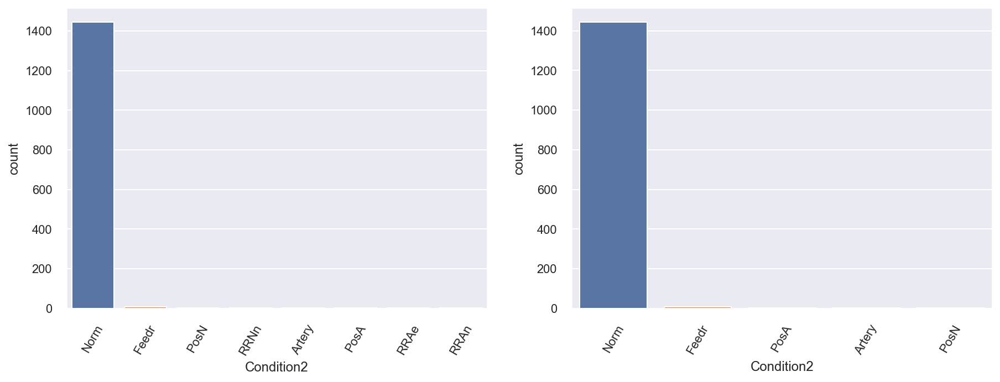

In [84]:
f, ax = plt.subplots(1,2,  figsize = (15, 5))
sns.countplot(train['Condition2'],  ax=ax[0], order = train['Condition2'].value_counts().index)
# plt.xticks(rotation=70)
sns.countplot(test['Condition2'], ax=ax[1], order = test['Condition2'].value_counts().index)
# plt.xticks(rotation=70)
ax[0].set_xticklabels(ax[0].get_xticklabels(),rotation=60)
ax[1].set_xticklabels(ax[1].get_xticklabels(),rotation=60)
f.show();

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:8: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



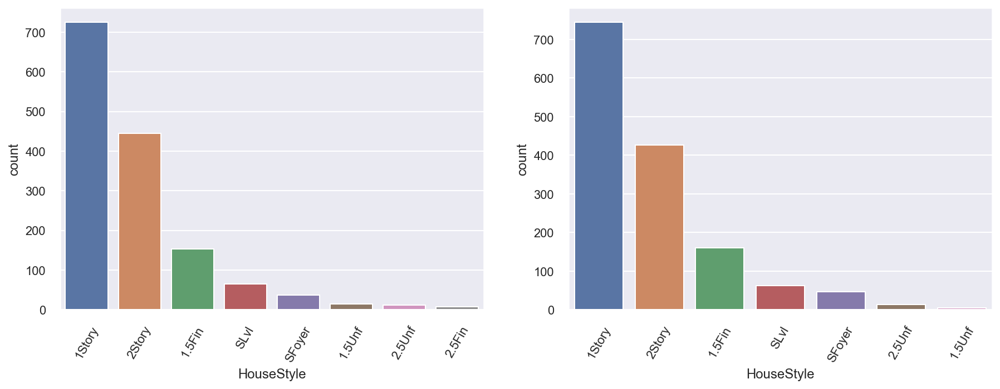

In [85]:
f, ax = plt.subplots(1,2,  figsize = (15, 5))
sns.countplot(train['HouseStyle'],  ax=ax[0], order = train['HouseStyle'].value_counts().index)
# plt.xticks(rotation=70)
sns.countplot(test['HouseStyle'], ax=ax[1], order = test['HouseStyle'].value_counts().index)
# plt.xticks(rotation=70)
ax[0].set_xticklabels(ax[0].get_xticklabels(),rotation=60)
ax[1].set_xticklabels(ax[1].get_xticklabels(),rotation=60)
f.show();

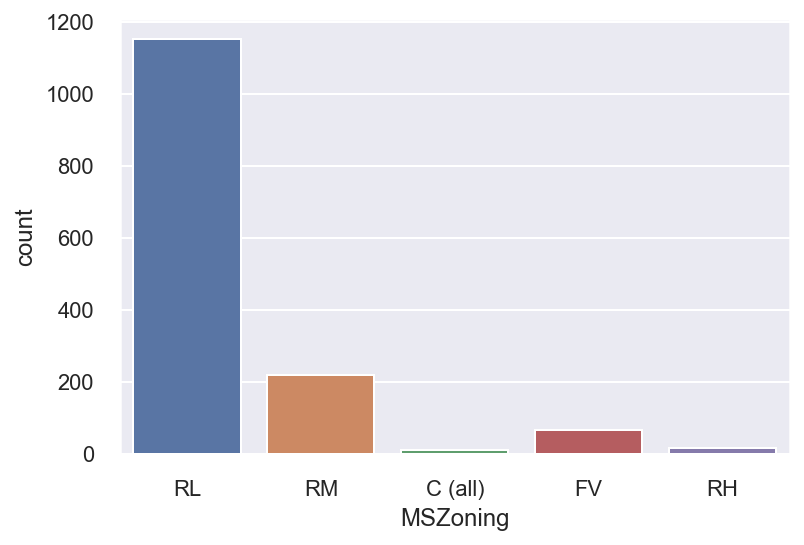

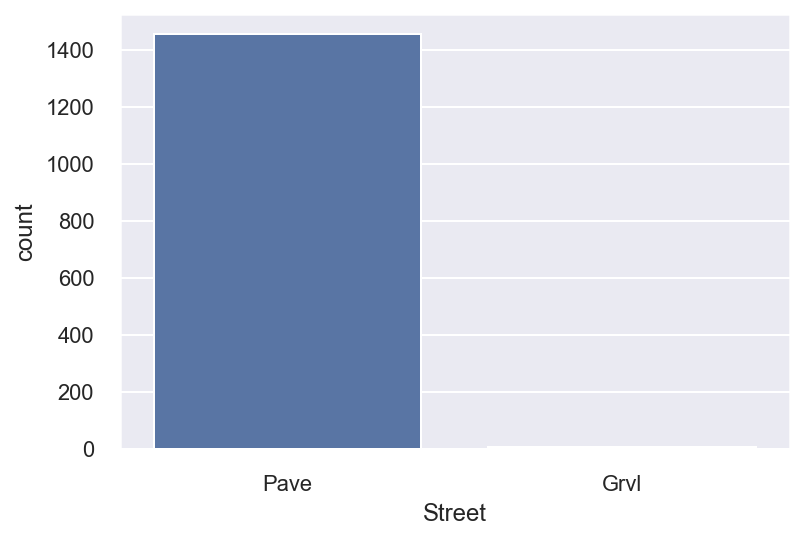

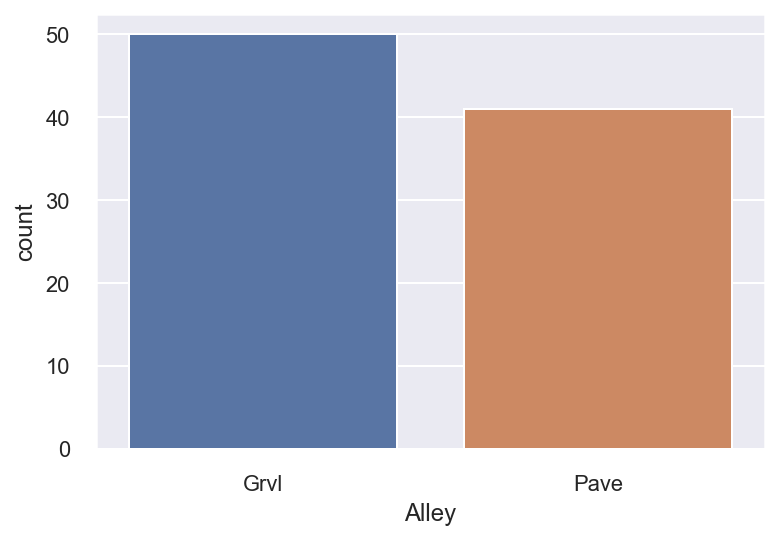

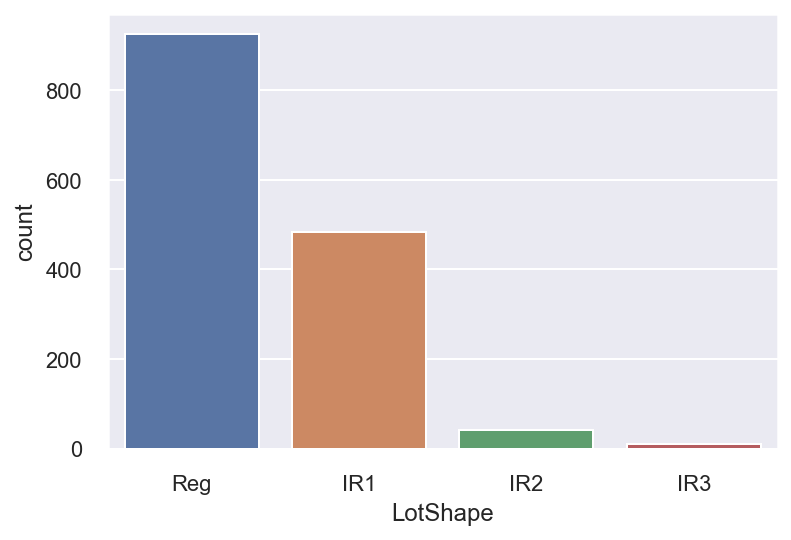

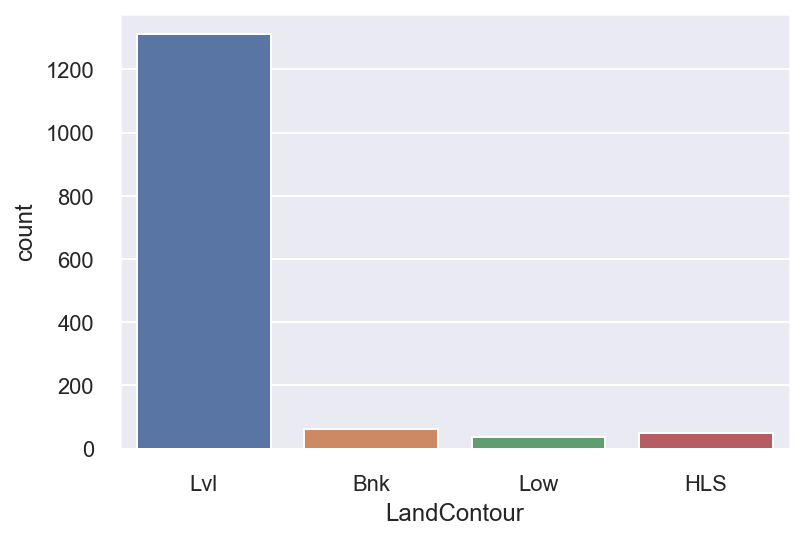

...

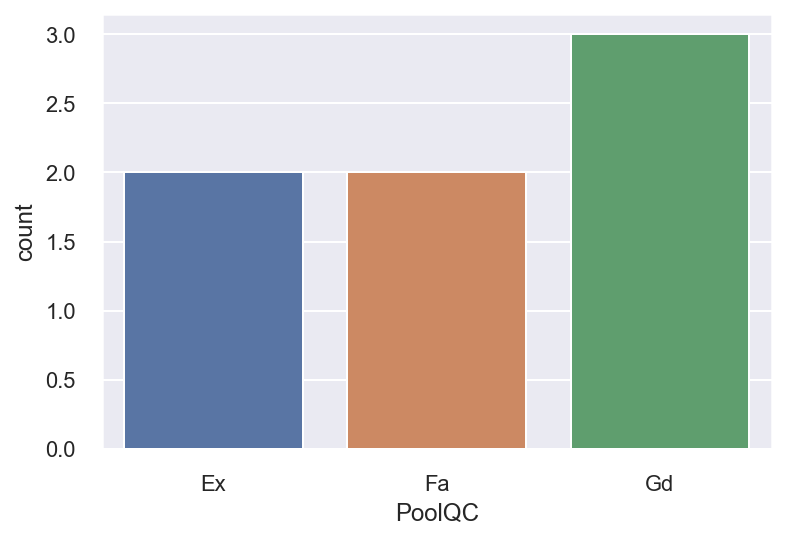

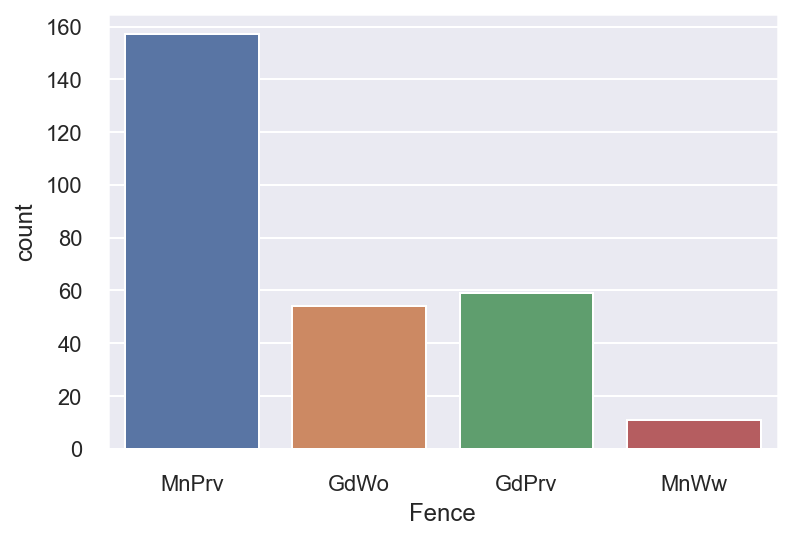

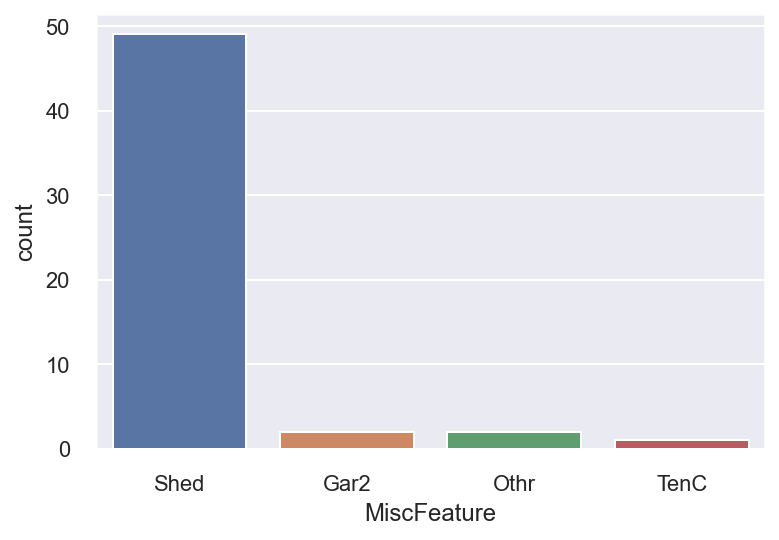

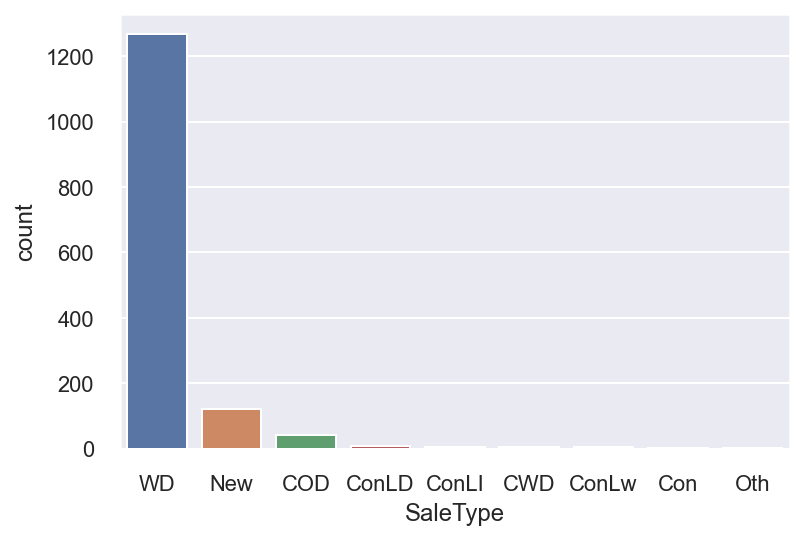

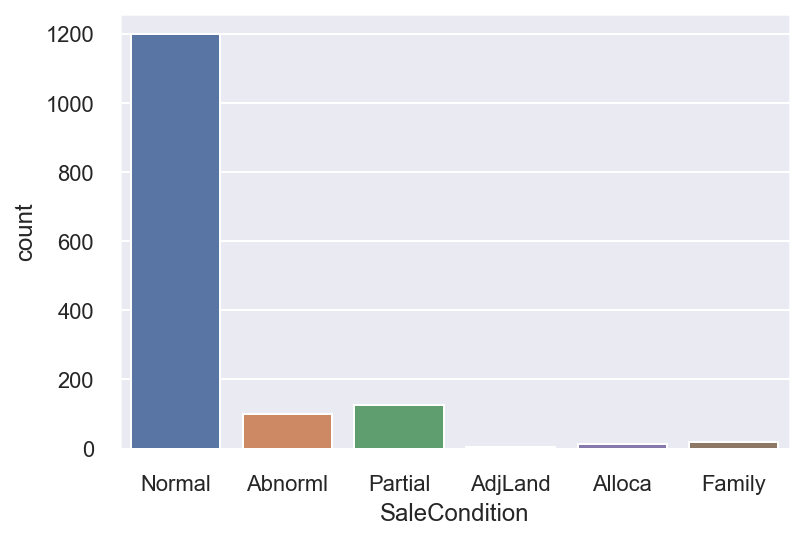

In [19]:
for i in categorial:
    sns.countplot(train[i])
    plt.show();

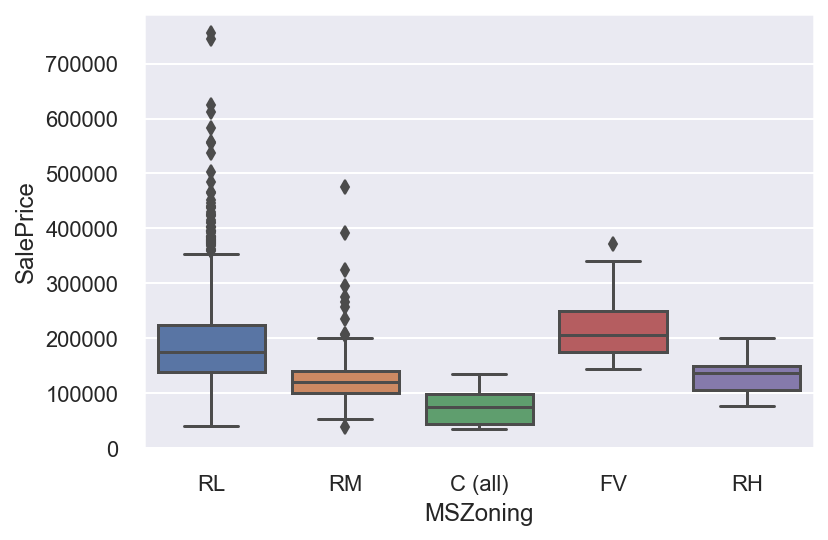

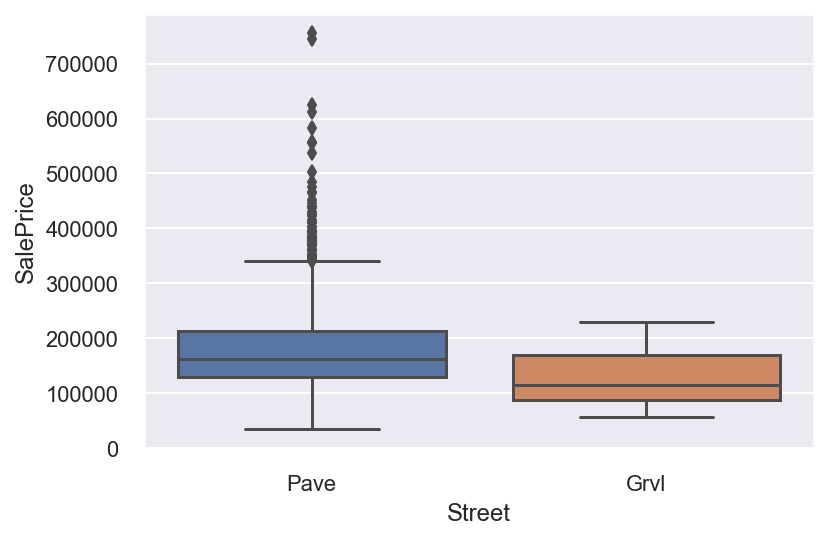

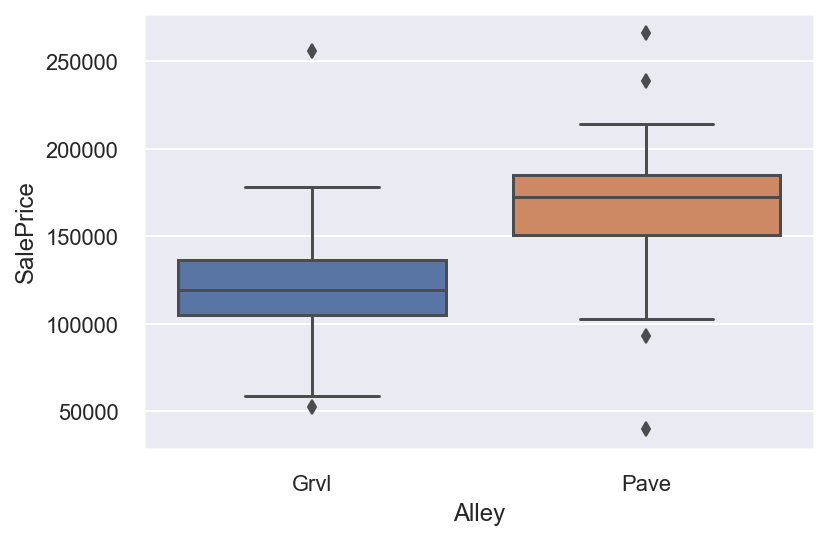

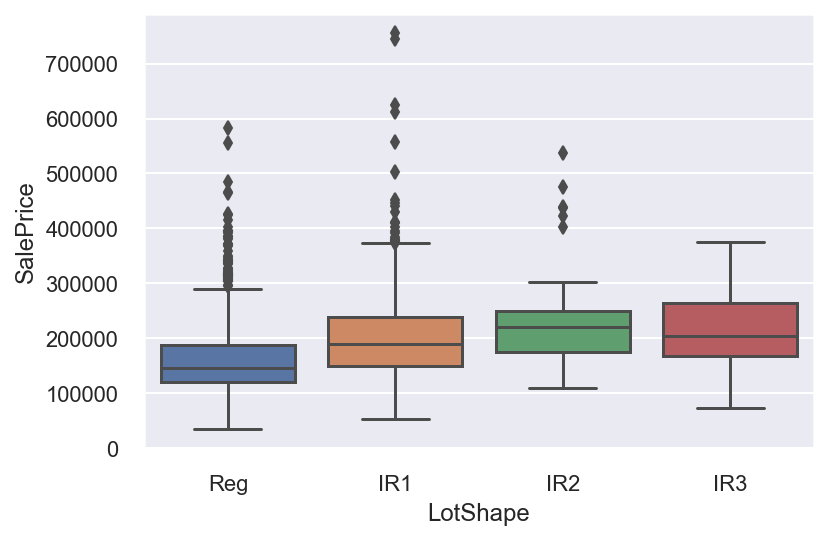

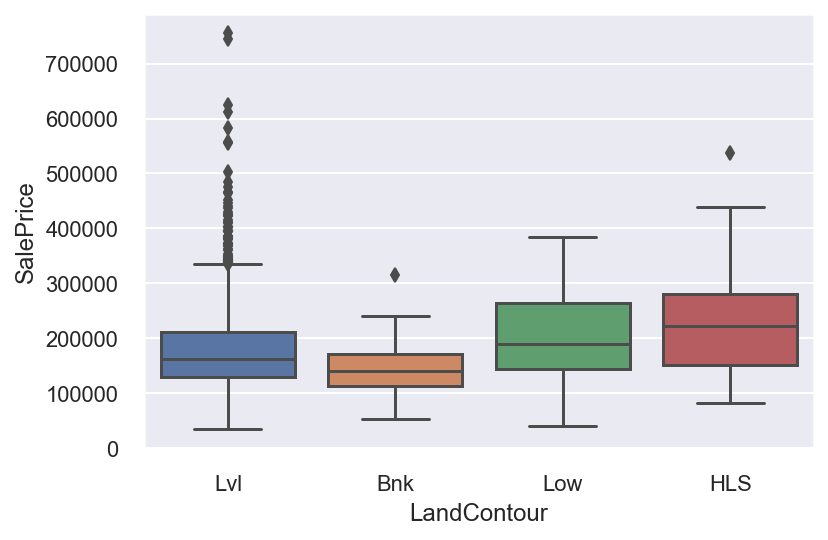

...

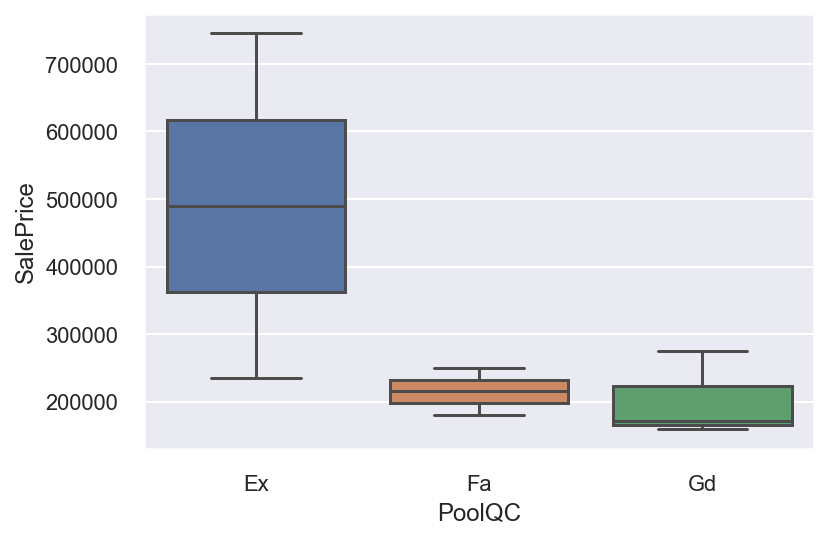

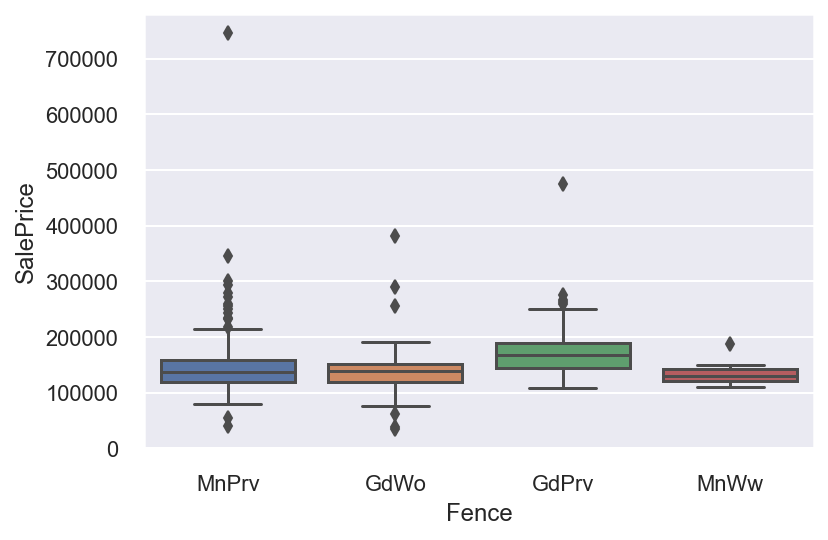

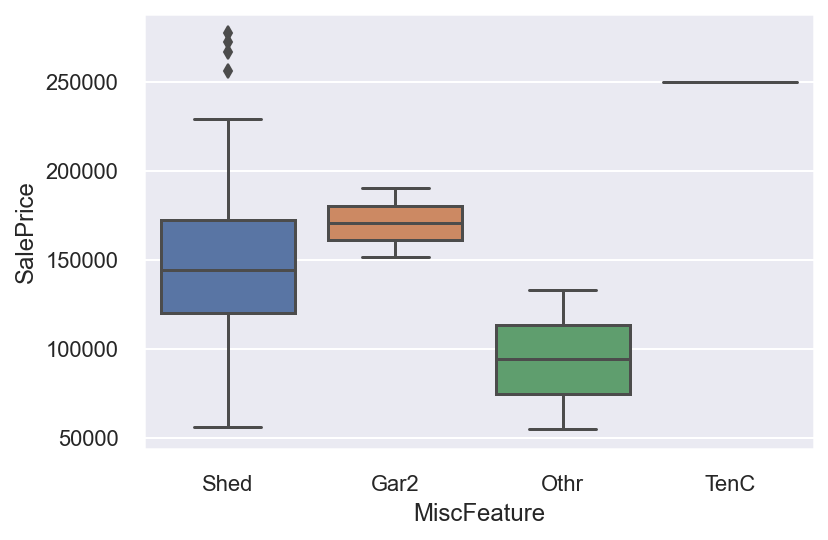

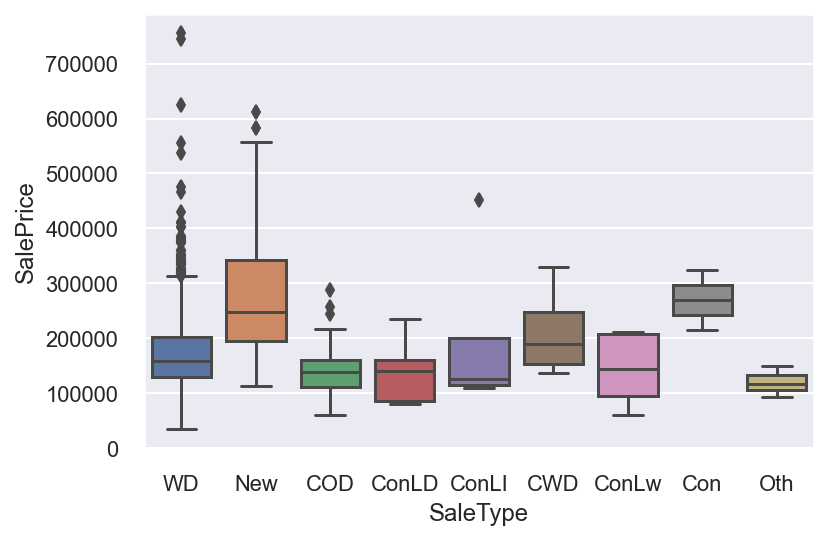

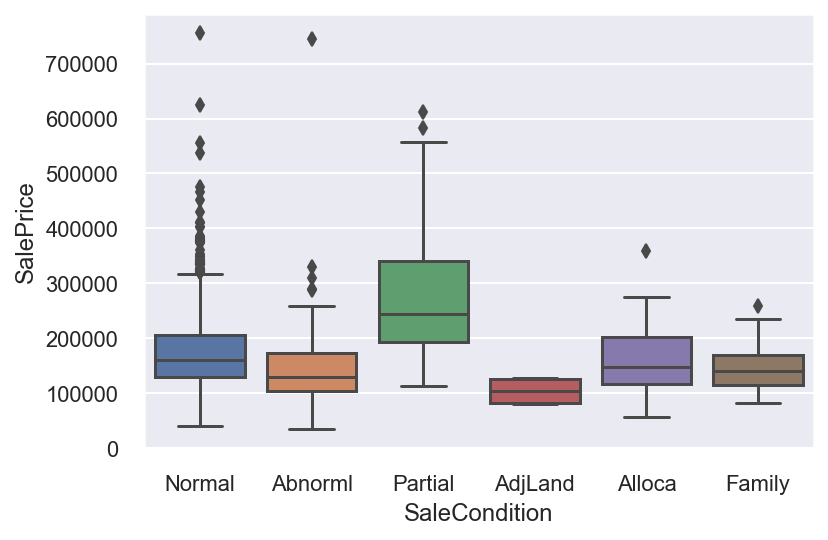

In [20]:
for i in categorial:
    sns.boxplot(x=train[i], y=y, data=train)
    plt.show();

In [21]:
# utilities variables can be thrown away, they contain only 1 value, which means they are useful for learning

In [22]:
# for some numeric variables that are actually categorical

In [23]:
categorial_2 = ['BedroomAbvGr', 
 'BsmtFullBath', 
 'BsmtHalfBath',
 'Fireplaces', 
 'FullBath',  
 'HalfBath', 
 'GarageCars', 
 'KitchenAbvGr', 
 'MoSold', 
 'OverallCond',
 'OverallQual', 
 'TotRmsAbvGrd',
 'YrSold'
]

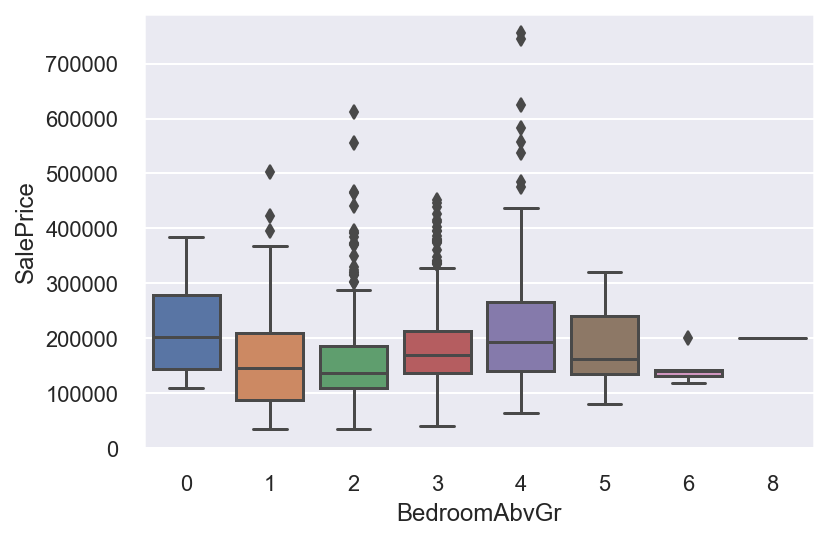

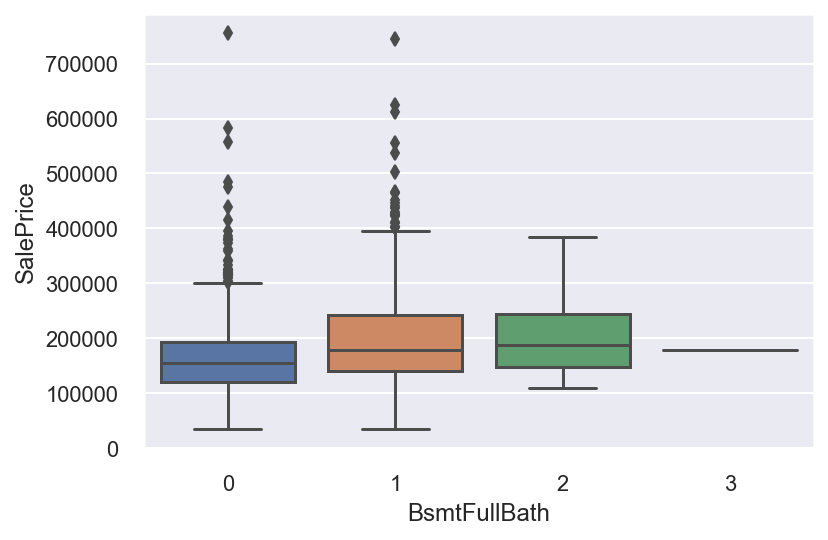

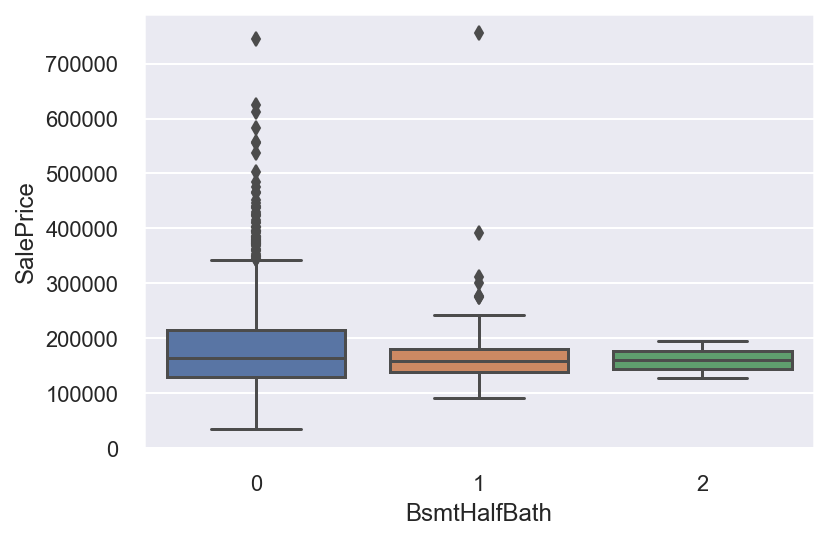

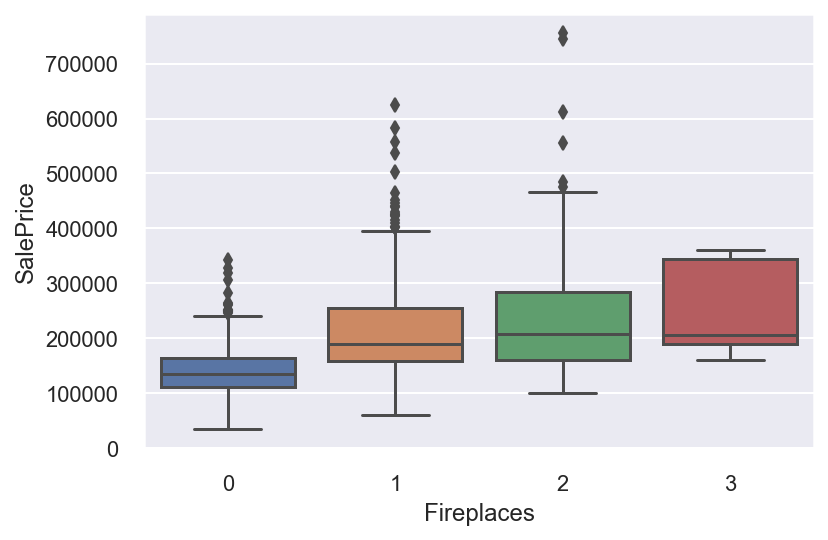

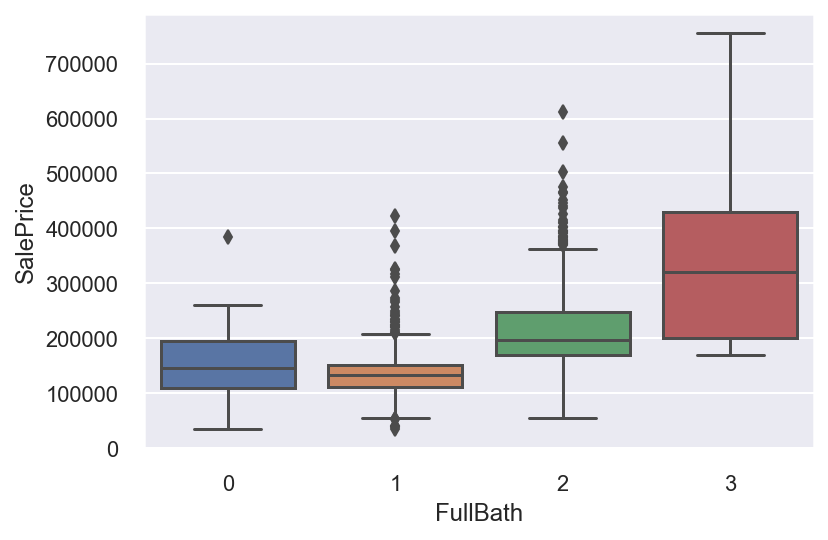

...

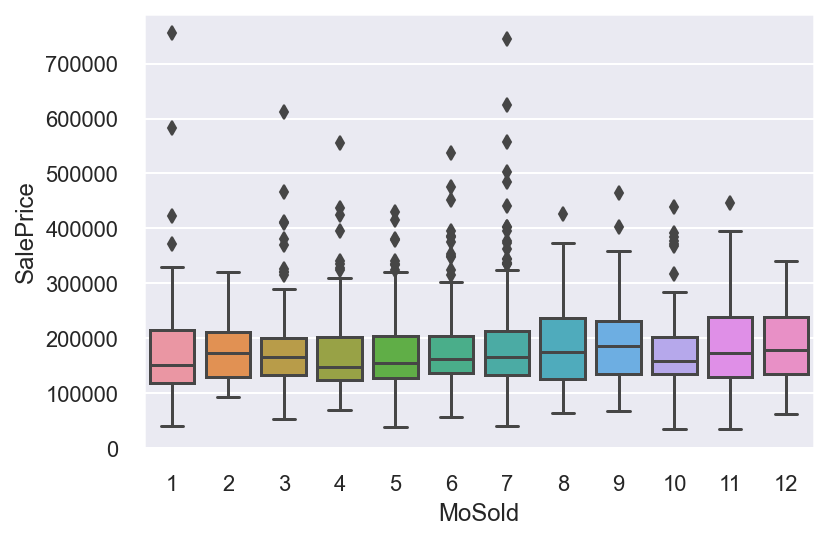

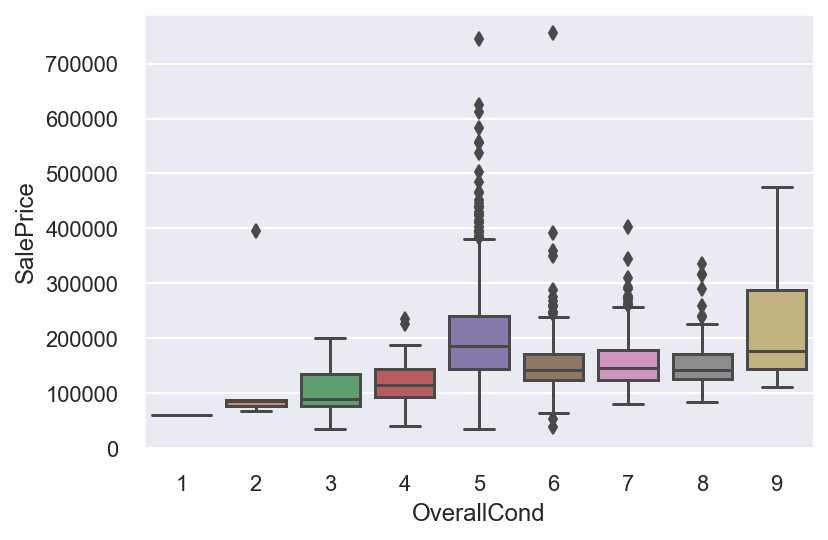

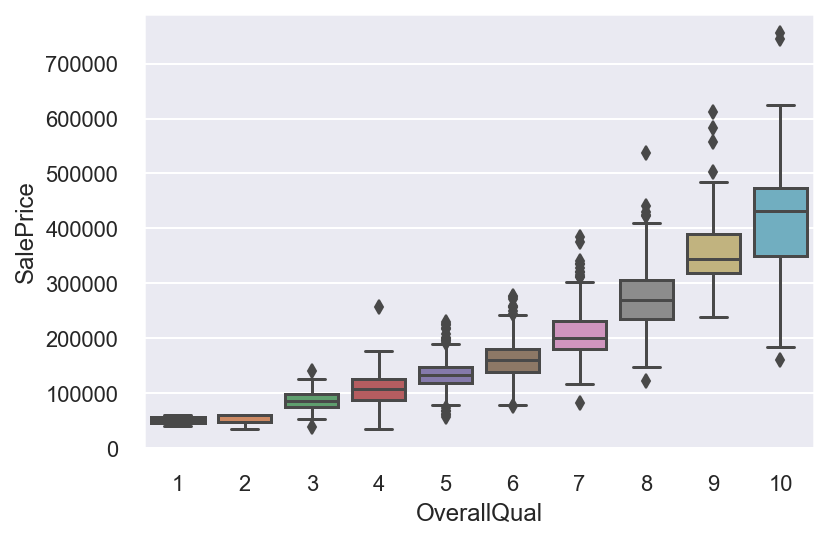

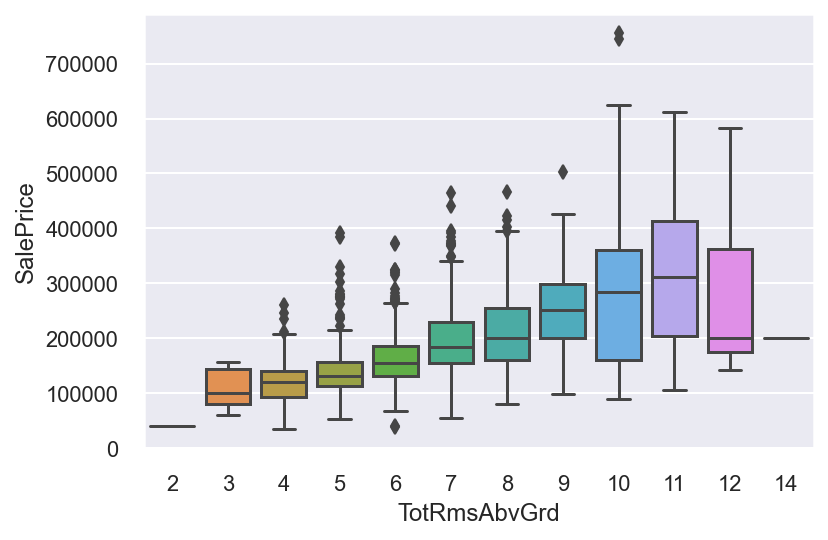

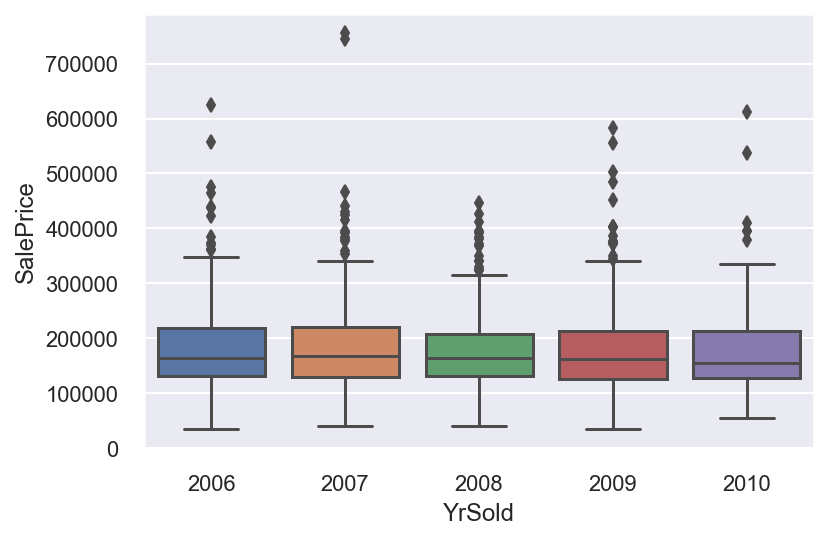

In [24]:
for i in categorial_2:
    sns.boxplot(x=train[i], y=y, data=train)
    plt.show();

In [25]:
# we can see a clear dependence of price on quality, the number of bathtubs and cars, totrmsADVGRD, fireplace

In [26]:
# for almost all quality variables, the price becomes higher depending on the assessment

In [27]:
# Let's deal with NA

In [28]:
percent_of_na = (train.isnull().sum()/len(train))

In [29]:
percent_of_na[percent_of_na>0].sort_values(ascending = False)

PoolQC          0.995205
MiscFeature     0.963014
Alley           0.937671
Fence           0.807534
FireplaceQu     0.472603
LotFrontage     0.177397
GarageYrBlt     0.055479
GarageType      0.055479
GarageFinish    0.055479
GarageQual      0.055479
GarageCond      0.055479
BsmtFinType2    0.026027
BsmtExposure    0.026027
BsmtFinType1    0.025342
BsmtCond        0.025342
BsmtQual        0.025342
MasVnrArea      0.005479
MasVnrType      0.005479
Electrical      0.000685
dtype: float64

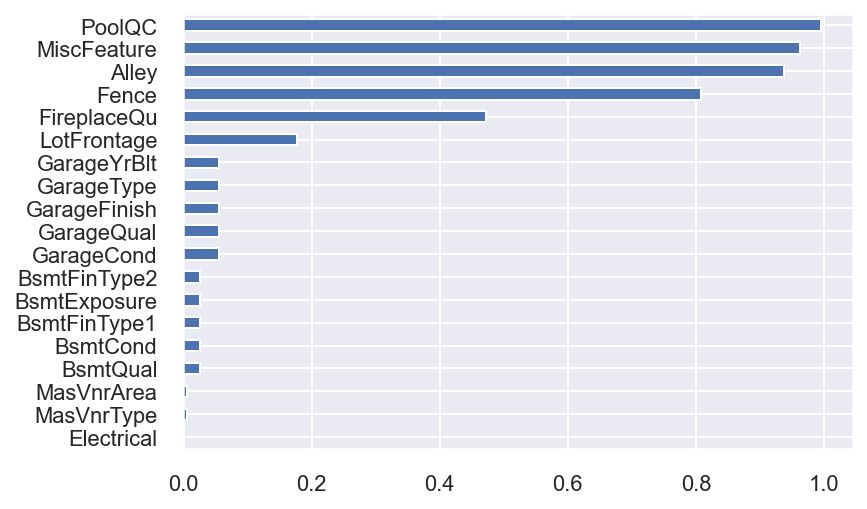

In [30]:
percent_of_na[percent_of_na>0].sort_values().plot(kind= 'barh');

In [31]:
# Garage's, Bsmt's, Mas's variables have the same percentage na

In [87]:
 # from data description stats 
train['PoolQC'] = train['PoolQC'].fillna("No_Pool")
train['MiscFeature']  = train['MiscFeature'].fillna('None')
train['Alley']  = train['Alley'].fillna('No_alley')
train['Fence']  = train['Fence'].fillna('No_Fence')
train['FireplaceQu'] = train['FireplaceQu'].fillna('No_Fireplace') 
train['GarageYrBlt'] = train['GarageYrBlt'].fillna(0.0)
train['GarageType']  = train['GarageType'].fillna('No_Garage')
train['GarageFinish'] = train['GarageFinish'].fillna('No_Garage')
train['GarageQual'] = train['GarageQual'].fillna('No_Garage')
train['GarageCond'] = train['GarageCond'].fillna('No_Garage')
train['BsmtFinType2'] = train['BsmtFinType2'].fillna('No_Basement')
train['BsmtExposure'] = train['BsmtExposure'].fillna('No_Basement')
train['BsmtFinType1'] = train['BsmtFinType1'].fillna('No_Basement')
train['BsmtCond'] = train['BsmtCond'].fillna('No_Basement') 
train['BsmtQual'] = train['BsmtQual'].fillna('No_Basement')
train['MasVnrArea']  = train['MasVnrArea'].fillna(0.0)
train['MasVnrType']  = train['MasVnrType'].fillna('None')


# LotFrontage missing data requires deeper analysis.
# Since LotFrontage is the distance of house's front yard, we can make an assumption that it depends on the neighborhood where the house is located. This way we can group LotFrontage values by the neighborhood feature and substitute missing values by the median Lotfrontage distance of the neighborhood. **
# From this kernel https://www.kaggle.com/fugacity/ridge-lasso-elasticnet-regressions-explained

train["LotFrontage"] = train.groupby("Neighborhood")["LotFrontage"].transform(lambda x: x.fillna(x.median()))

In [33]:
without_na = percent_of_na[percent_of_na>0].sort_values(ascending = False).index

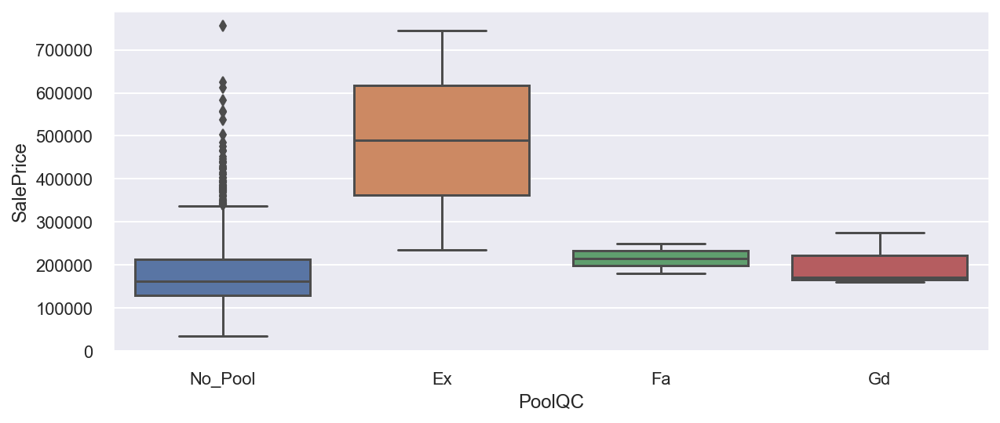

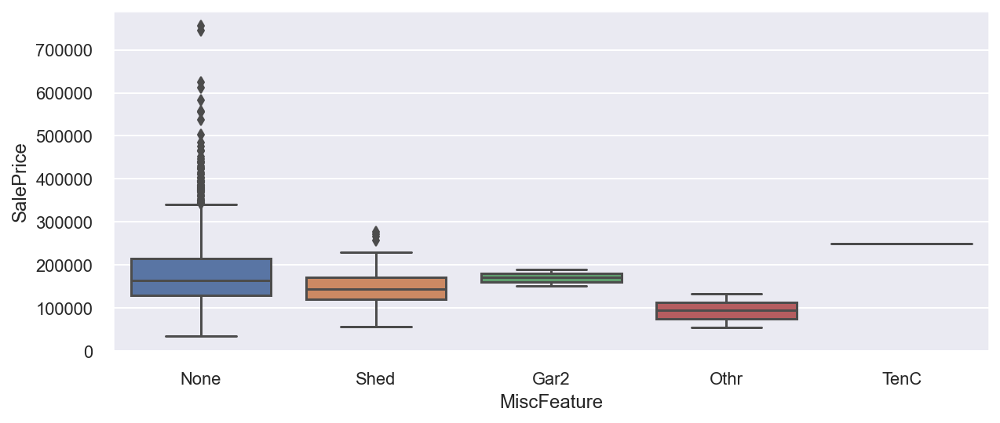

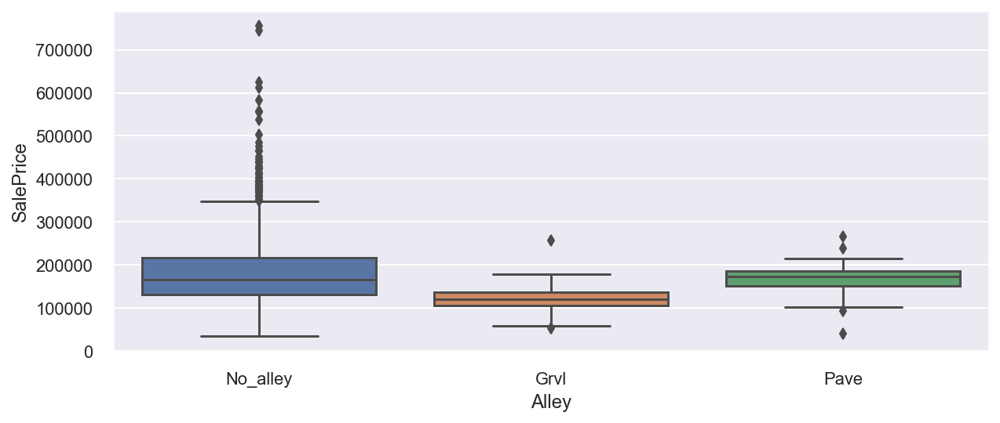

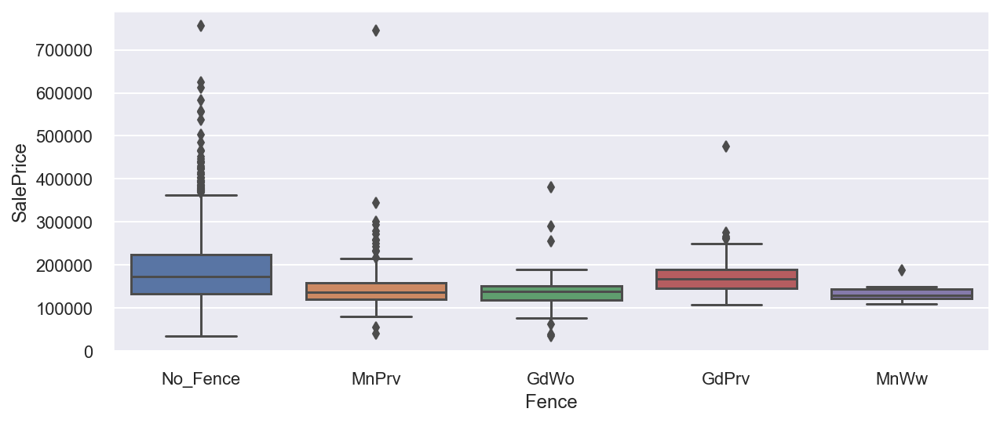

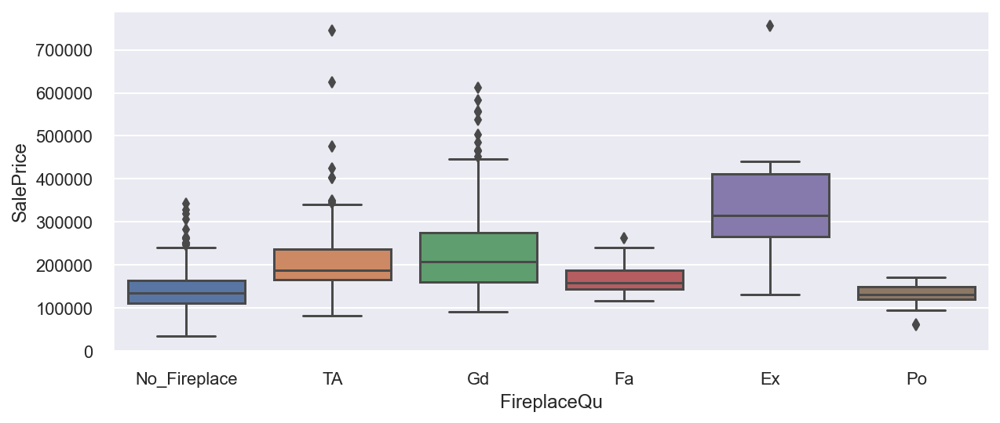

...

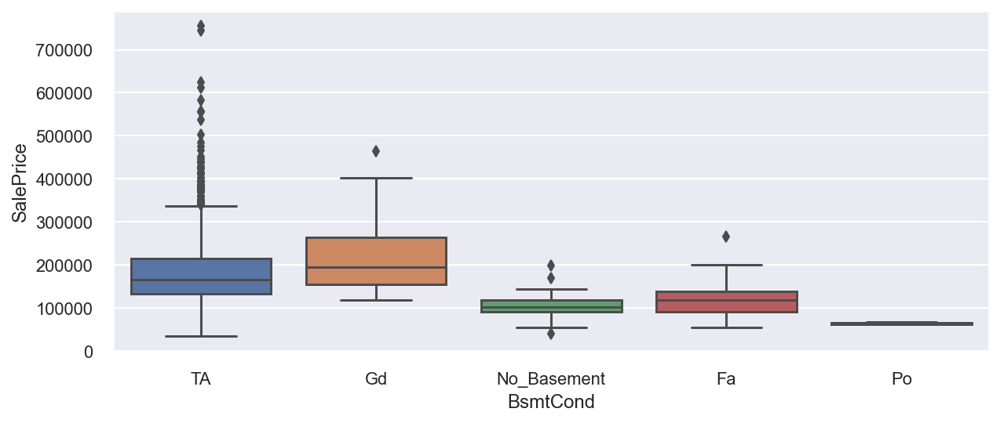

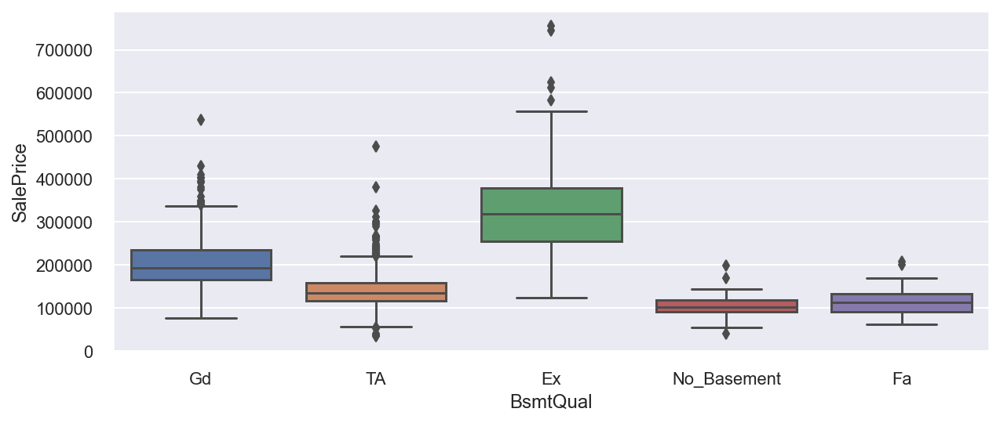

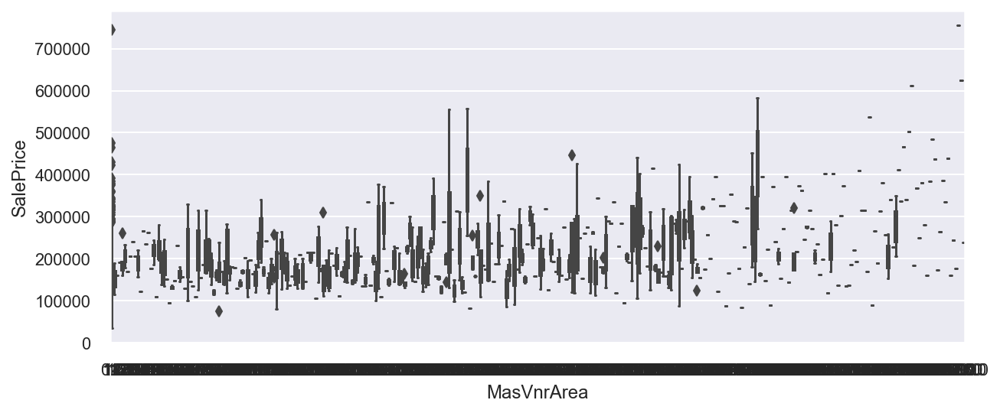

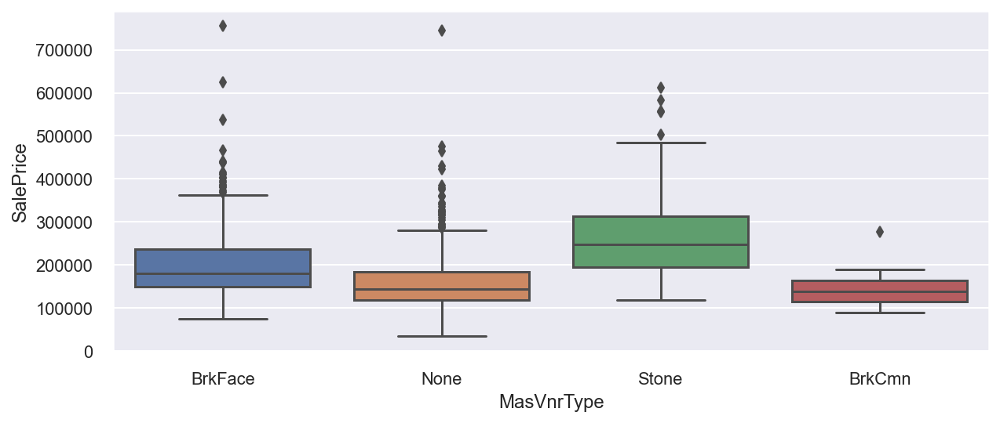

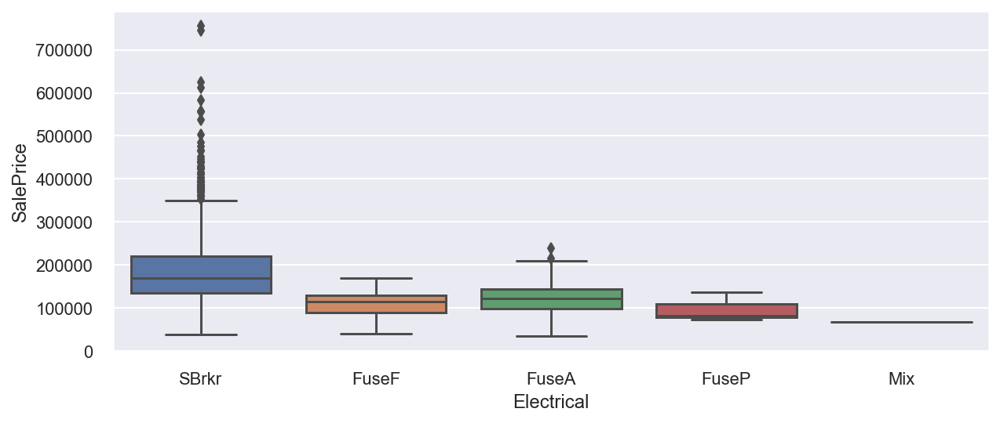

In [34]:
for i in without_na:
    plt.figure(figsize = (10, 4))
    sns.boxplot(x=train[i], y=y, data=train)
    plt.show();

In [35]:
# Тут вставлю pandas prifiling, посмотрим как он будет работать на гитхабе

# Regression diagnostics:  testing the assumptions of linear regression

Site: http://people.duke.edu/~rnau/testing.htm#linearity
There are four principal assumptions which justify the use of linear regression models for purposes of inference or prediction:

* linearity and additivity of the relationship between dependent and independent variables:

    (a) The expected value of dependent variable is a straight-line function of each independent variable, holding the others fixed.

    (b) The slope of that line does not depend on the values of the other variables.

    (c)  The effects of different independent variables on the expected value of the dependent variable are additive.

* statistical independence of the errors (in particular, no correlation between consecutive errors in the case of time series data)

* homoscedasticity (constant variance) of the errors

    (a) versus time (in the case of time series data)

    (b) versus the predictions

    (c) versus any independent variable

* normality of the error distribution.

If any of these assumptions is violated (i.e., if there are nonlinear relationships between dependent and independent variables or the errors exhibit correlation, heteroscedasticity, or non-normality), then the forecasts, confidence intervals, and scientific insights yielded by a regression model may be (at best) inefficient or (at worst) seriously biased or misleading.  

You will sometimes see additional (or different) assumptions listed, such as “the variables are measured accurately” or “the sample is representative of the population”, etc.  These are important considerations in any form of statistical modeling, and they should be given due attention, although they do not refer to properties of the linear regression equation per se. 

## Testing for linear and additivity of predictive relationships

### Violations of linearity or additivity 

**Violations of linearity or additivity** are extremely serious: if you fit a linear model to data which are nonlinearly or nonadditively related, your predictions are likely to be seriously in error, especially when you extrapolate beyond the range of the sample data.

**How to diagnose**: nonlinearity is usually most evident in a plot of observed versus predicted values or a plot of residuals versus predicted values, which are a part of standard regression output. The points should be symmetrically distributed around a diagonal line in the former plot or around horizontal line in the latter plot, with a roughly constant variance.  (The residual-versus-predicted-plot is better than the observed-versus-predicted plot for this purpose, because it eliminates the visual distraction of a sloping pattern.)  Look carefully for evidence of a "bowed" pattern, indicating that the model makes systematic errors whenever it is making unusually large or small predictions. In multiple regression models, nonlinearity or nonadditivity may also be revealed by systematic patterns in plots of the residuals versus individual independent variables.

**How to fix**: consider applying a nonlinear transformation to the dependent and/or independent variables if you can think of a transformation that seems appropriate. (Don’t just make something up!) For example, if the data are strictly positive, the **log transformation** is an option.  (The logarithm base does not matter--all log functions are same up to linear scaling--although the natural log is usually preferred because small changes in the natural log are equivalent to percentage changes. If a log transformation is applied to the dependent variable only, this is equivalent to assuming that it grows (or decays) exponentially as a function of the independent variables.  If a log transformation is applied to both the dependent variable and the independent variables, this is equivalent to assuming that the effects of the independent variables are multiplicative rather than additive in their original units. This means that, on the margin, a small percentage change in one of the independent variables induces a proportional percentage change in the expected value of the dependent variable, other things being equal.  Models of this kind are commonly used in modeling price-demand relationships. 

Another possibility to consider is adding another regressor that is a nonlinear function of one of the other variables. For example, if you have regressed Y on X, and the graph of residuals versus predicted values suggests a parabolic curve, then it may make sense to regress Y on both **X and X^2** (i.e., X-squared). The latter transformation is possible even when X and/or Y have negative values, whereas logging is not.  Higher-order terms of this kind (cubic, etc.) might also be considered in some cases.  But don’t get carried away!  This sort of "polynomial curve fitting" can be a nice way to draw a smooth curve through a wavy pattern of points (in fact, it is a trend-line option on scatterplots on Excel), but it is usually a terrible way to extrapolate outside the range of the sample data. 

Finally, it may be that you have overlooked some entirely different independent variable that explains or corrects for the nonlinear pattern or interactions among variables that you are seeing in your residual plots. In that case the shape of the pattern, together with economic or physical reasoning, may suggest some likely suspects.  For example, if the strength of the linear relationship between Y and X1 depends on the level of some other variable X2, this could perhaps be addressed by creating a new independent variable that is the product of X1 and X2.  In the case of time series data, if the trend in Y is believed to have changed at a particular point in time, then the addition of a piecewise linear trend variable (one whose string of values looks like 0, 0, …, 0, 1, 2, 3, … ) could be used to fit the kink in the data.  Such a variable can be considered as the product of a trend variable and a dummy variable.  Again, though, you need to beware of overfitting the sample data by throwing in artificially constructed variables that are poorly motivated. 

In [36]:
def for_corr(X, y):
    correl = X.corr(y)
    sns.regplot(x=X, y=y).set_title('Correlation between ' + str(X.name) + ' SalePrice - ' + str(round(correl, 3)));

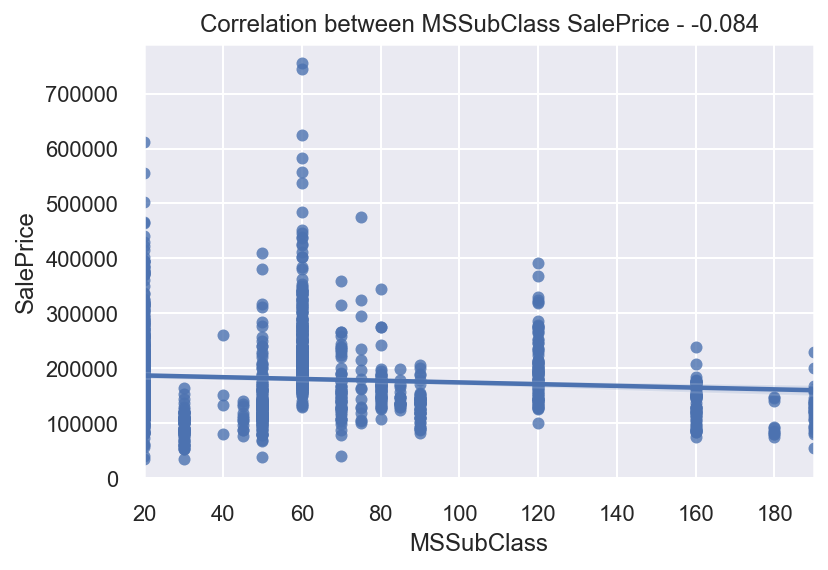

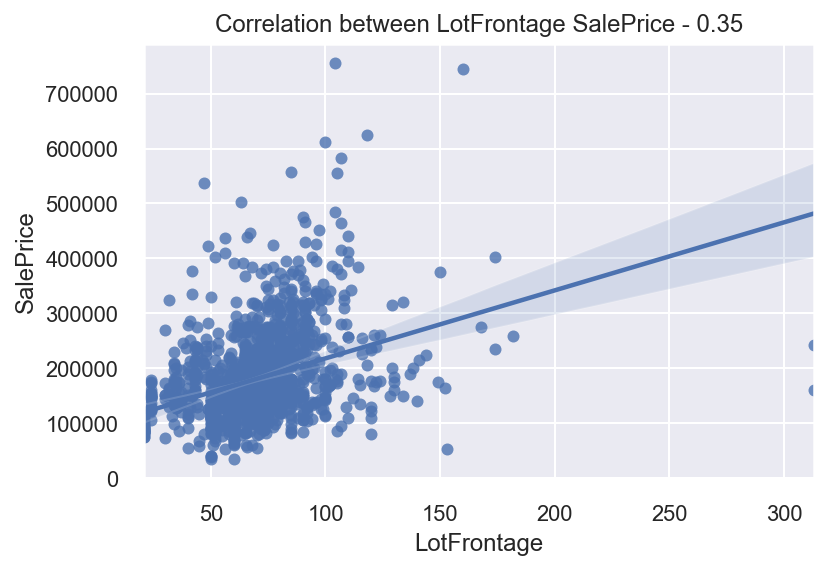

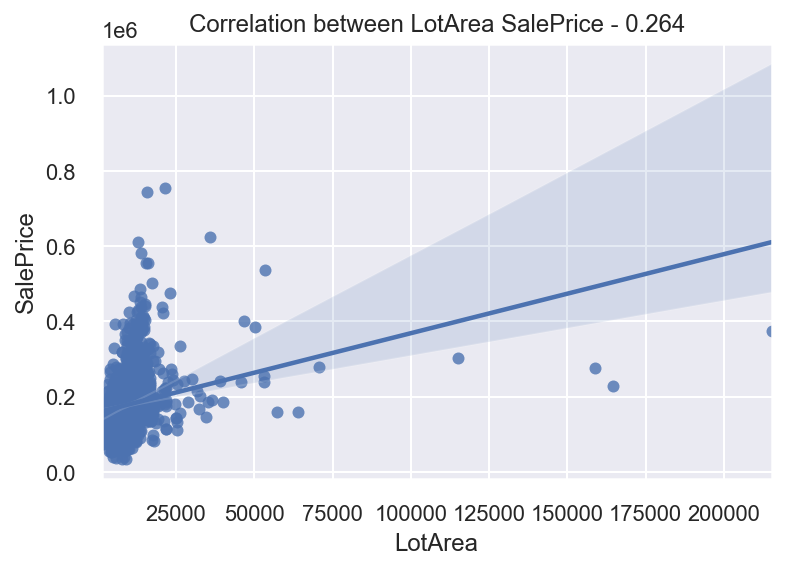

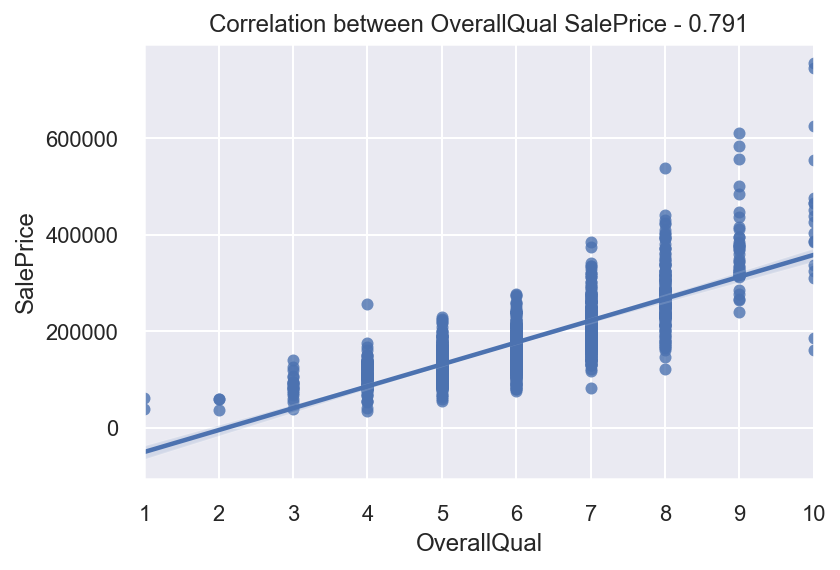

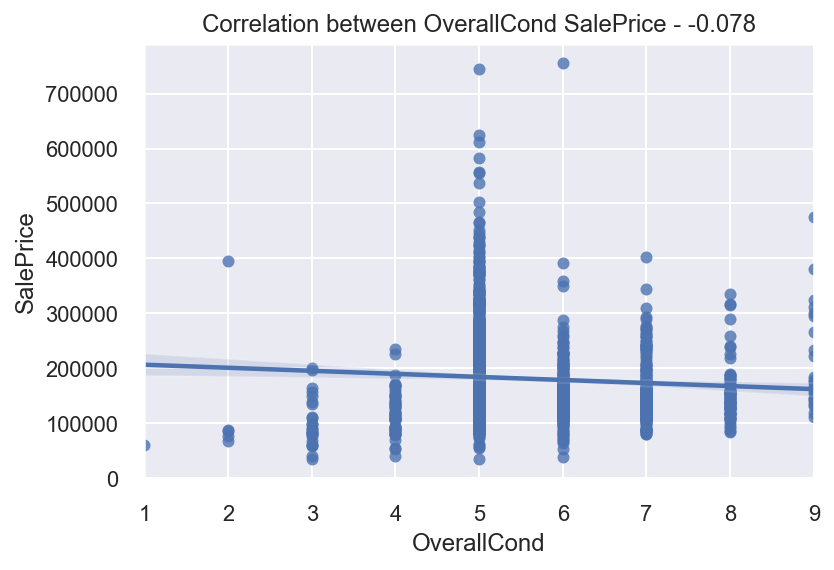

In [37]:
# example 
plt.rcParams.update({'figure.max_open_warning': 0})
for i in numerical[0:5]:
    for_corr(train[i], y)
    plt.show();

### Violations of independence

**Violations of independence** are potentially very serious in time series regression models: serial correlation in the errors (i.e., correlation between consecutive errors or errors separated by some other number of periods) means that there is room for improvement in the model, and extreme serial correlation is often a symptom of a badly mis-specified model. Serial correlation (also known as autocorrelation”) is sometimes a byproduct of a violation of the linearity assumption, as in the case of a simple (i.e., straight) trend line fitted to data which are growing exponentially over time. 

Independence can also be violated in non-time-series models if errors tend to always have the same sign under particular conditions, i.e., if the model systematically underpredicts or overpredicts what will happen when the independent variables have a particular configuration. 

**How to diagnose**: The best test for serial correlation is to look at a residual time series plot (residuals vs. row number) and a table or plot of residual autocorrelations. (If your software does not provide these by default for time series data, you should figure out where in the menu or code to find them.) Ideally, most of the residual autocorrelations should fall within the 95% confidence bands around zero, which are located at roughly plus-or-minus 2-over-the-square-root-of-n, where n is the sample size. Thus, if the sample size is 50, the autocorrelations should be between +/- 0.3. If the sample size is 100, they should be between +/- 0.2. Pay especially close attention to significant correlations at the first couple of lags and in the vicinity of the seasonal period, because these are probably not due to mere chance and are also fixable. The Durbin-Watson statistic provides a test for significant residual autocorrelation at lag 1: the DW stat is approximately equal to 2(1-a) where a is the lag-1 residual autocorrelation, so ideally it should be close to 2.0--say, between 1.4 and 2.6 for a sample size of 50.

**How to fix**: Minor cases of positive serial correlation (say, lag-1 residual autocorrelation in the range 0.2 to 0.4, or a Durbin-Watson statistic between 1.2 and 1.6) indicate that there is some room for fine-tuning in the model. Consider adding lags of the dependent variable and/or lags of some of the independent variables. Or, if you have an ARIMA+regressor procedure available in your statistical software, try adding an AR(1) or MA(1) term to the regression model.  An AR(1) term adds a lag of the dependent variable to the forecasting equation, whereas an MA(1) term adds a lag of the forecast error. If there is significant correlation at lag 2, then a 2nd-order lag may be appropriate.

If there is significant negative correlation in the residuals (lag-1 autocorrelation more negative than -0.3 or DW stat greater than 2.6), watch out for the possibility that you may have overdifferenced some of your variables. Differencing tends to drive autocorrelations in the negative direction, and too much differencing may lead to artificial patterns of negative correlation that lagged variables cannot correct for.

If there is significant correlation at the seasonal period (e.g. at lag 4 for quarterly data or lag 12 for monthly data), this indicates that seasonality has not been properly accounted for in the model. Seasonality can be handled in a regression model in one of the following ways: (i) seasonally adjust the variables (if they are not already seasonally adjusted), or (ii) use seasonal lags and/or seasonally differenced variables (caution: be careful not to overdifference!), or (iii) add seasonal dummy variables to the model (i.e., indicator variables for different seasons of the year, such as MONTH=1 or QUARTER=2, etc.) The dummy-variable approach enables additive seasonal adjustment to be performed as part of the regression model: a different additive constant can be estimated for each season of the year. If the dependent variable has been logged, the seasonal adjustment is multiplicative. (Something else to watch out for: it is possible that although your dependent variable is already seasonally adjusted, some of your independent variables may not be, causing their seasonal patterns to leak into the forecasts.)

Major cases of serial correlation (a Durbin-Watson statistic well below 1.0, autocorrelations well above 0.5) usually indicate a fundamental structural problem in the model. You may wish to reconsider the transformations (if any) that have been applied to the dependent and independent variables. It may help to stationarize all variables through appropriate combinations of differencing, logging, and/or deflating.

To test for non-time-series violations of independence, you can look at plots of the residuals versus independent variables or plots of residuals versus row number in situations where the rows have been sorted or grouped in some way that depends (only) on the values of the independent variables.  The residuals should be randomly and symmetrically distributed around zero under all conditions, and in particular there should be no correlation between consecutive errors no matter how the rows are sorted, as long as it is on some criterion that does not involve the dependent variable.  If this is not true, it could be due to a violation of the linearity assumption or due to bias that is explainable by omitted variables (say, interaction terms or dummies for identifiable conditions).

In [38]:
# we dont have time-series data, function  for autocorr plot
# from statsmodels.graphics.tsaplots import plot_acf
# plot_acf(series)

In [39]:
def residuals_autocorr(X_train,y_train, model):
    model.fit(X_train, y_train)
    score = model.score(X_train, y_train)
    y_pred = model.predict(X_train)
    f = plt.figure(figsize = (15, 5))
    preds =pd.DataFrame({"preds":y_pred, "true":y_train})
    preds["residuals"] = preds["true"] - preds["preds"]
    preds.residuals.plot(title = X_train.iloc[:,0].name )
    plt.xlabel('row_number')
    plt.ylabel('residuals')
    

In [109]:
reg = LinearRegression()

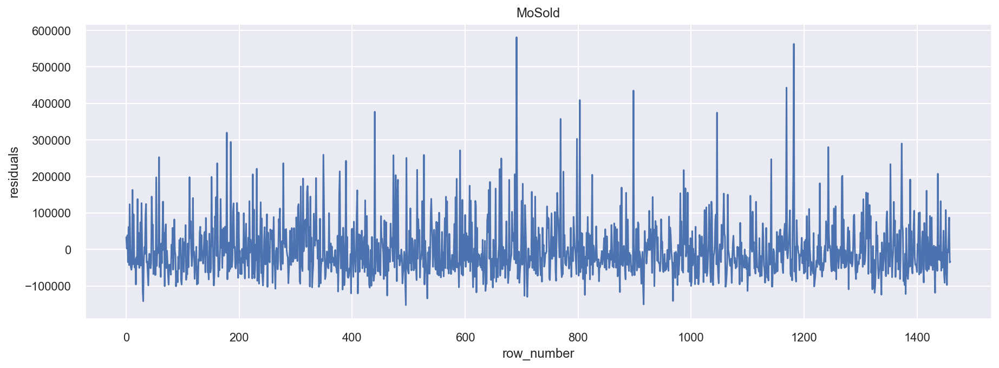

In [41]:
residuals_autocorr(train[['MoSold']],y, reg)

### Violations of homoscedasticity 

Violations of homoscedasticity (which are called "heteroscedasticity") make it difficult to gauge the true standard deviation of the forecast errors, usually resulting in confidence intervals that are too wide or too narrow. In particular, if the variance of the errors is increasing over time, confidence intervals for out-of-sample predictions will tend to be unrealistically narrow. Heteroscedasticity may also have the effect of giving too much weight to a small subset of the data (namely the subset where the error variance was largest) when estimating coefficients.

**How to diagnose**: look at a plot of residuals versus predicted values and, in the case of time series data, a plot of residuals versus time.  Be alert for evidence of residuals that grow larger either as a function of time or as a function of the predicted value. To be really thorough, you should also generate plots of residuals versus independent variables to look for consistency there as well.  Because of imprecision in the coefficient estimates, the errors may tend to be slightly larger for forecasts associated with predictions or values of independent variables that are extreme in both directions, although the effect should not be too dramatic.  What you hope not to see are errors that systematically get larger in one direction by a significant amount.

**How to fix**:  If the dependent variable is strictly positive and if the residual-versus-predicted plot shows that the size of the errors is proportional to the size of the predictions (i.e., if the errors seem consistent in percentage rather than absolute terms), a log transformation applied to the dependent variable may be appropriate.  I

Seasonal patterns in the data are a common source of heteroscedasticity in the errors:  unexplained variations in the dependent variable throughout the course of a season may be consistent in percentage rather than absolute terms, in which case larger errors will be made in seasons where activity is greater, which will show up as a seasonal pattern of changing variance on the residual-vs-time plot.  A log transformation is often used to address this problem.  For example, if the seasonal pattern is being modeled through the use of dummy variables for months or quarters of the year, a log transformation applied to the dependent variable will convert the coefficients of the dummy variables to multiplicative adjustment factors rather than additive adjustment factors, and the errors in predicting the logged variable will be (roughly) interpretable as percentage errors in predicting the original variable.  Seasonal adjustment of all the data prior to fitting the regression model might be another option. 


In [42]:
def corr_and_residuals(X, y):
    fig, (ax1, ax2) = plt.subplots(figsize = (15,5), ncols=2,sharey=False)
    correl = X.corr(y)
    sns.regplot(x=X, y=y, ax = ax1).set_title('Correlation between ' + str(X.name) + ' SalePrice - ' + str(round(correl, 3)));
    sns.residplot(X, y, ax = ax2);

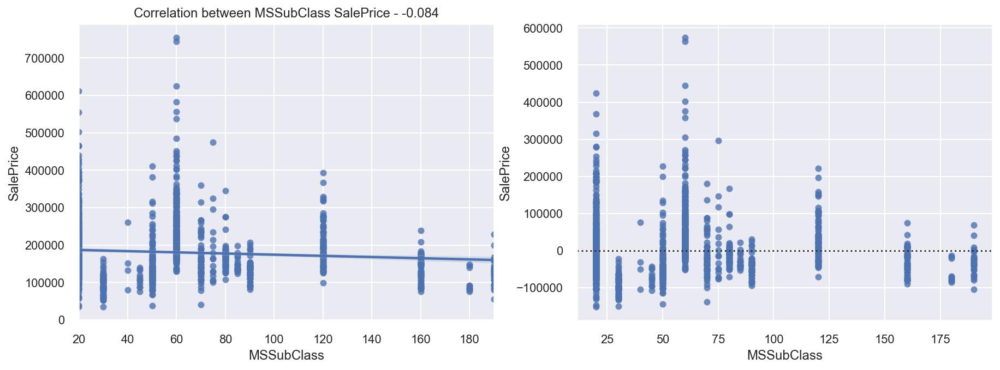

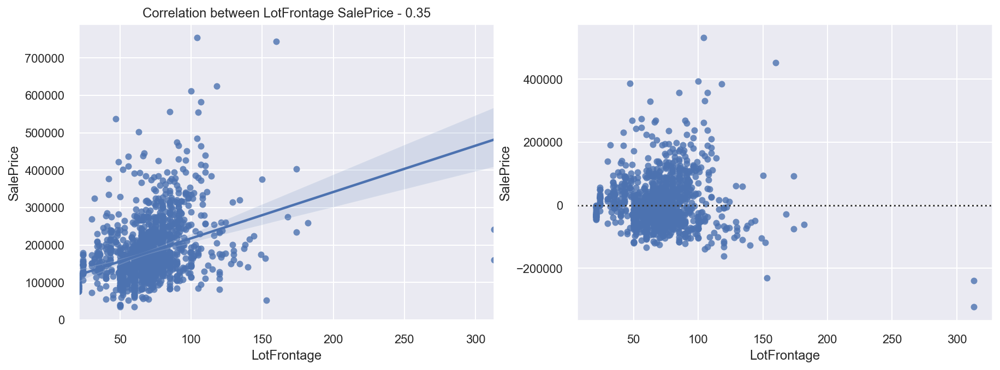

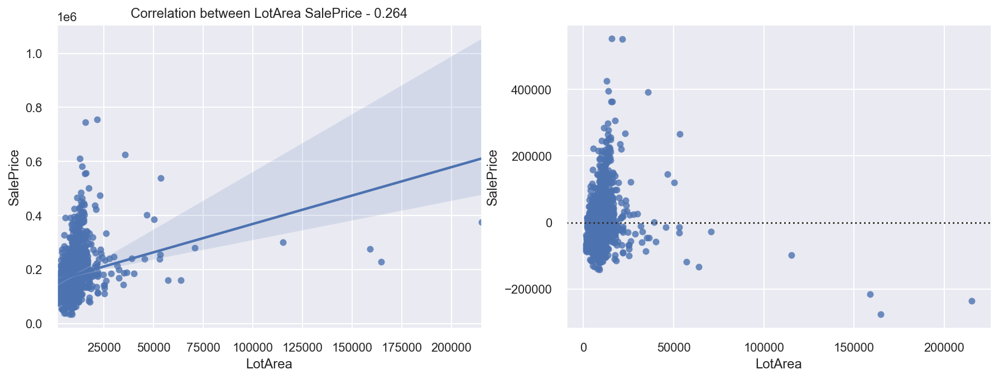

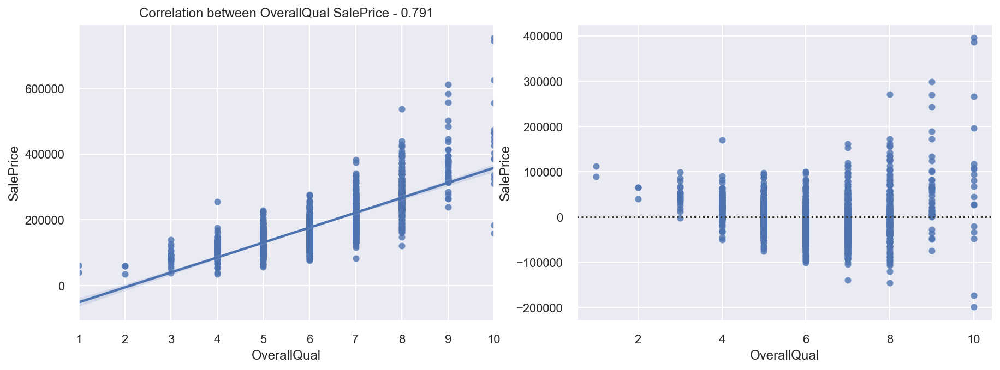

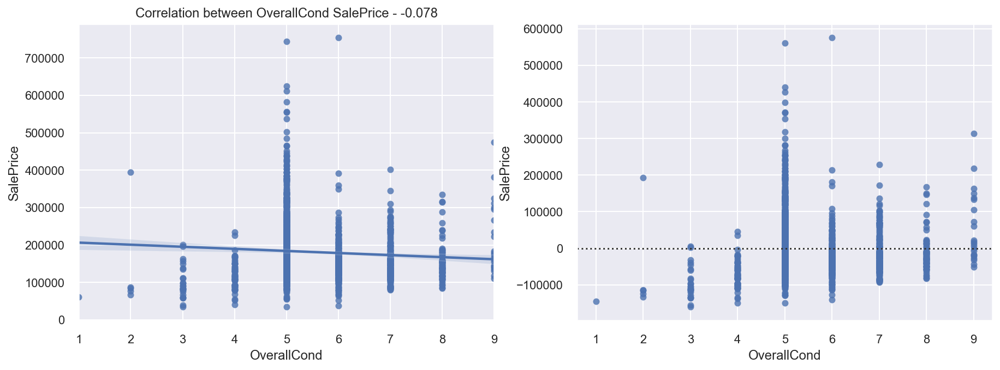

In [43]:
# exemple 
plt.rcParams.update({'figure.max_open_warning': 0})
for i in numerical[0:5]:
    corr_and_residuals(train[i], y)
    plt.show();

### Violations of normality

Violations of normality create problems for determining whether model coefficients are significantly different from zero and for calculating confidence intervals for forecasts. Sometimes the error distribution is "skewed" by the presence of a few large outliers. Since parameter estimation is based on the minimization of squared error, a few extreme observations can exert a disproportionate influence on parameter estimates. Calculation of confidence intervals and various significance tests for coefficients are all based on the assumptions of normally distributed errors. If the error distribution is significantly non-normal, confidence intervals may be too wide or too narrow.

Technically, the normal distribution assumption is not necessary if you are willing to assume the model equation is correct and your only goal is to estimate its coefficients and generate predictions in such a way as to minimize mean squared error.  The formulas for estimating coefficients require no more than that, and some references on regression analysis do not list normally distributed errors among the key assumptions.  But generally we are interested in making inferences about the model and/or estimating the probability that a given forecast error will exceed some threshold in a particular direction, in which case distributional assumptions are important.  Also, a significant violation of the normal distribution assumption is often a "red flag" indicating that there is some other problem with the model assumptions and/or that there are a few unusual data points that should be studied closely and/or that a better model is still waiting out there somewhere.

**How to diagnose**: the best test for normally distributed errors is a normal probability plot or normal quantile plot of the residuals. These are plots of the fractiles of error distribution versus the fractiles of a normal distribution having the same mean and variance. If the distribution is normal, the points on such a plot should fall close to the diagonal reference line. A bow-shaped pattern of deviations from the diagonal indicates that the residuals have excessive skewness (i.e., they are not symmetrically distributed, with too many large errors in one direction). An S-shaped pattern of deviations indicates that the residuals have excessive kurtosis--i.e., there are either too many or two few large errors in both directions.  Sometimes the problem is revealed to be that there are a few data points on one or both ends that deviate significantly from the reference line ("outliers"), in which case they should get close attention. 

There are also a variety of statistical tests for normality, including the Kolmogorov-Smirnov test, the Shapiro-Wilk test, the Jarque-Bera test, and the Anderson-Darling test.  The Anderson-Darling test (which is the one used by RegressIt) is generally considered to be the best, because it is specific to the normal distribution (unlike the K-S test) and it looks at the whole distribution rather than just the skewness and kurtosis (like the J-B test).  But all of these tests are excessively "picky" in this author’s opinion.  Real data rarely has errors that are perfectly normally distributed, and it may not be possible to fit your data with a model whose errors do not violate the normality assumption at the 0.05 level of significance.  It is usually better to focus more on violations of the other assumptions and/or the influence of a few outliers (which may be mainly responsible for violations of normality anyway) and to look at a normal probability plot or normal quantile plot and draw your own conclusions about whether the problem is serious and whether it is systematic.



**How to fix**: violations of normality often arise either because (a) the distributions of the dependent and/or independent variables are themselves significantly non-normal, and/or (b) the linearity assumption is violated. In such cases, a nonlinear transformation of variables might cure both problems. In the case of the two normal quantile plots above, the second model was obtained applying a natural log transformation to the variables in the first one. 

The dependent and independent variables in a regression model do not need to be normally distributed by themselves--only the prediction errors need to be normally distributed.  (In fact, independent variables do not even need to be random, as in the case of trend or dummy or treatment or pricing variables.)  But if the distributions of some of the variables that are random are extremely asymmetric or long-tailed, it may be hard to fit them into a linear model whose errors will be normally distributed, and explaining the shape of their distributions may be an interesting topic all by itself.  Keep in mind that the normal error assumption is usually justified by appeal to the central limit theorem, which holds in the case where many random variations are added together.  If the underlying sources of randomness are not interacting additively, this argument fails to hold.

Another possibility is that there are two or more subsets of the data having different statistical properties, in which case separate models should be built, or else some data should merely be excluded, provided that there is some a priori criterion that can be applied to make this determination.

In some cases, the problem with the error distribution is mainly due to one or two very large errors. Such values should be scrutinized closely: are they genuine (i.e., not the result of data entry errors), are they explainable, are similar events likely to occur again in the future, and how influential are they in your model-fitting results? If they are merely errors or if they can be explained as unique events not likely to be repeated, then you may have cause to remove them. In some cases, however, it may be that the extreme values in the data provide the most useful information about values of some of the coefficients and/or provide the most realistic guide to the magnitudes of forecast errors

In [44]:
# So let's look at the data in terms of assumptions

In [107]:
# function that shows the distribution of residuals and model coefficients

def results_one_variable(X_train,y_train, model):
    model.fit(X_train, y_train)
    score = model.score(X_train, y_train)
    y_pred = model.predict(X_train)
    print ('R2 - '+ str(score))
    kstest = round(stats.kstest(y_train - y_pred, 'norm').pvalue, 6) 
    if kstest >0.05:
        print( 'Distribution of residuals is normal with p-value ' + str(kstest))
    else:
        print( 'Distribution of residuals is NOT normal with p-value '  + str(kstest))
    preds =pd.DataFrame({"preds":y_pred, "true":y_train})
    preds["residuals"] = preds["true"] - preds["preds"]
    f, axes = plt.subplots(2, 2, figsize = (15,15))
    if X_train.shape[1] == 1:
        correl = X_train.iloc[:,0].corr(y)
        sns.regplot(x=X_train, y=y_train, ax = axes[0, 0]).set_title('Correlation between ' + str(X_train.iloc[:,0].name) + ' SalePrice - ' + str(round(correl, 3)));
        sns.residplot(X_train,y_train, ax = axes[0, 1]).set_title('Residuals scatterplot');
    else:
        sns.scatterplot(preds["preds"],  preds["residuals"], ax = axes[0, 1]).set_title('Residuals scatterplot');
    stats.probplot(preds.residuals, plot= axes[1, 0]);
    sns.distplot(preds["residuals"], ax = axes[1, 1]).set_title('Residuals distribution');
    
#     if X_train.shape[1] == 1:
#         for_corr(X_train, y_train)
#     else:
#         coef = pd.Series(model.coef_, index = X_train.columns)
#         imp_coef = pd.concat([coef.sort_values().head(10),
#                      coef.sort_values().tail(10)])
#         imp_coef.plot(kind = "barh")
#         plt.title("TOP Coefficients in the Model");

In [46]:
# s = np.random.normal(size = 1000)
# stats.anderson(s, 'norm')

In [47]:
reg  = LinearRegression()

In [48]:
# Build regression and residual plots for all numerical variables

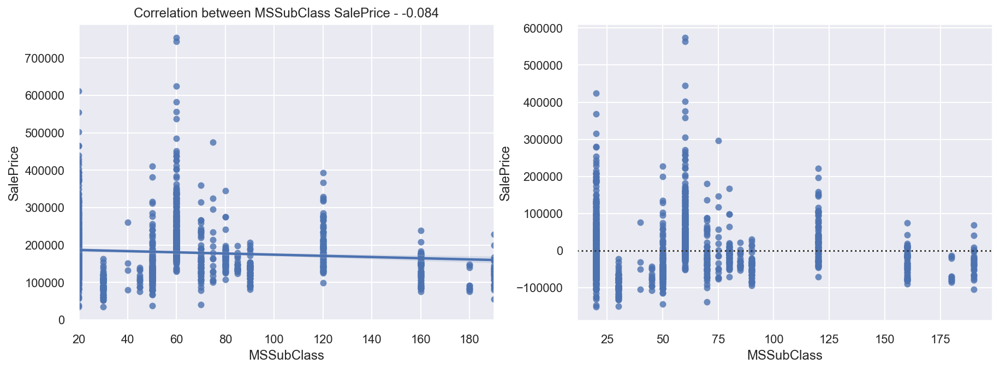

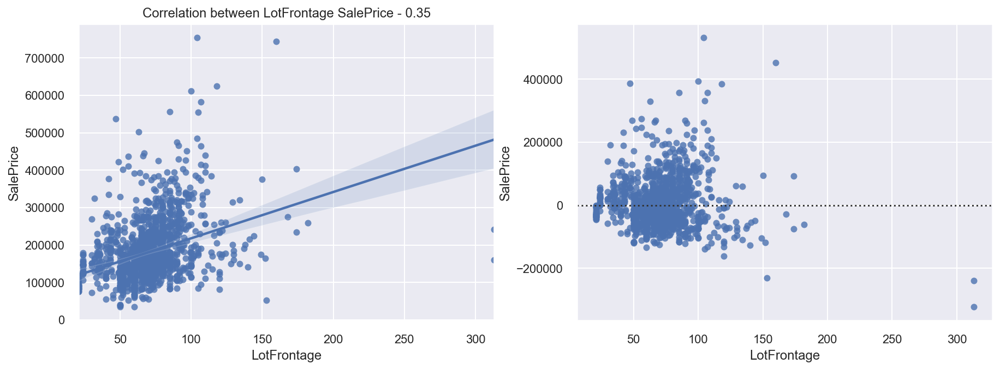

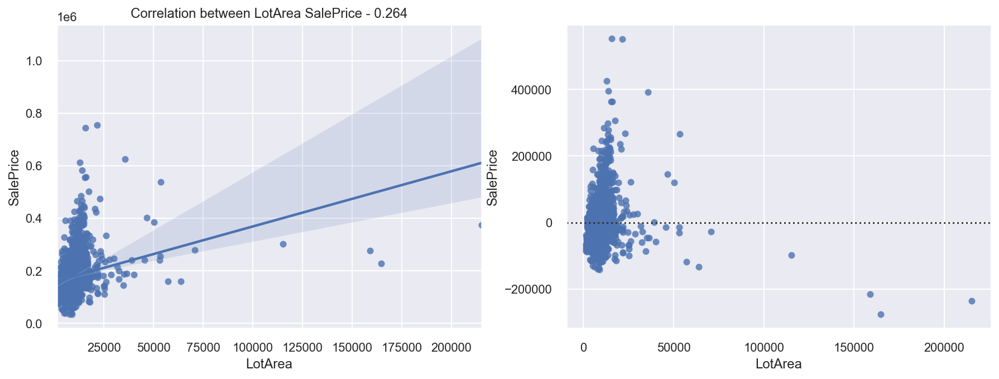

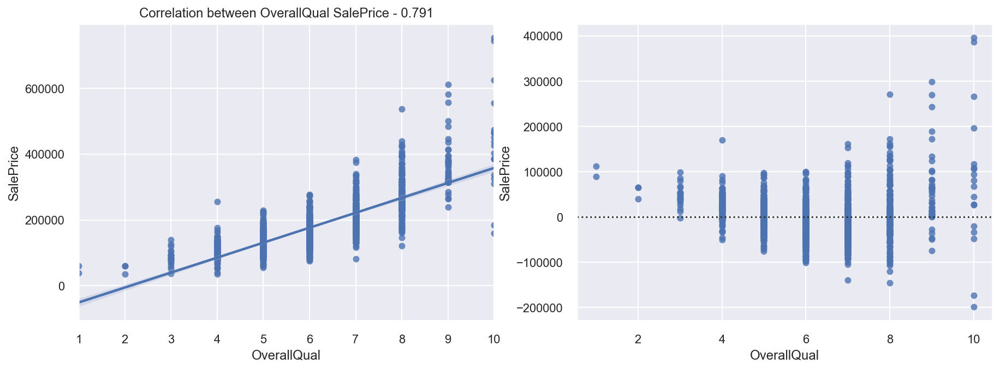

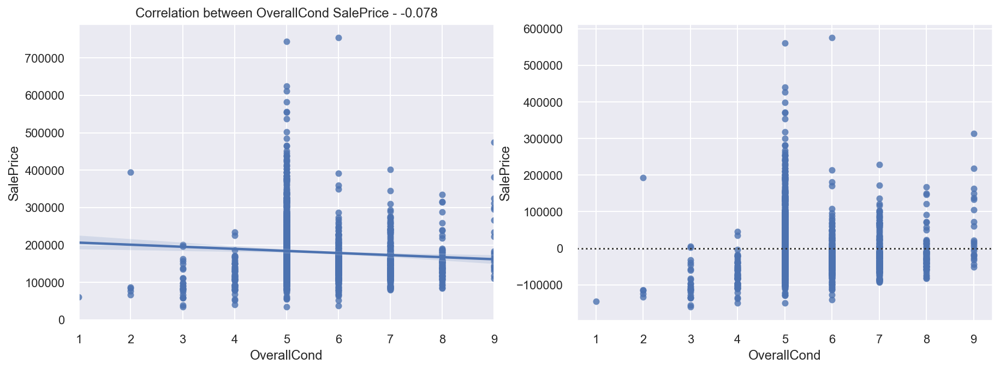

...

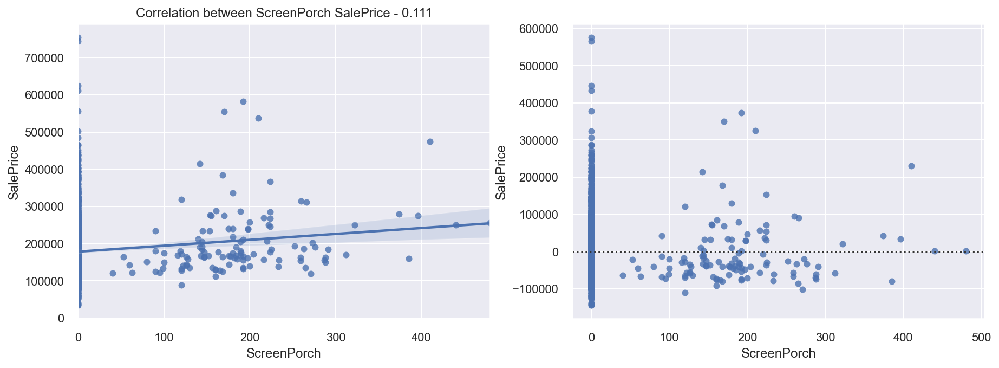

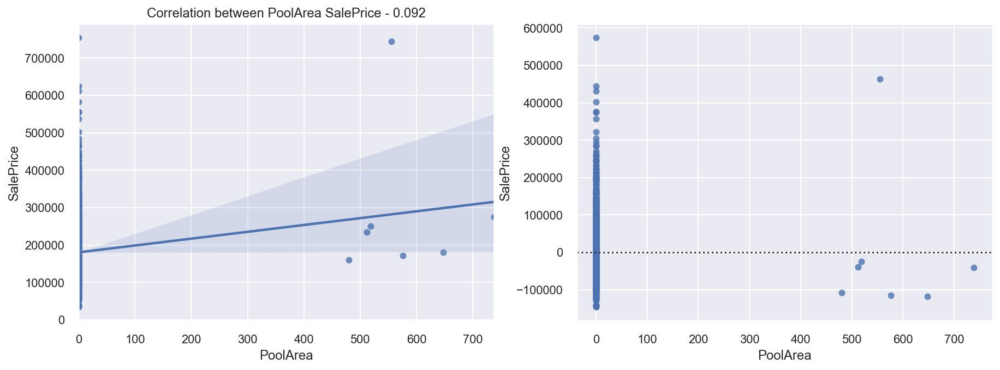

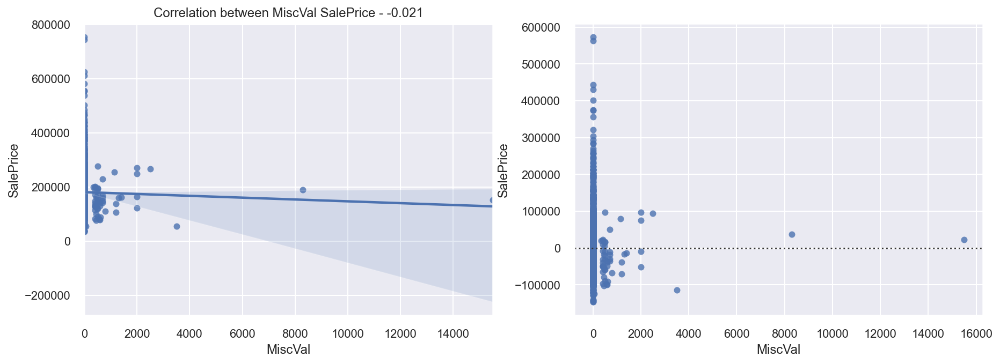

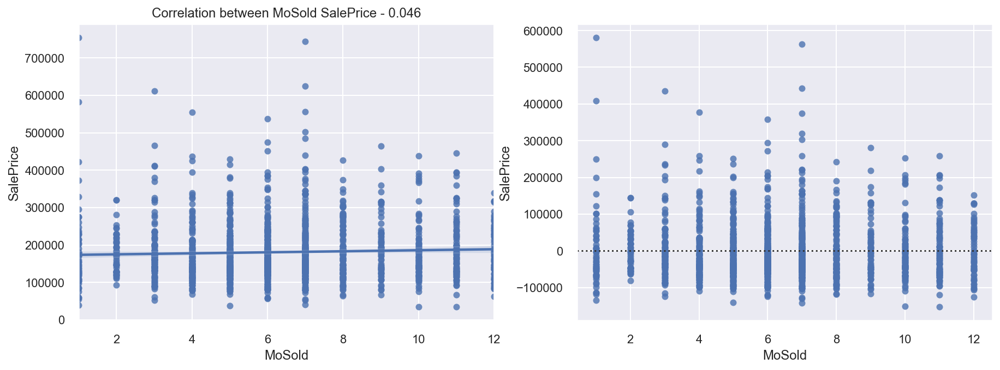

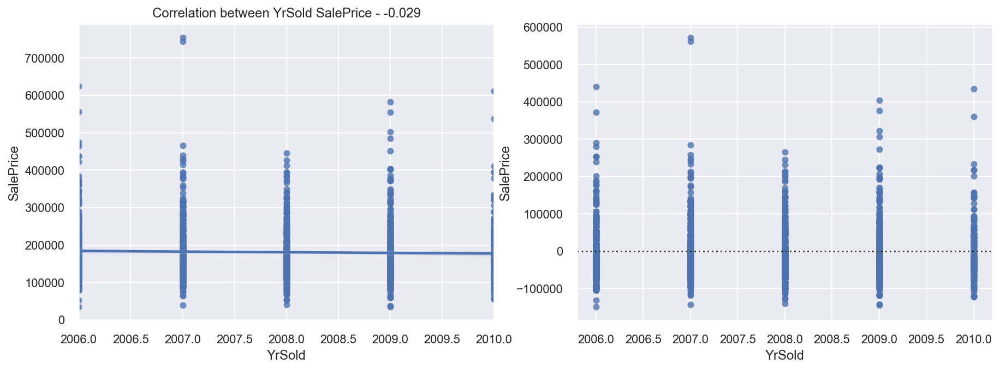

In [49]:
plt.rcParams.update({'figure.max_open_warning': 0})
for i in numerical:
    corr_and_residuals(train[i], y)

it’s really need to apply a logarithmic transformation to some of the variables

R2 - 0.12241294269850132
Distribution of residuals is NOT normal with p-value 0.0


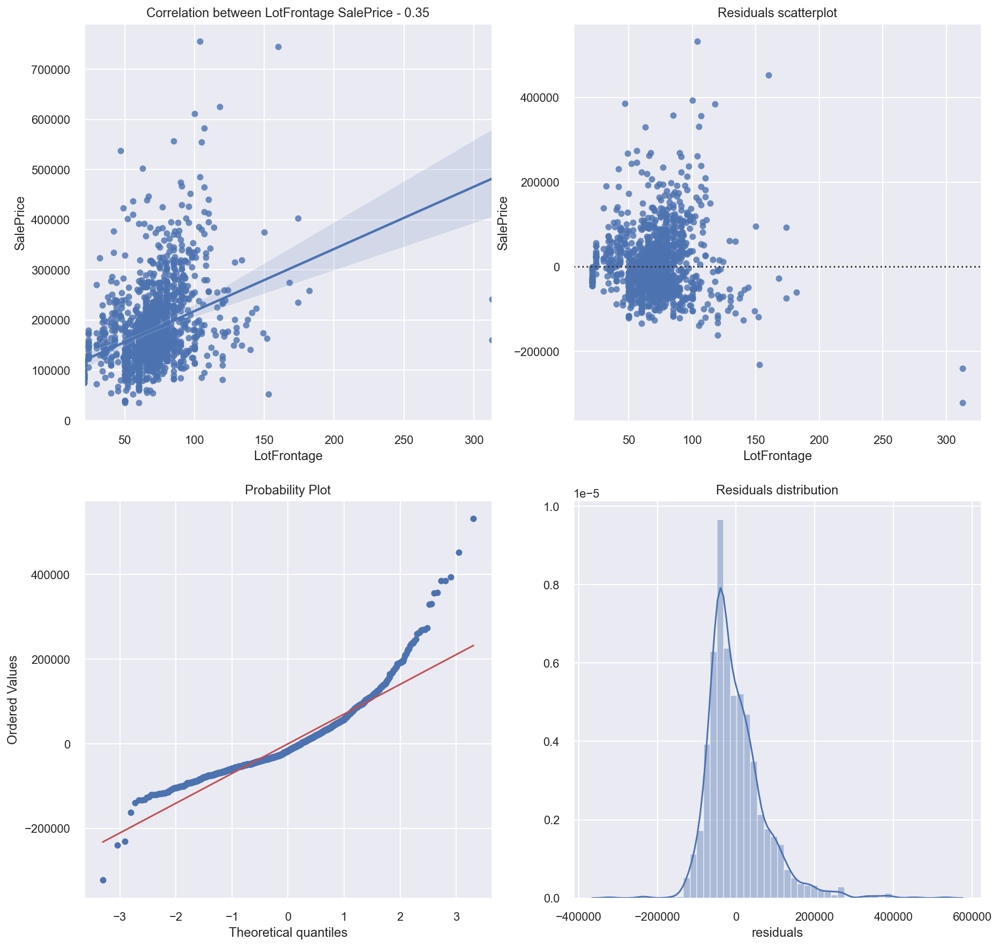

In [50]:
results_one_variable(train[['LotFrontage']],y, reg)

In [51]:
# apply the transformation to the dependent variable

R2 - 0.12481256728198586
Distribution of residuals is NOT normal with p-value 0.0


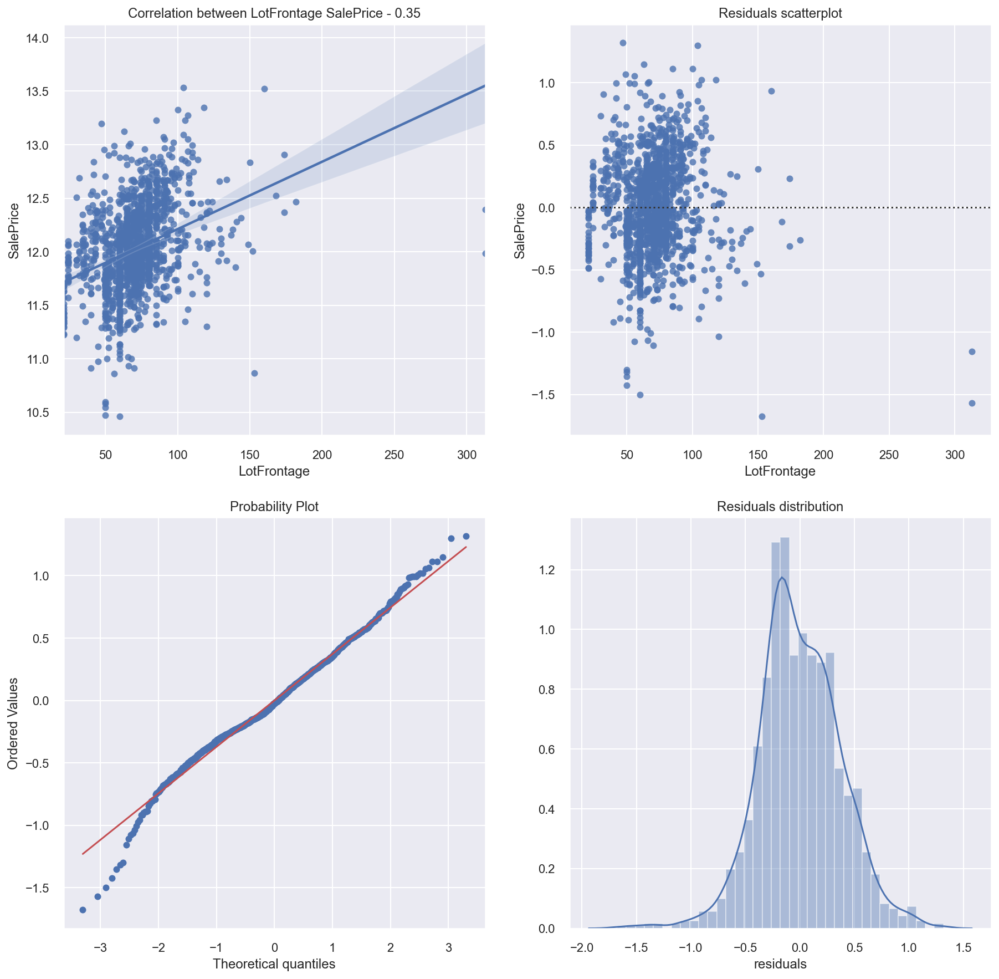

In [52]:
results_one_variable(train[['LotFrontage']],np.log1p(y), reg)

R2 - 0.1186732295247458
Distribution of residuals is NOT normal with p-value 0.0


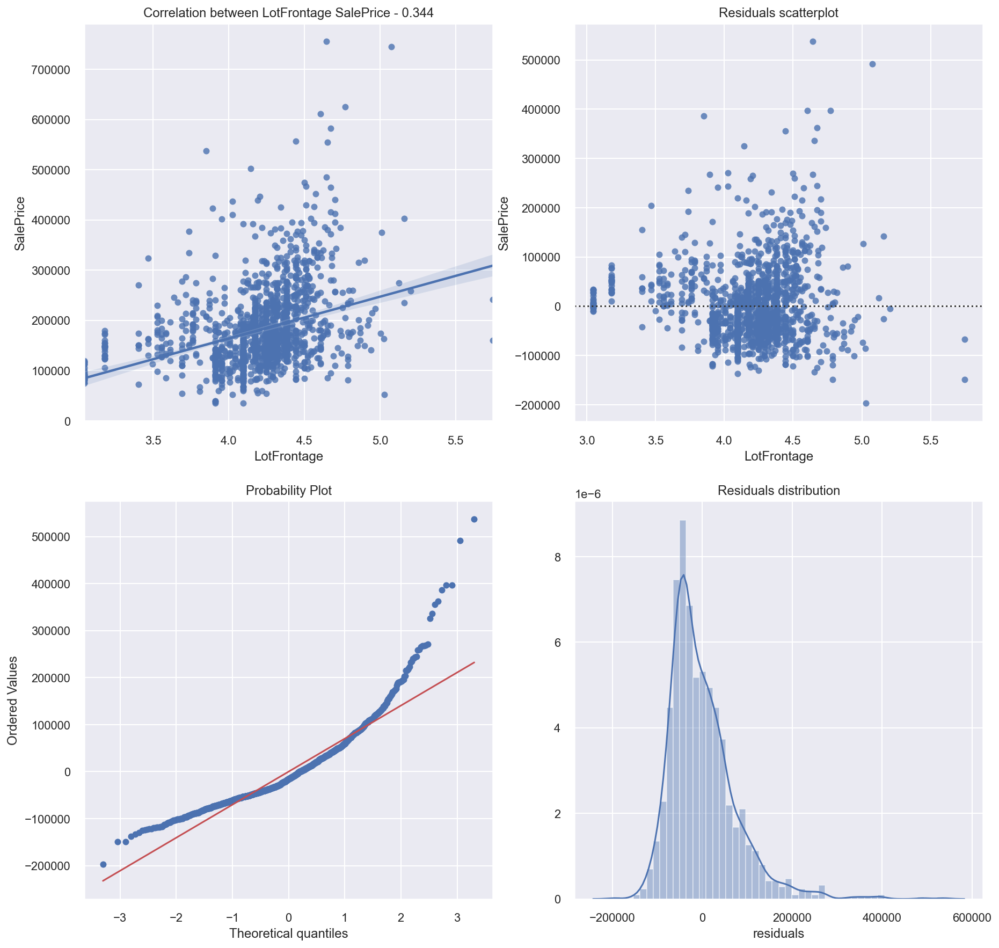

In [53]:
results_one_variable(np.log(train[['LotFrontage']]),y, reg)

R2 - 0.1305176225240794
Distribution of residuals is NOT normal with p-value 0.0


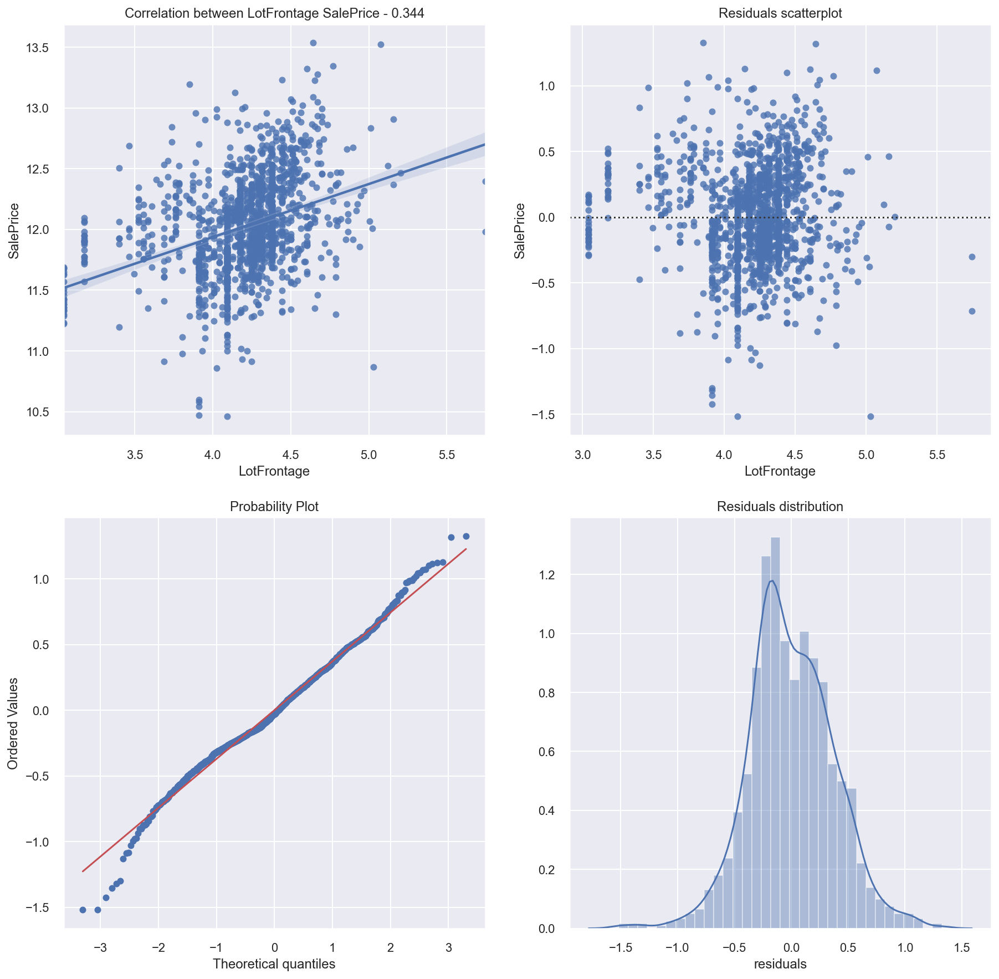

In [54]:
results_one_variable(np.log(train[['LotFrontage']]),np.log(y), reg)

for X and Y transformations results are better

R2 - 0.6256518924621182
Distribution of residuals is NOT normal with p-value 0.0


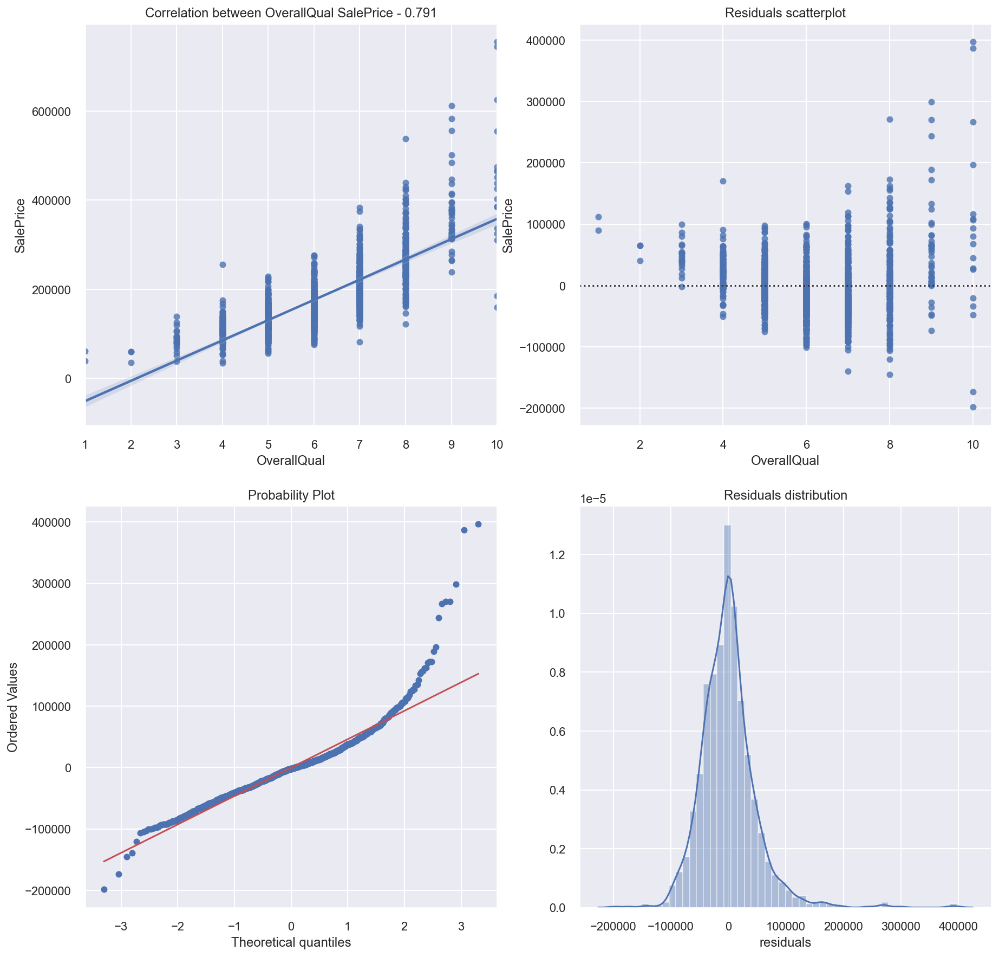

In [55]:
results_one_variable(train[['OverallQual']],y, reg)

R2 - 0.6677903728940005
Distribution of residuals is NOT normal with p-value 0.0


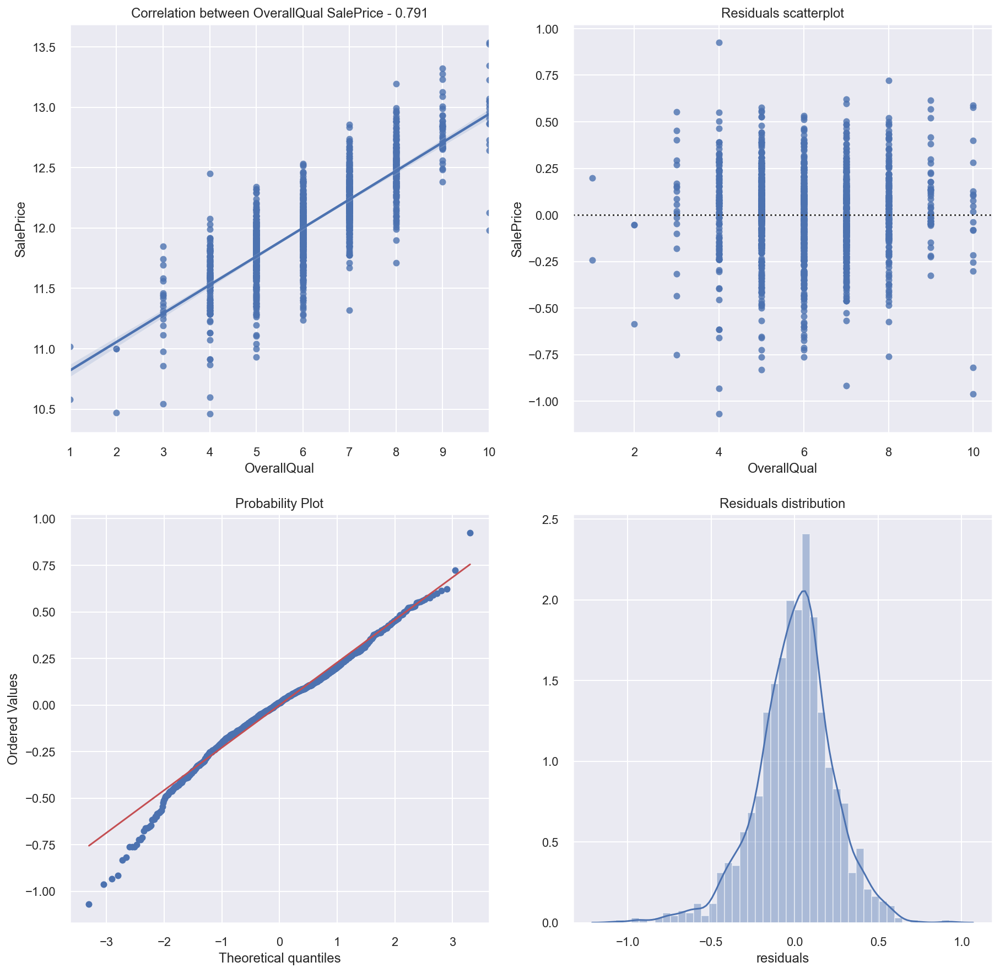

In [56]:
results_one_variable(train[['OverallQual']],np.log(y), reg)

R2 - 0.6304478990302036
Distribution of residuals is NOT normal with p-value 0.0


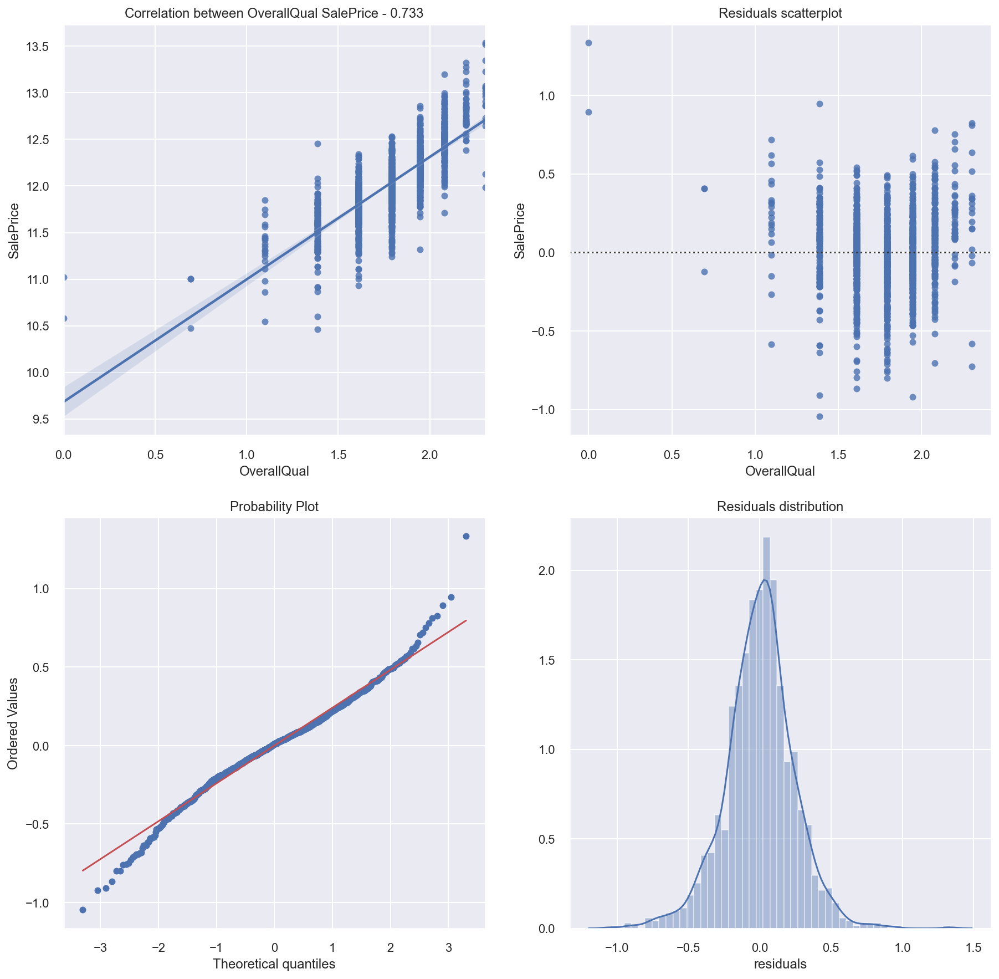

In [57]:
results_one_variable(np.log(train[['OverallQual']]),np.log(y), reg)

R2 - 0.6677642652367046
Distribution of residuals is NOT normal with p-value 0.0


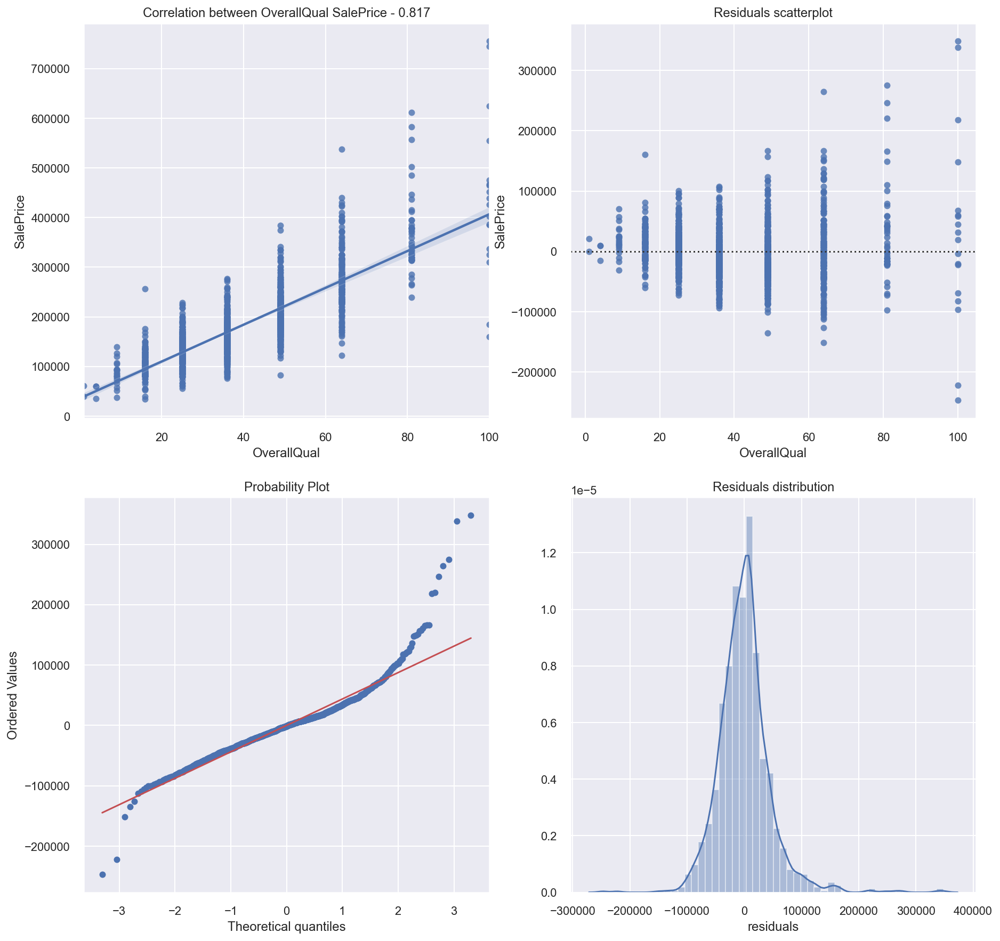

In [58]:
results_one_variable(train[['OverallQual']]**2,y, reg)

here the error increases with increasing quality

R2 - 0.6599509987324608
Distribution of residuals is NOT normal with p-value 0.0


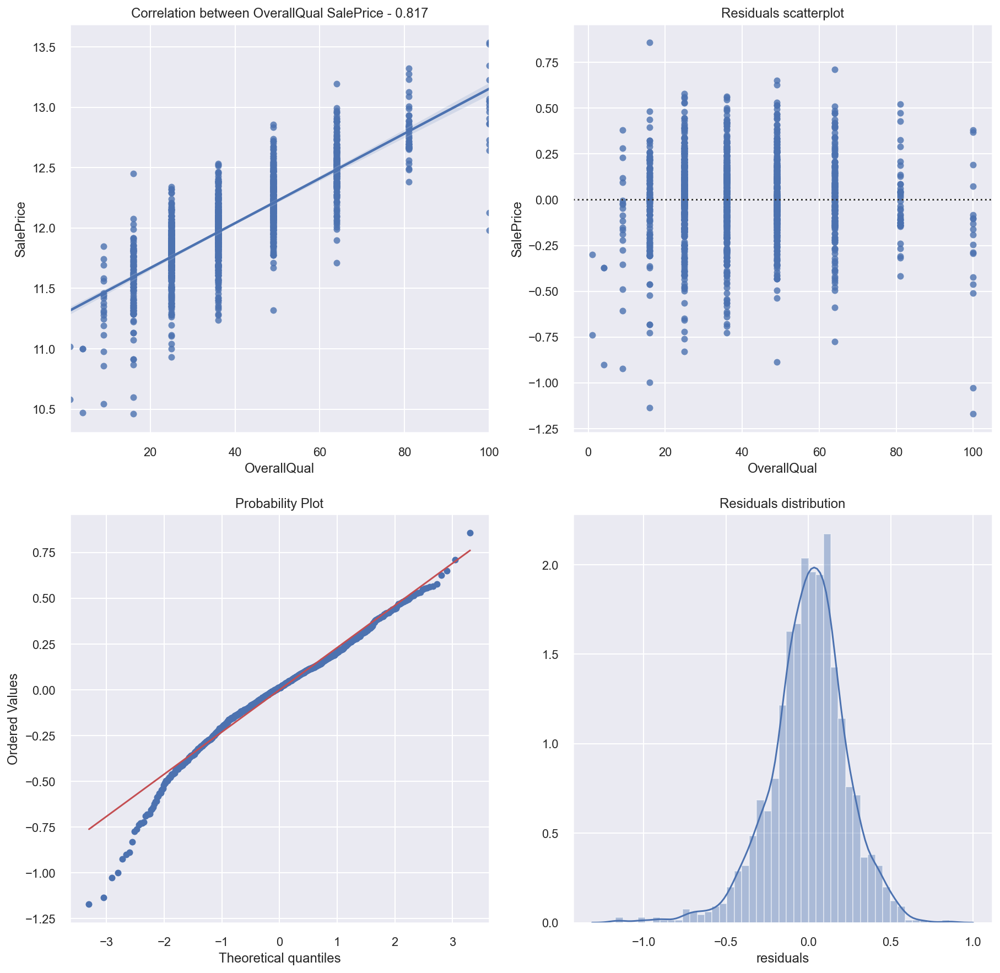

In [59]:
results_one_variable(train[['OverallQual']]**2,np.log(y), reg)

you can choose either the first or last version of the transformation

let's look at another variable and apply transformations

R2 - 0.5021486502718042
Distribution of residuals is NOT normal with p-value 0.0


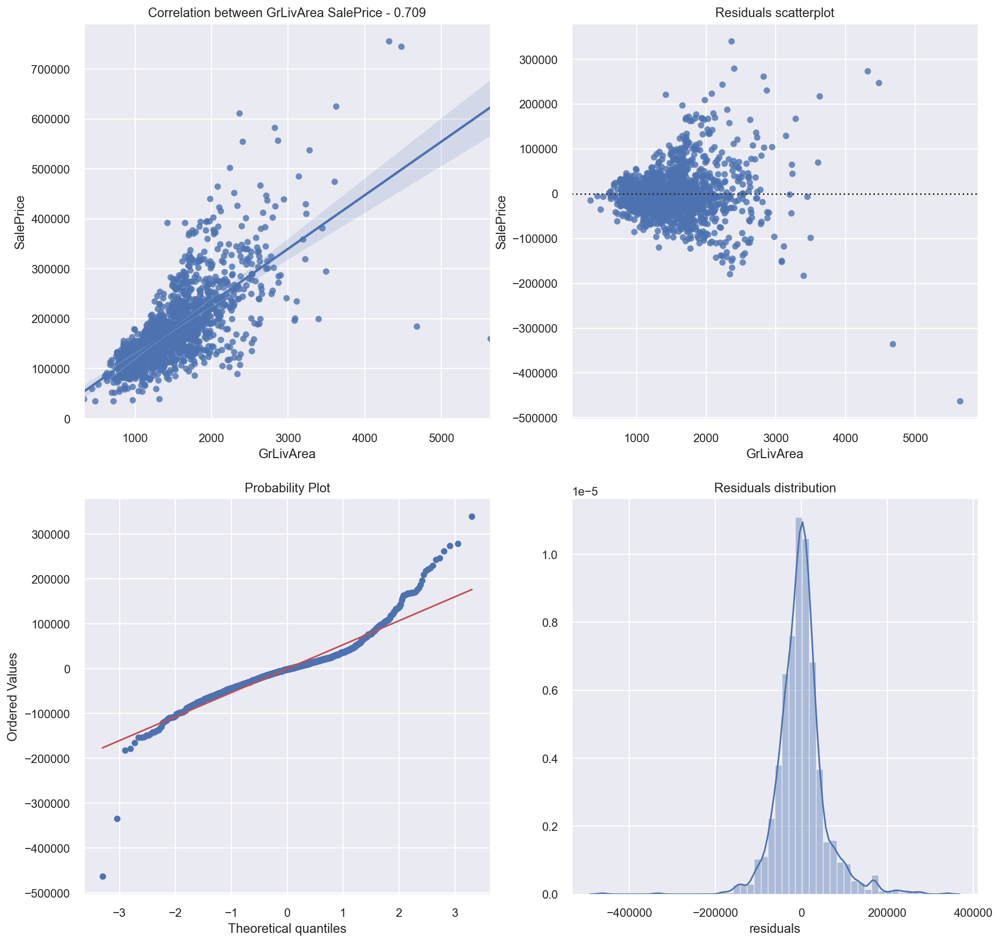

In [60]:
results_one_variable(train[['GrLivArea']],y, reg)

R2 - 0.49129817224671934
Distribution of residuals is NOT normal with p-value 0.0


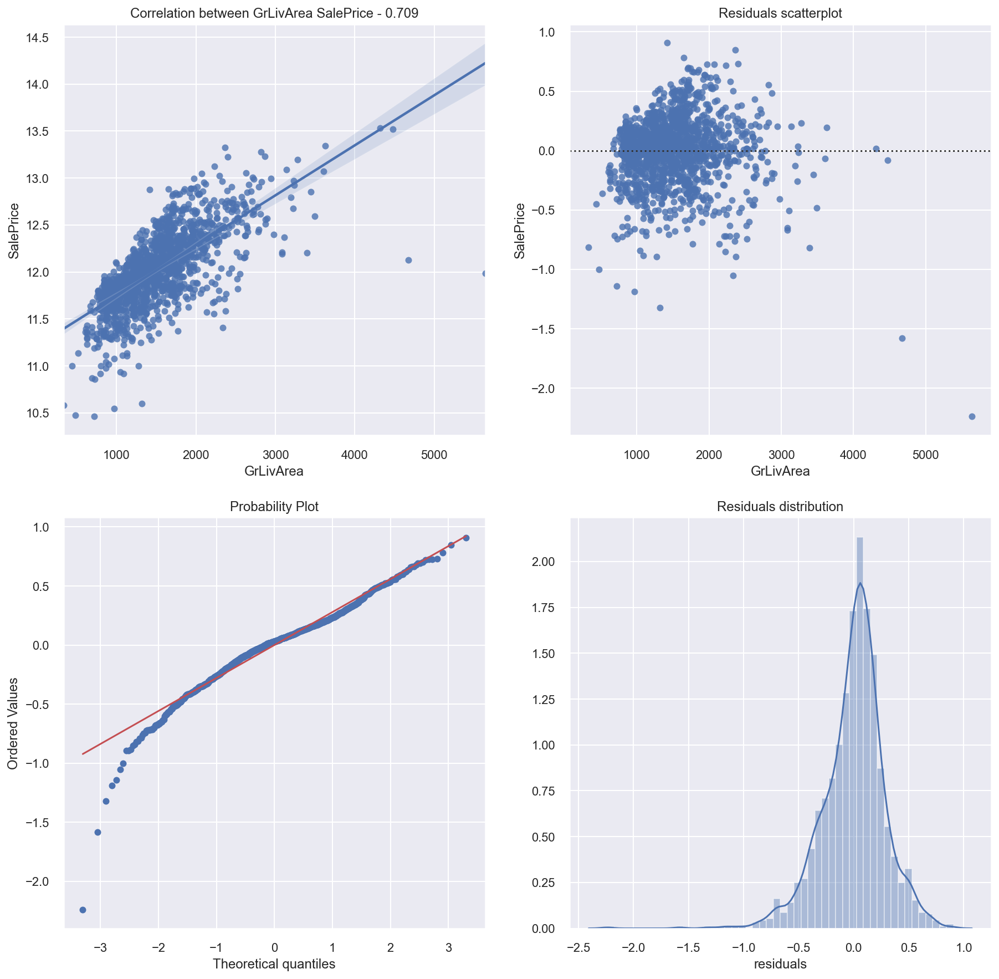

In [61]:
results_one_variable(train[['GrLivArea']],np.log(y), reg)

so it's better but isn't good

R2 - 0.5332721476985478
Distribution of residuals is NOT normal with p-value 0.0


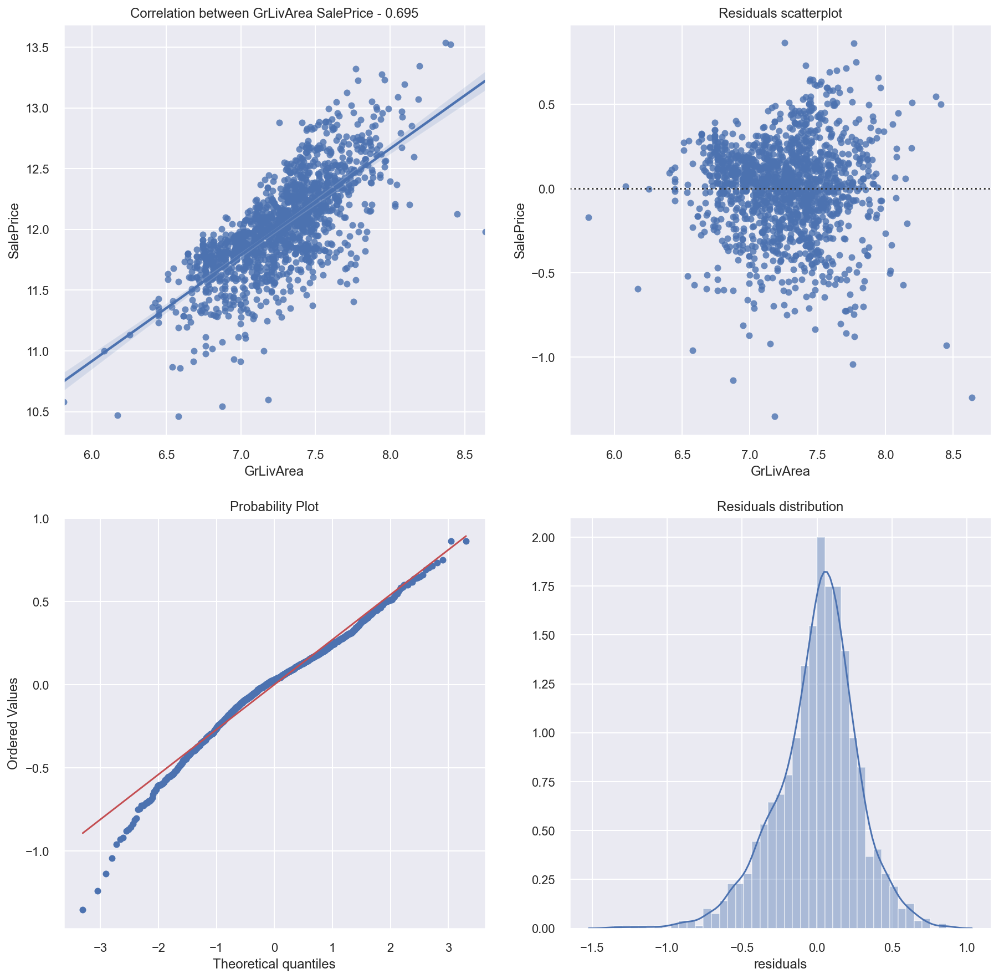

In [62]:
results_one_variable(np.log(train[['GrLivArea']]),np.log(y), reg)

this transformation is prety good

In [114]:
y = np.log(y)

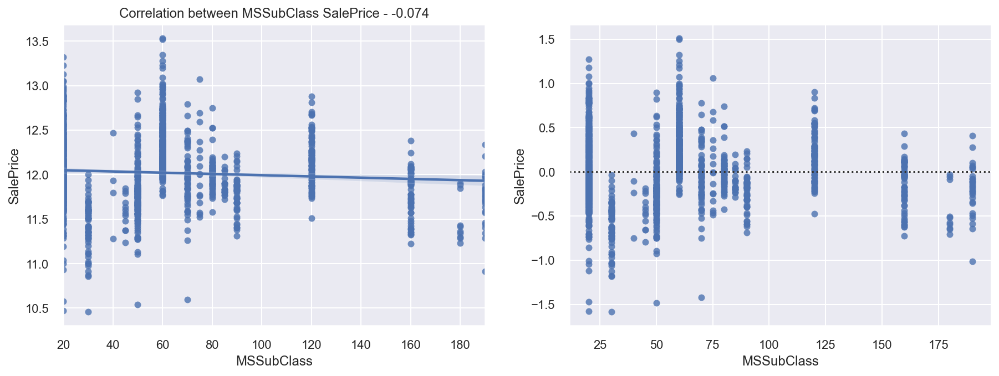

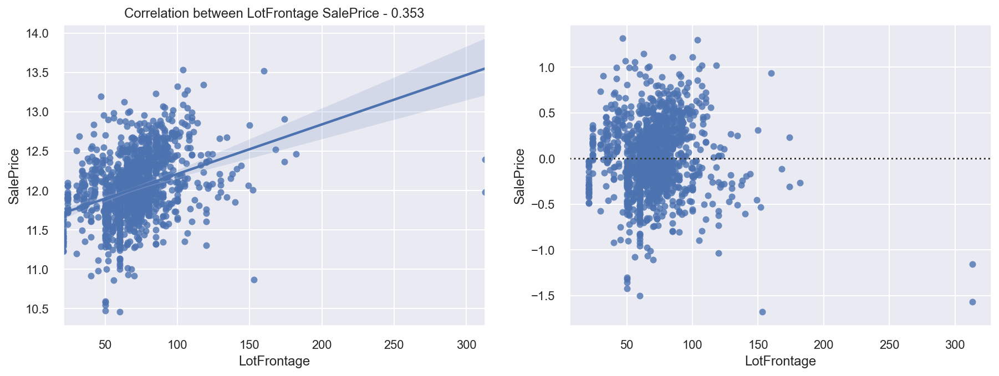

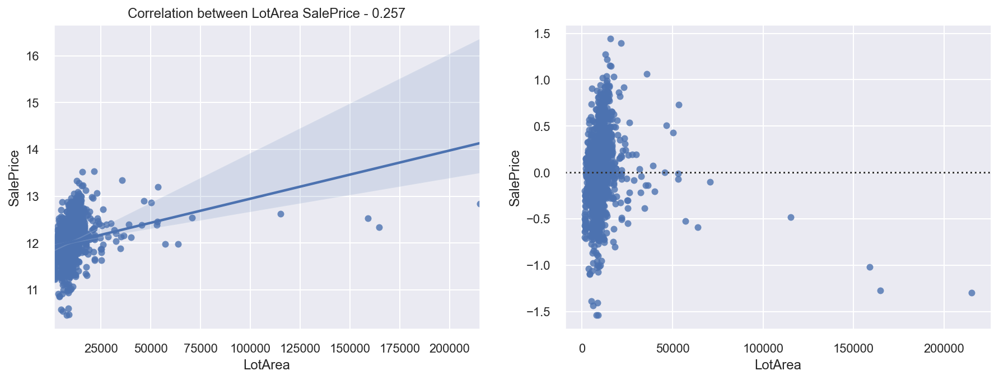

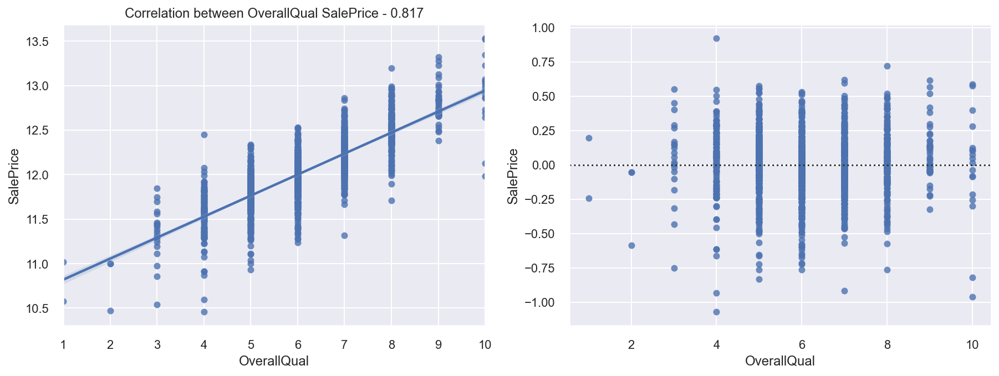

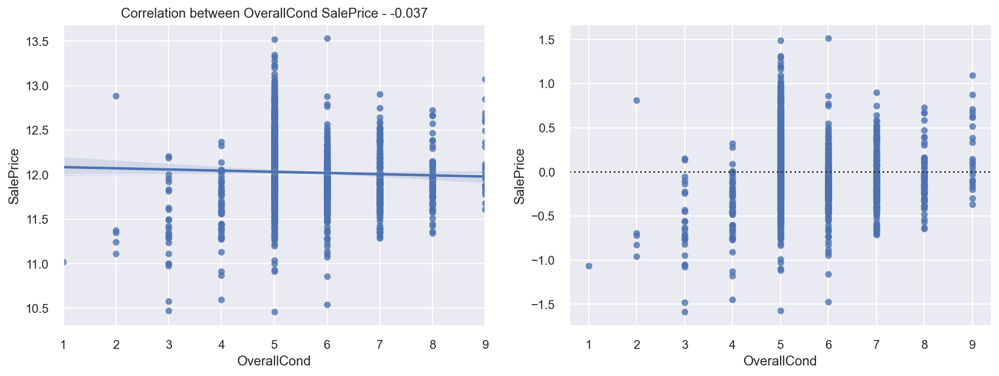

...

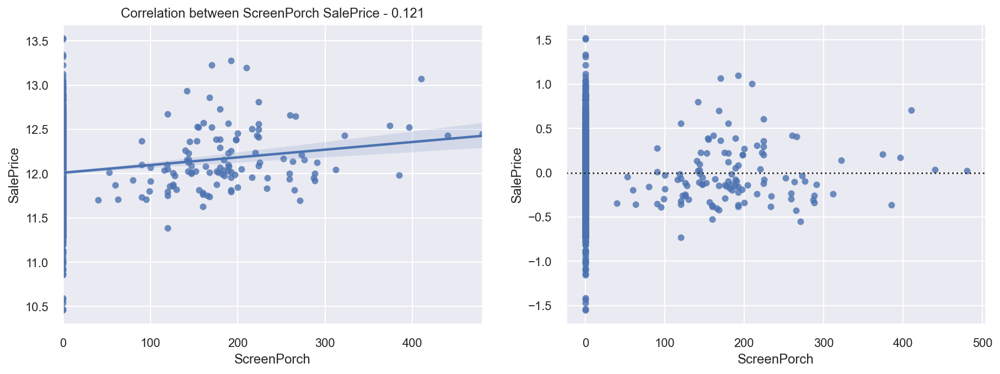

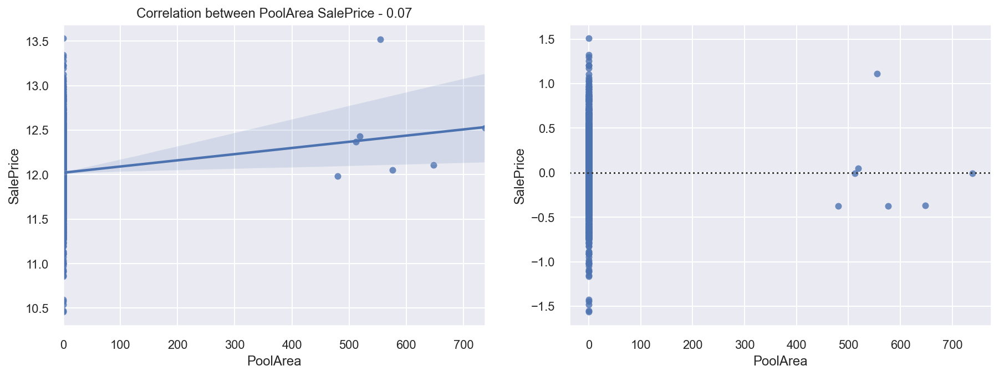

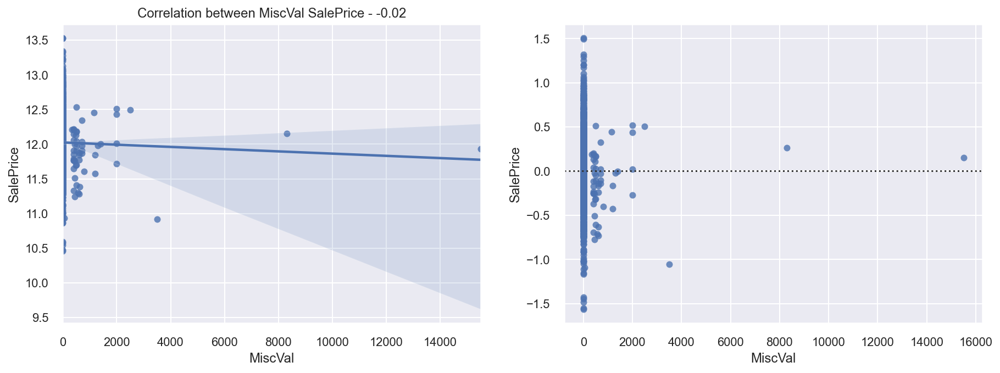

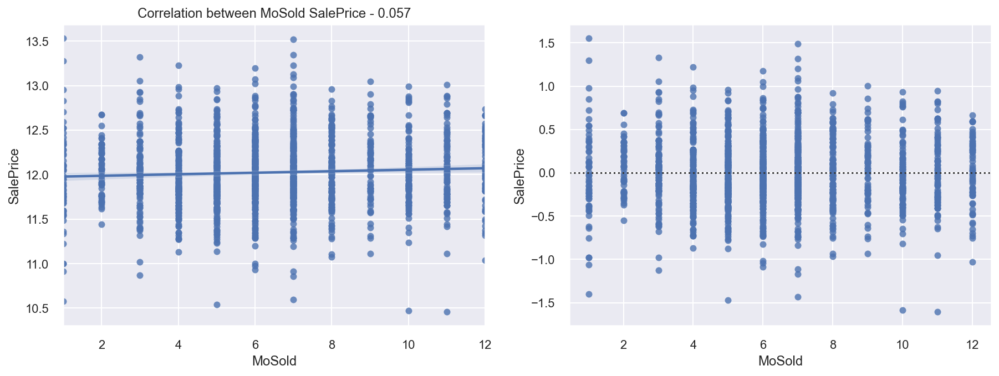

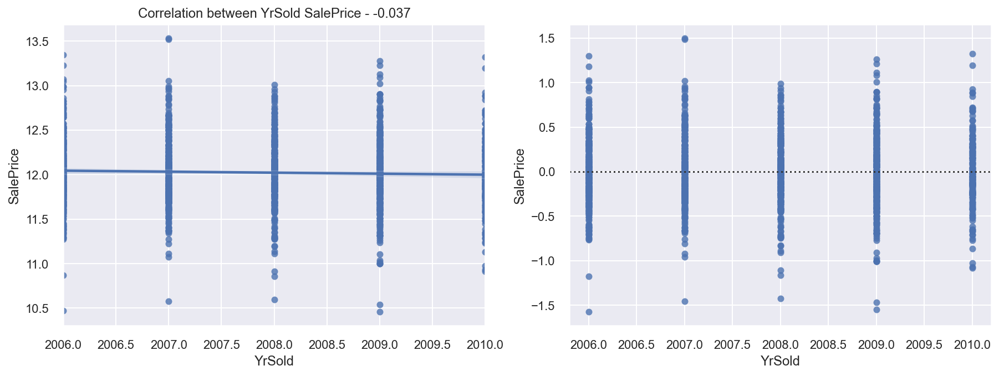

In [64]:
for i in numerical:
    corr_and_residuals(train[i], y)

analyze and transform each variable

In [65]:
poly = PolynomialFeatures(6)

R2 - 0.5226147546628417
Distribution of residuals is NOT normal with p-value 0.0


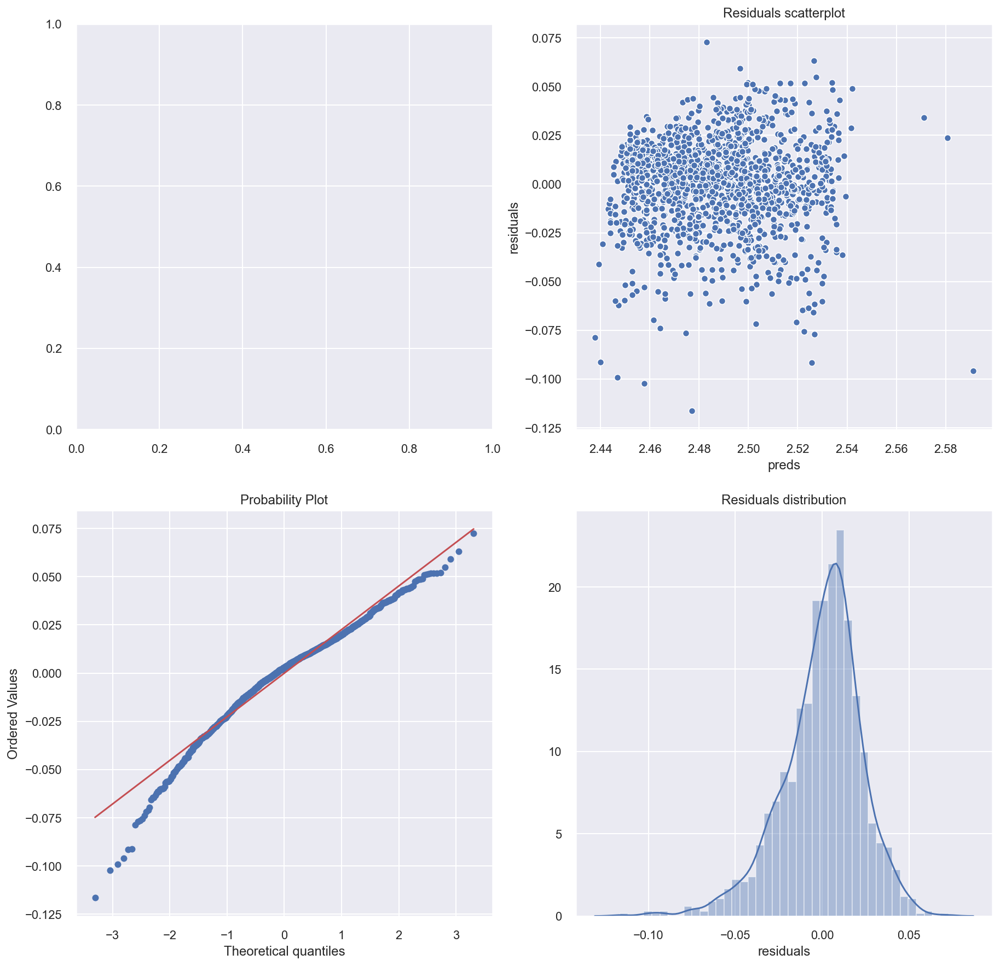

In [66]:
results_one_variable(poly.fit_transform(train[['GrLivArea']]),np.log(y), reg)

R2 - 0.0003905042509820822
Distribution of residuals is NOT normal with p-value 0.0


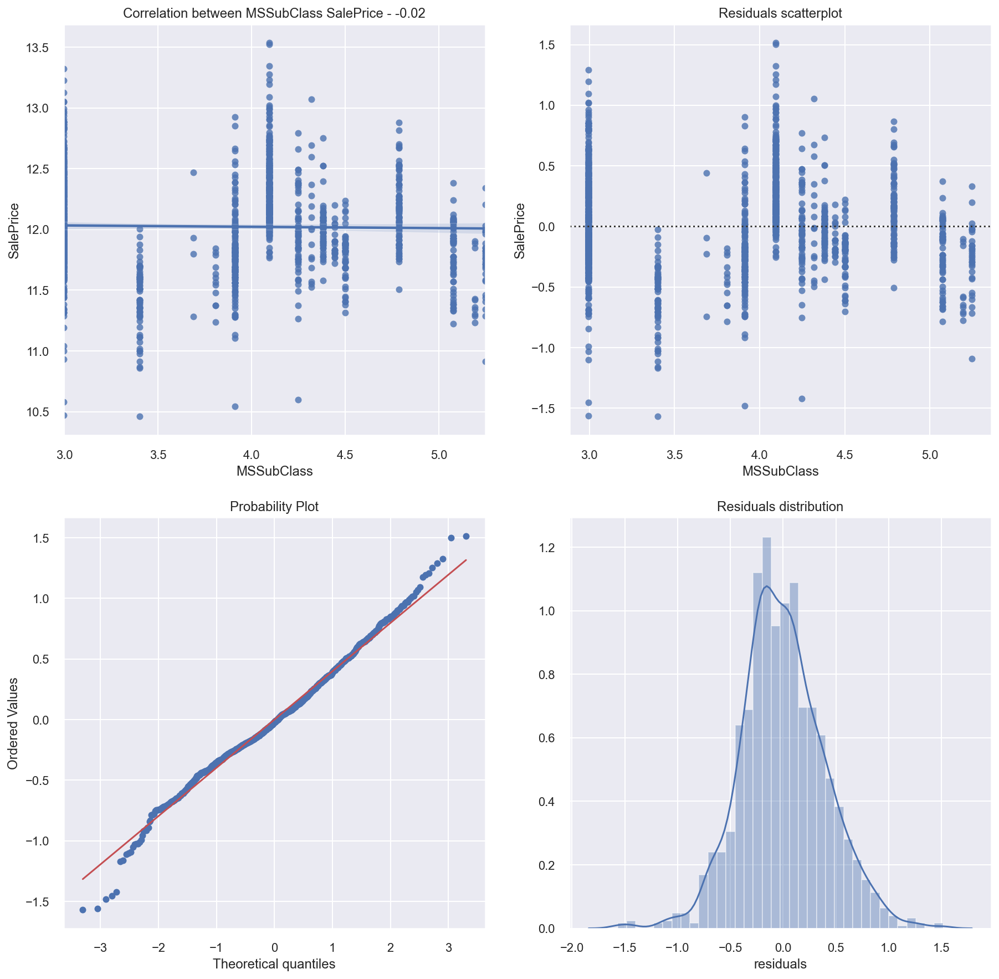

In [67]:
results_one_variable(np.log(train[['MSSubClass']]),y, reg)

R2 - 0.0054699362447740985
Distribution of residuals is NOT normal with p-value 0.0


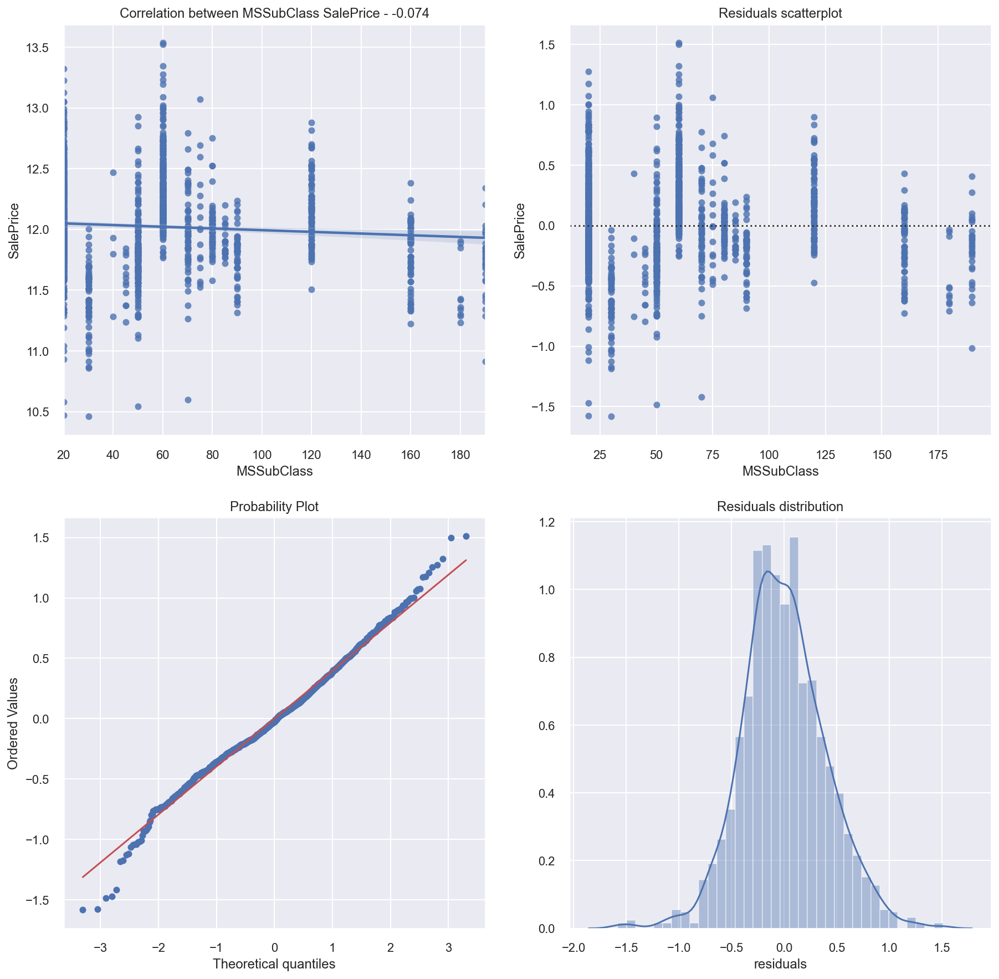

In [68]:
results_one_variable(train[['MSSubClass']],y, reg)

R2 - 0.023676732086955973
Distribution of residuals is NOT normal with p-value 0.0


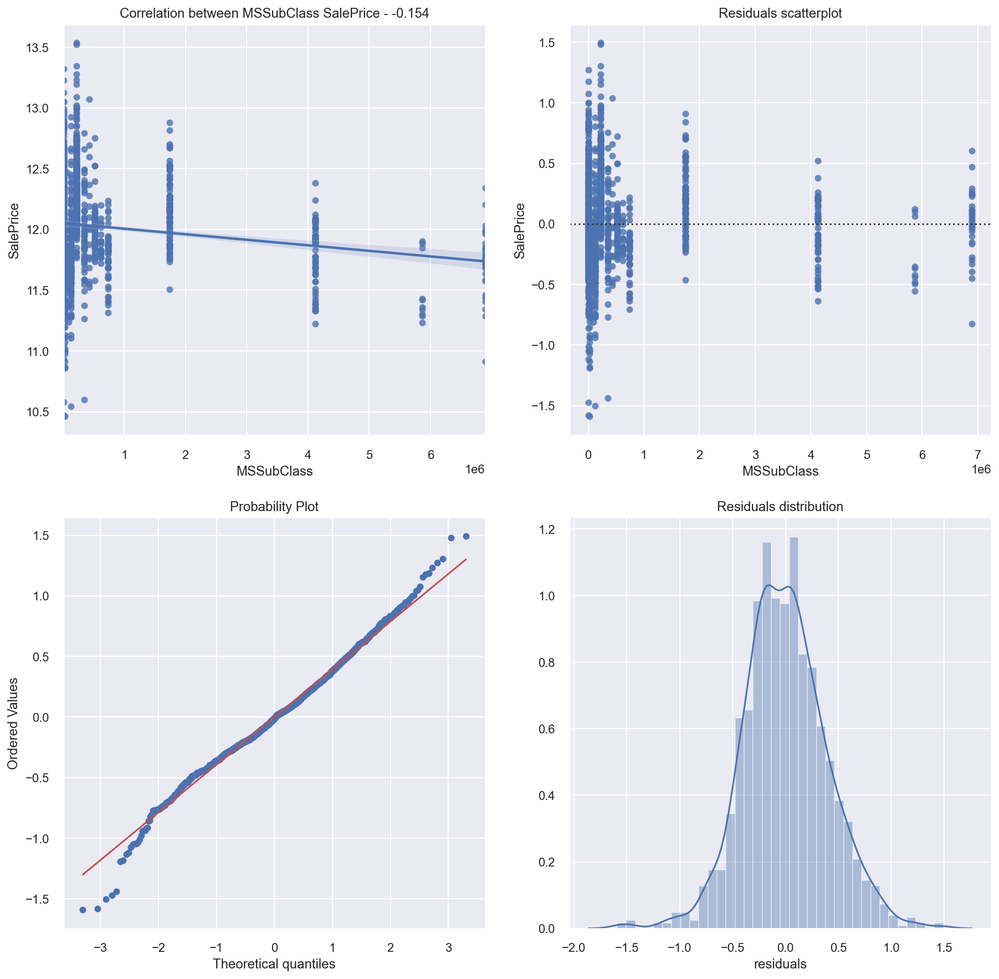

In [69]:
results_one_variable((train[['MSSubClass']]**3 +train[['MSSubClass']]**2),y, reg)

In [70]:
poly.fit_transform(train[['MSSubClass']]).T

array([[1.00000e+00, 1.00000e+00, 1.00000e+00, ..., 1.00000e+00,
        1.00000e+00, 1.00000e+00],
       [6.00000e+01, 2.00000e+01, 6.00000e+01, ..., 7.00000e+01,
        2.00000e+01, 2.00000e+01],
       [3.60000e+03, 4.00000e+02, 3.60000e+03, ..., 4.90000e+03,
        4.00000e+02, 4.00000e+02],
       ...,
       [1.29600e+07, 1.60000e+05, 1.29600e+07, ..., 2.40100e+07,
        1.60000e+05, 1.60000e+05],
       [7.77600e+08, 3.20000e+06, 7.77600e+08, ..., 1.68070e+09,
        3.20000e+06, 3.20000e+06],
       [4.66560e+10, 6.40000e+07, 4.66560e+10, ..., 1.17649e+11,
        6.40000e+07, 6.40000e+07]])

R2 - 0.0889914514219744
Distribution of residuals is NOT normal with p-value 0.0


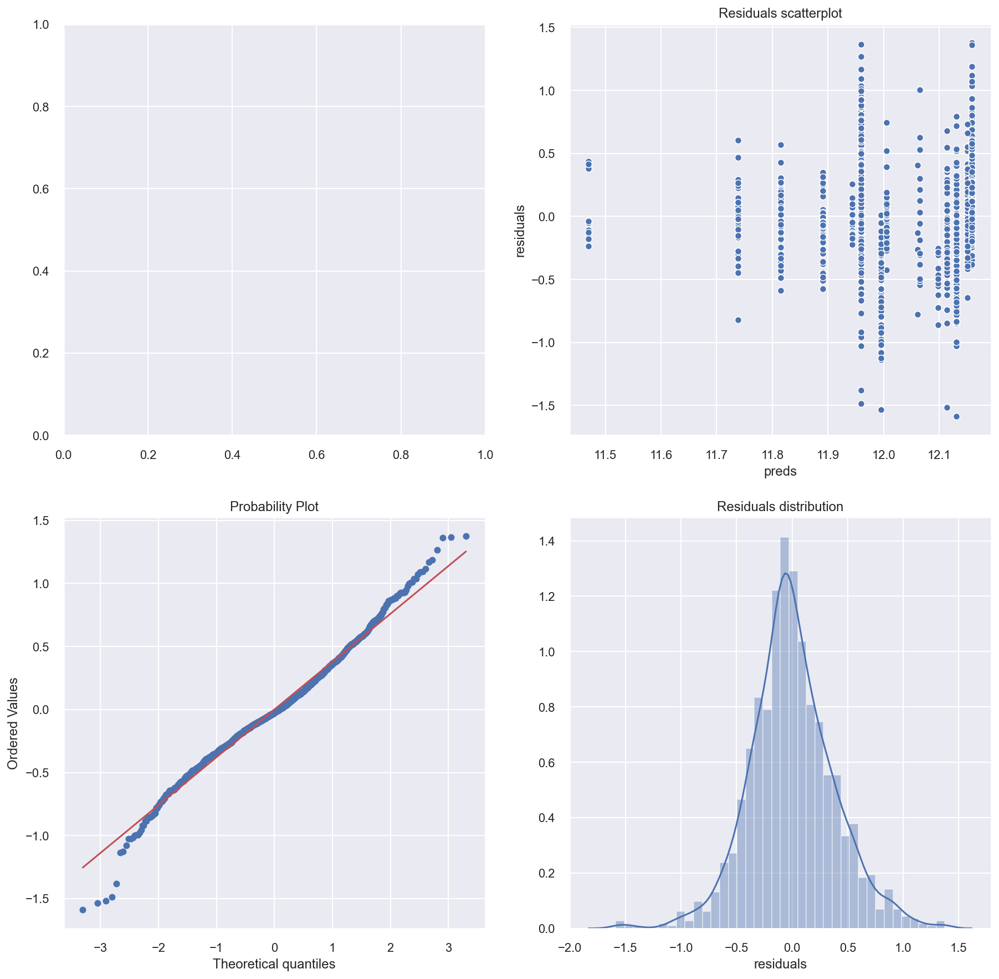

In [71]:
results_one_variable(PolynomialFeatures(10).fit_transform(train[['MSSubClass']]),y, reg)

R2 - 0.24966298339693915
Distribution of residuals is NOT normal with p-value 0.0


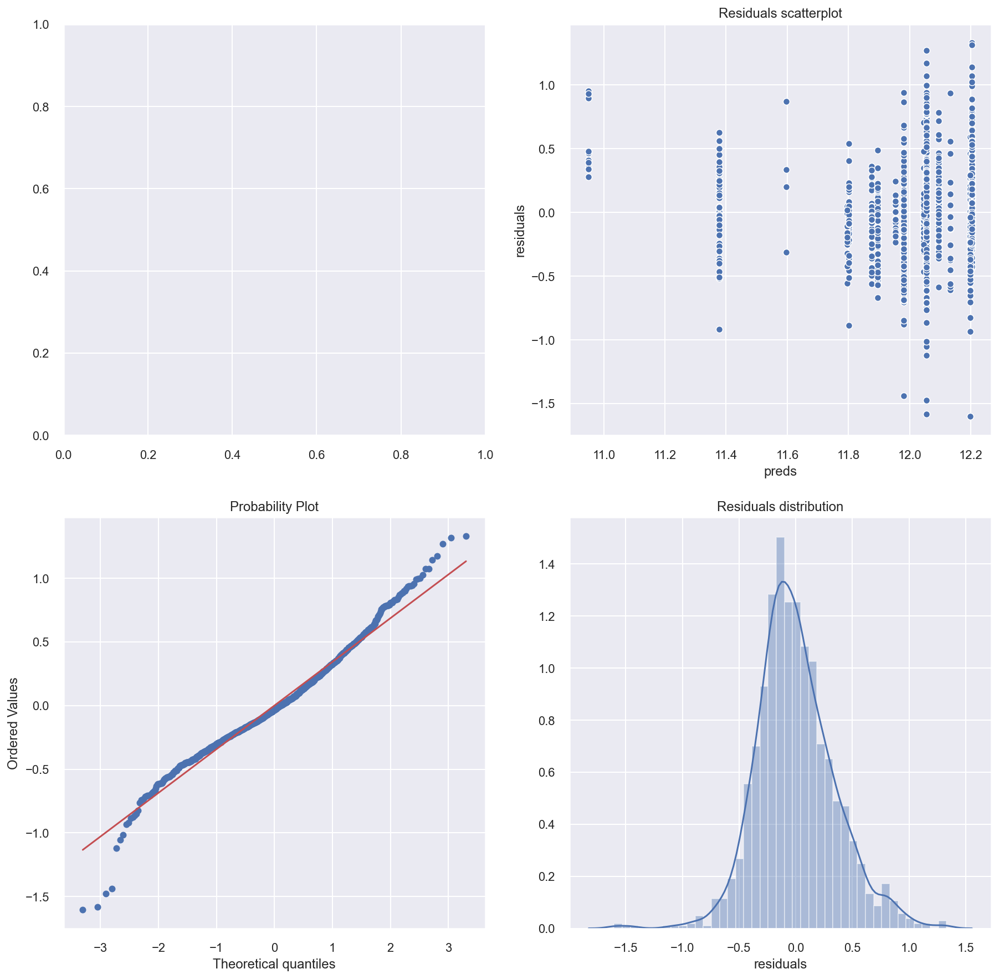

In [72]:
results_one_variable(PolynomialFeatures(6).fit_transform(train[['MSSubClass']]),y, reg)

R2 - 0.04145839757107329
Distribution of residuals is NOT normal with p-value 0.0


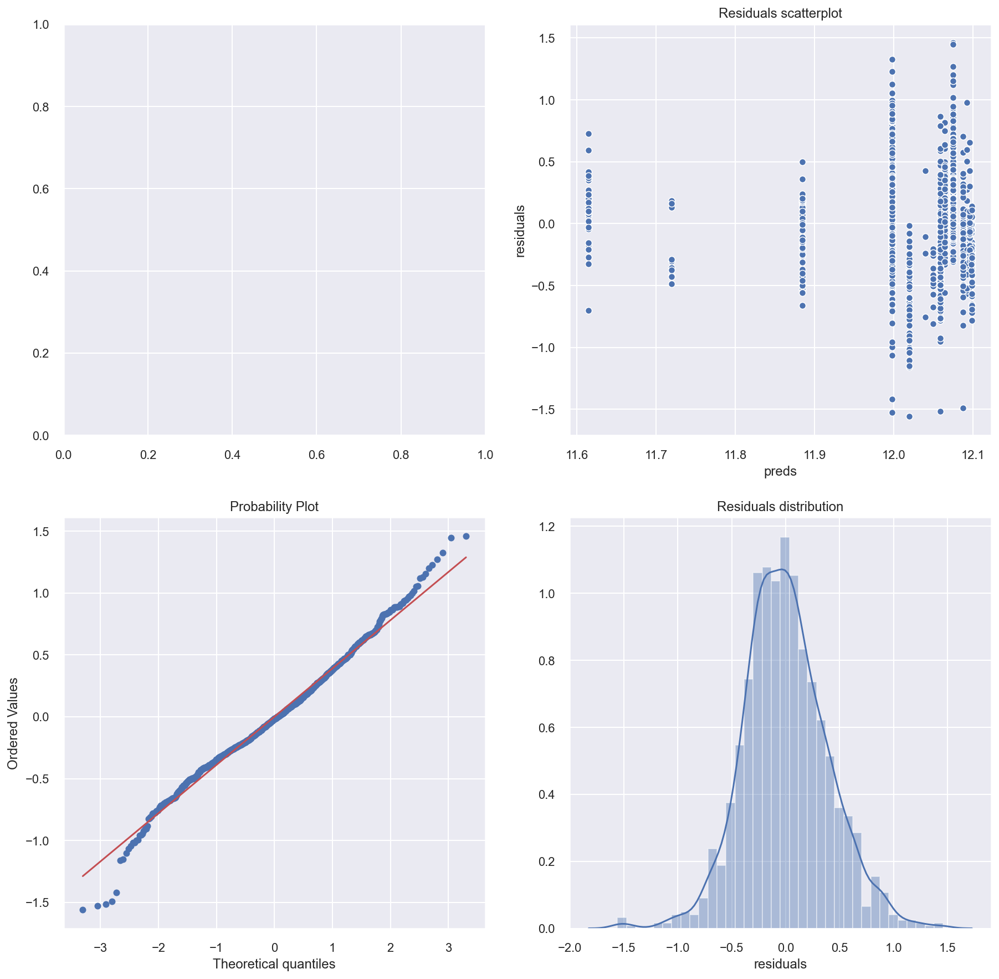

In [73]:
results_one_variable(PolynomialFeatures(3).fit_transform(train[['MSSubClass']]),y, reg)

In [74]:
# here I would add another polynomial transformation 

In [89]:
poly = PolynomialFeatures(6)

In [90]:
train['MSSubClass_2'] = poly.fit_transform(train[['MSSubClass']]).T[2]
train['MSSubClass_3'] = poly.fit_transform(train[['MSSubClass']]).T[3]
train['MSSubClass_4'] = poly.fit_transform(train[['MSSubClass']]).T[4]
train['MSSubClass_5'] = poly.fit_transform(train[['MSSubClass']]).T[5]
train['MSSubClass_6'] = poly.fit_transform(train[['MSSubClass']]).T[5]

R2 - 0.13091049852960834
Distribution of residuals is NOT normal with p-value 0.0


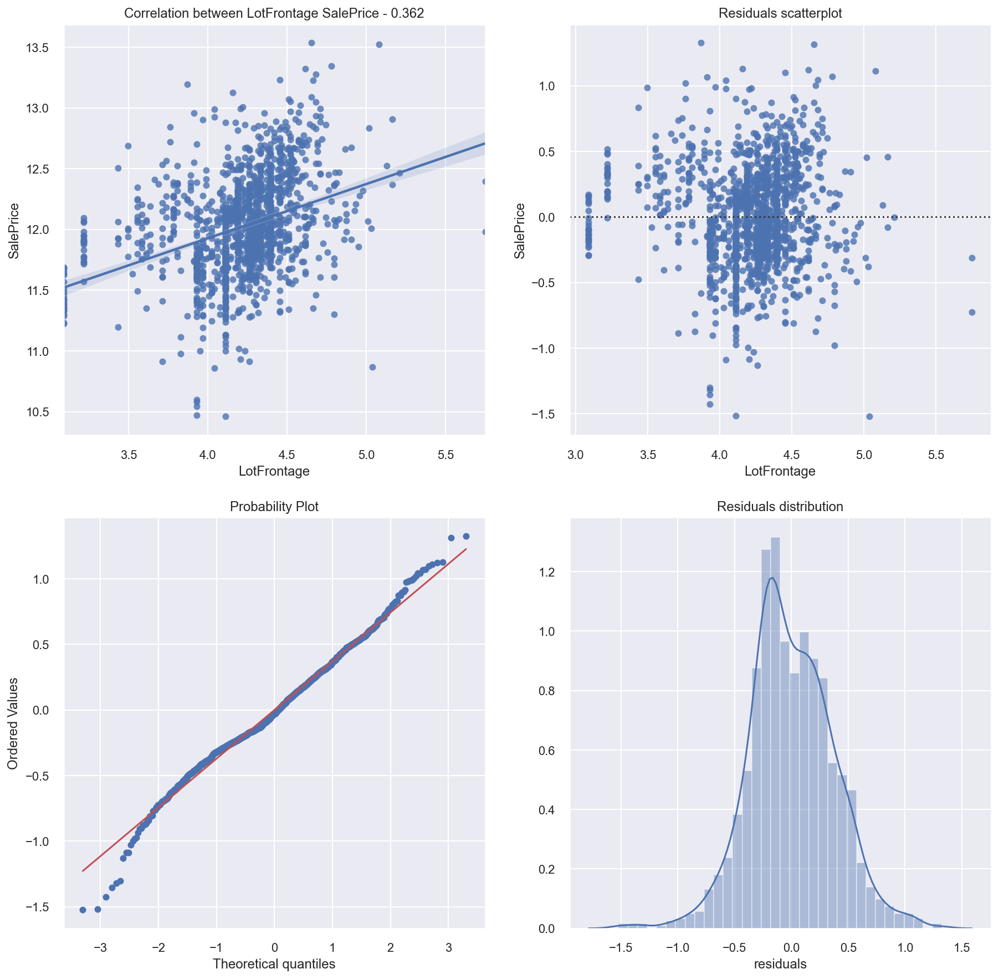

In [77]:
results_one_variable(np.log1p(train[['LotFrontage']]),y, reg)

R2 - 0.12481247235580195
Distribution of residuals is NOT normal with p-value 0.0


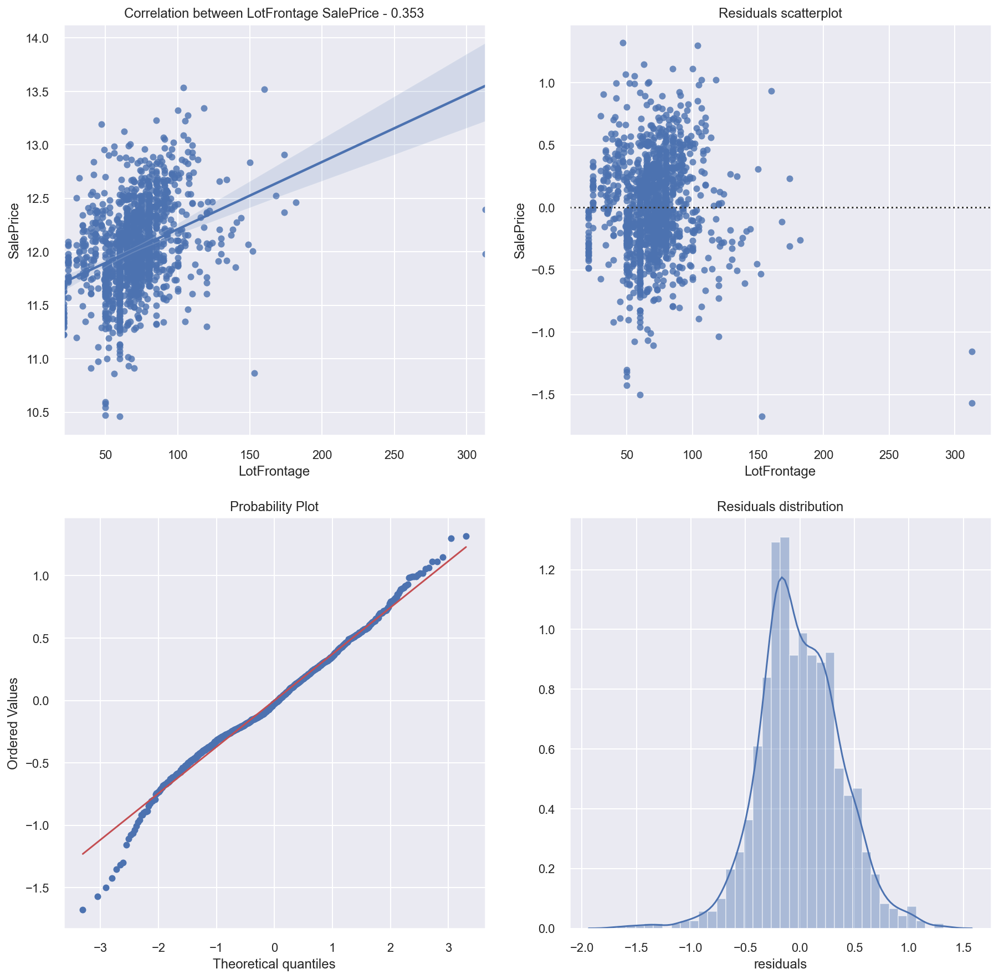

In [78]:
results_one_variable(train[['LotFrontage']],y, reg)

R2 - 0.15092579772590164
Distribution of residuals is NOT normal with p-value 0.0


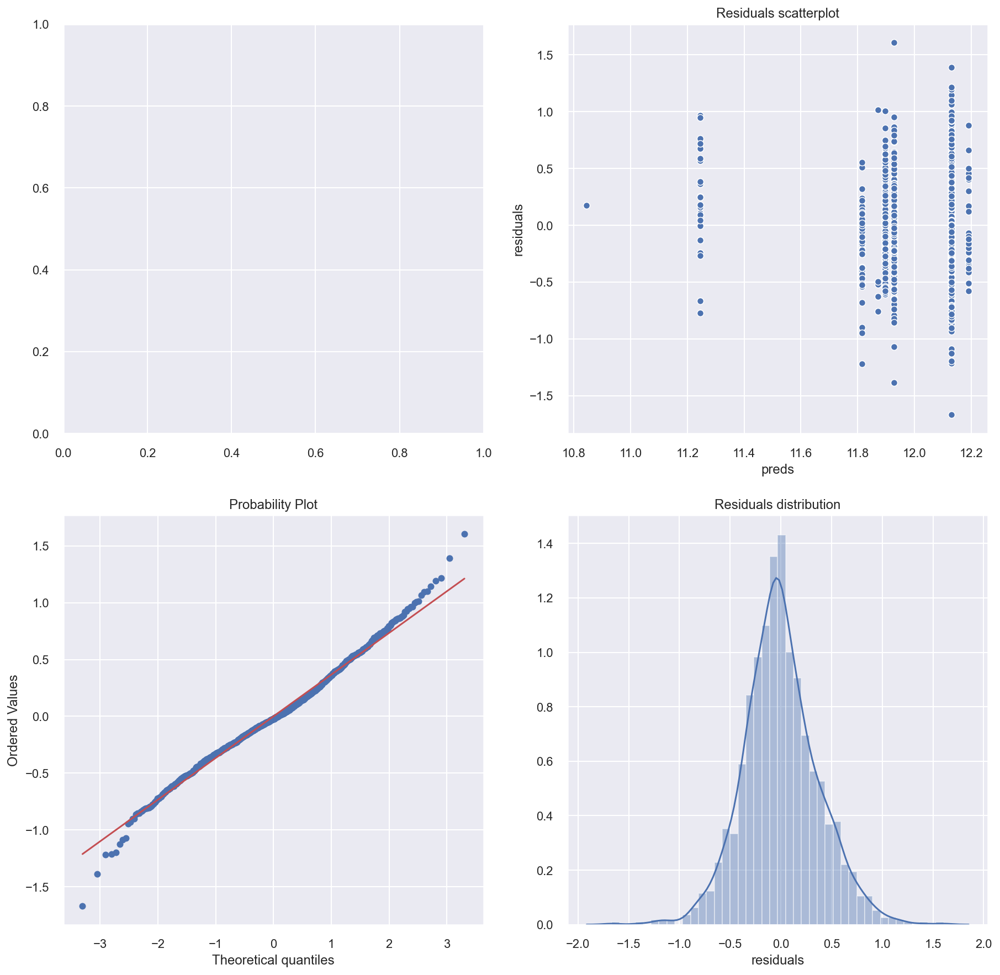

In [79]:
results_one_variable(PolynomialFeatures(7).fit_transform(train[['OverallCond']]),y, reg)

In [80]:
# Analyzing each feature, we change or add a transformation

In [91]:
train['MSSubClass_new'] = train['MSSubClass']**3 +train['MSSubClass']**2
train['LotFrontage'] = np.log1p(train['LotFrontage'])
train['LotArea'] = np.log1p(train['LotArea'])
train['2ndFlrSF_2'] = train['2ndFlrSF']**2
train['2ndFlrSF_3'] = train['2ndFlrSF']**3
train['2ndFlrSF_4'] = train['2ndFlrSF']**4
train['OverallCond_2'] = train['OverallCond']**2
train['OverallCond_3'] = train['OverallCond']**3
train['OverallCond_4'] = train['OverallCond']**4
train['OverallCond_5'] = train['OverallCond']**5
train['OverallCond_6'] = train['OverallCond']**6
train['OverallCond_7'] = train['OverallCond']**7
train['GrLivArea'] = np.log1p(train['GrLivArea'])
train['BsmtFullBath'] = np.log1p(train['BsmtFullBath'])
train['WoodDeckSF'] = np.log1p(train['WoodDeckSF']) # это под сомнением 
train['OpenPorchSF'] = np.log1p(train['OpenPorchSF'])
train['EnclosedPorch'] = np.log1p(train['EnclosedPorch'])

In [112]:
y= y.drop([1298, 1396, 523])
train = train.drop([1298, 1396, 523])

KeyError: '[1298 1396  523] not found in axis'

In [113]:
y

0       208500
1       181500
2       223500
3       140000
4       250000
         ...  
1455    175000
1456    210000
1457    266500
1458    142125
1459    147500
Name: SalePrice, Length: 1457, dtype: int64

# Feture engineering 

In [93]:
train['age'] = train['YrSold'].astype(int)-train['YearRemodAdd']

In [94]:
# feture engineering a new feature "TotalFS"
train['SF_with_Bsmt'] = (train['TotalBsmtSF'] 
                       + train['1stFlrSF'] 
                       + train['2ndFlrSF'])
train['SF_wo_Bsmt'] = ( train['1stFlrSF'] 
                       + train['2ndFlrSF'])

train['from_built_to_Remod'] = train['YearRemodAdd'] - train['YearBuilt']
train['total_years'] = train['YearRemodAdd'] + train['YearBuilt'] 

train['age'] = train['YrSold'].astype(int)-train['YearRemodAdd']

train['total_sqr'] = (train['BsmtFinSF1'] 
                                 + train['BsmtFinSF2'] 
                                 + train['1stFlrSF'] 
                                 + train['2ndFlrSF']
                                )
                                 

train['Total_Bathrooms'] = (train['FullBath'] 
                               + train['HalfBath']
                               + train['BsmtFullBath'] 
                               + train['BsmtHalfBath']
                              )
                               
    
train['Total_porch_sf'] = (train['OpenPorchSF'] 
                              + train['3SsnPorch'] 
                              + train['EnclosedPorch'] 
                              + train['ScreenPorch'] 
                              + train['WoodDeckSF']
                             )

train['TotRms'] = train['TotRmsAbvGrd']+train['Total_Bathrooms']
                        
train['YearBuilt_cat'] =  train['YearBuilt'].apply(lambda x: 
                                                   'very_old' if x < 1920 
                                                    else('old' if x > 1920 and x < 1960 
                                                        else( 'middle' if x > 1960 and x < 1980
                                                             else('new' if x > 1980 and x < 2000
                                                                  else 'new_new'
                                                             )))
                                                  )
  
    
train['haspool'] = train['PoolArea'].apply(lambda x: 1 if x > 0 else 0)
train['has2ndfloor'] = train['2ndFlrSF'].apply(lambda x: 1 if x > 0 else 0)
train['hasgarage'] = train['GarageArea'].apply(lambda x: 1 if x > 0 else 0)
train['hasbsmt'] = train['TotalBsmtSF'].apply(lambda x: 1 if x > 0 else 0)
train['hasfireplace'] = train['Fireplaces'].apply(lambda x: 1 if x > 0 else 0)
train['hasporch'] = train['Total_porch_sf'].apply(lambda x: 1 if x > 0 else 0)
train['hasalley'] = train['Alley'].apply(lambda x: 0 if x == 'No_alley' else 1)
train['was_remod'] = train['from_built_to_Remod'].apply(lambda x: 1 if x > 0 else 0)
train['is_new']  = train.YrSold==train.YearBuilt

R2 - 0.32379871438121555
Distribution of residuals is NOT normal with p-value 0.0


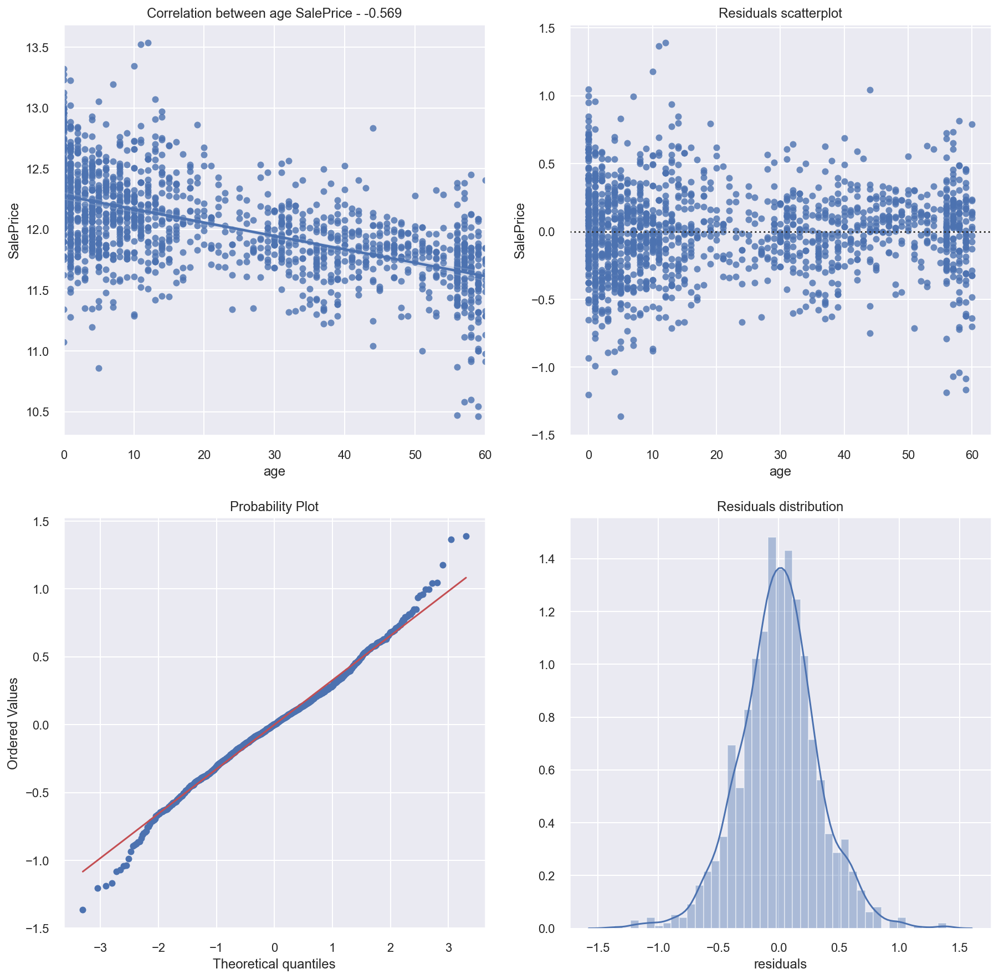

In [85]:
results_one_variable(train[['age']], y, reg)

In [118]:
train[train['SF_wo_Bsmt']>4000].index

Int64Index([691, 1182], dtype='int64')

In [119]:
train[['SF_wo_Bsmt']].drop(train[train['SF_wo_Bsmt']>4000].index)

,SF_wo_Bsmt
0,1710
1,1262
2,1786
3,1717
4,2198
...,...
1455,1647
1456,2073
1457,2340
1458,1078


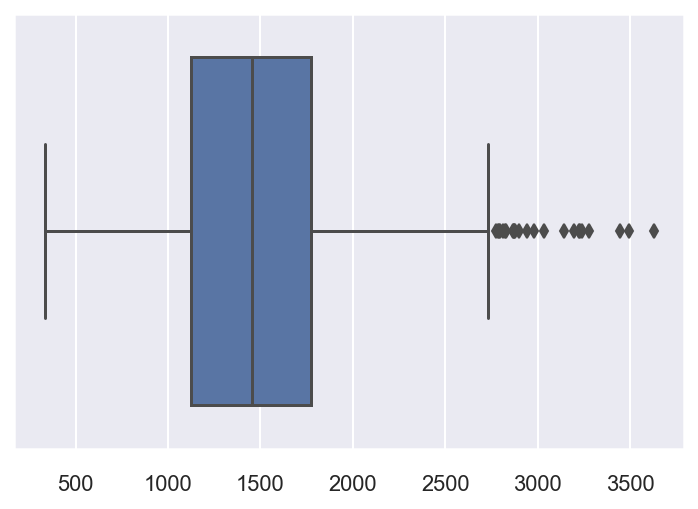

In [123]:
sns.boxplot(train[['SF_wo_Bsmt']].drop(train[train['SF_wo_Bsmt']>4000].index,))

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x1208b9850>]],
      dtype=object)

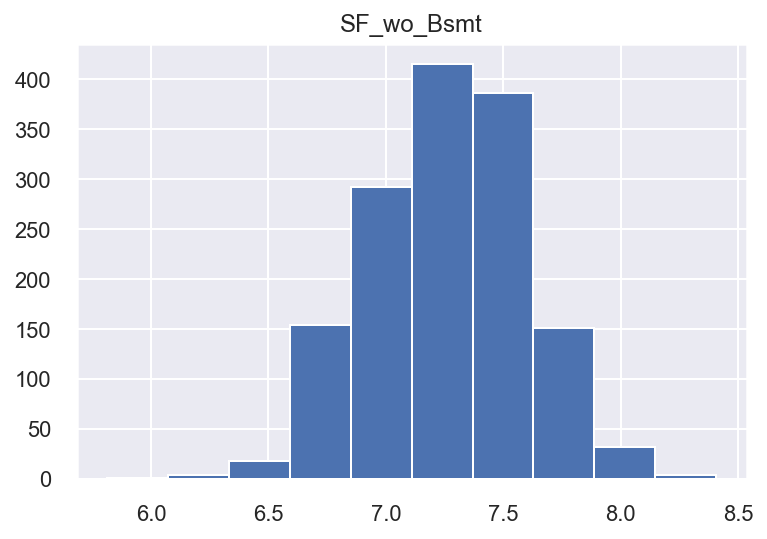

In [129]:
np.log1p(train[['SF_wo_Bsmt']]).hist()

R2 - 0.5321484605801796
Distribution of residuals is NOT normal with p-value 0.0


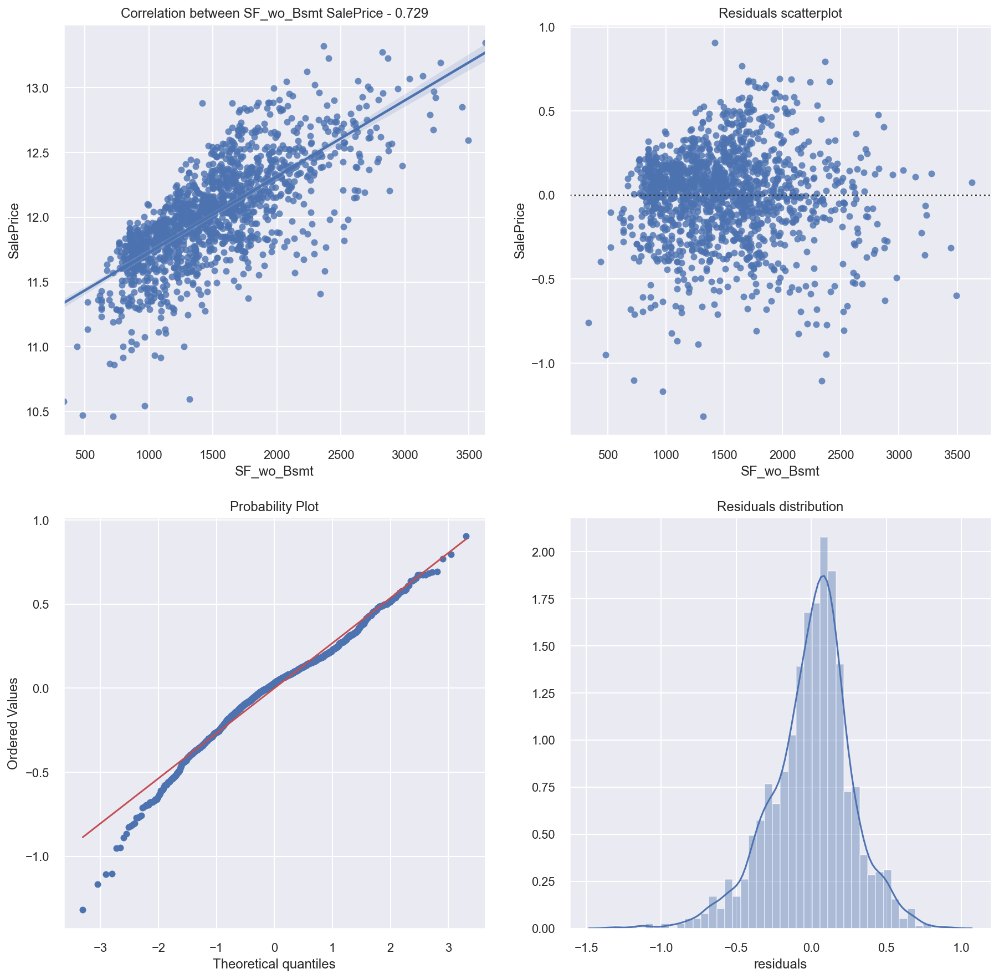

In [121]:
results_one_variable(train[['SF_wo_Bsmt']].drop(train[train['SF_wo_Bsmt']>4000].index,), y.drop(train[train['SF_wo_Bsmt']>4000].index), reg)





In [136]:
train[np.log1p(train['SF_wo_Bsmt'])< 6.5].index

Int64Index([29, 125, 434, 489, 528, 533, 614, 649, 696, 916, 1039, 1100, 1449], dtype='int64')

R2 - 0.5350046367696062
Distribution of residuals is NOT normal with p-value 0.0


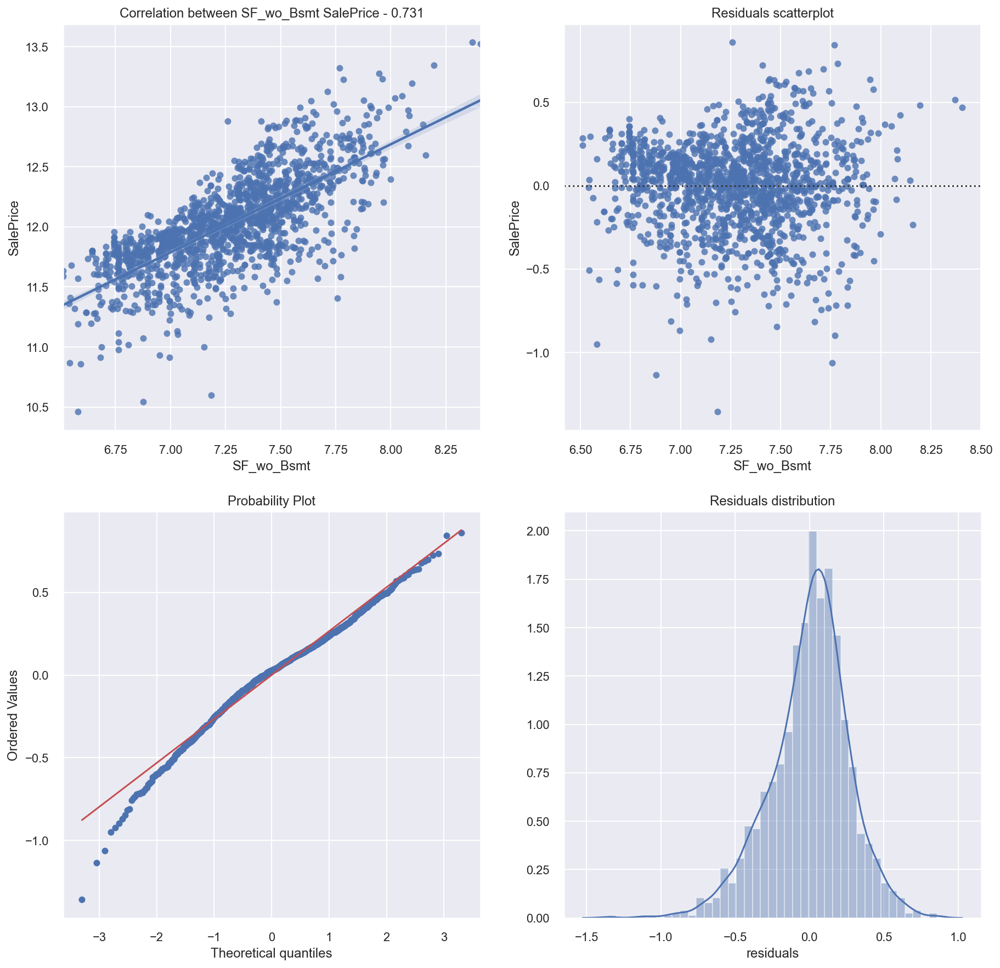

In [137]:
results_one_variable(np.log1p(train[['SF_wo_Bsmt']].drop(train[np.log1p(train['SF_wo_Bsmt'])< 6.5].index)), y.drop(train[np.log1p(train['SF_wo_Bsmt'])< 6.5].index), reg)


R2 - 0.46387010027270215
Distribution of residuals is NOT normal with p-value 0.0


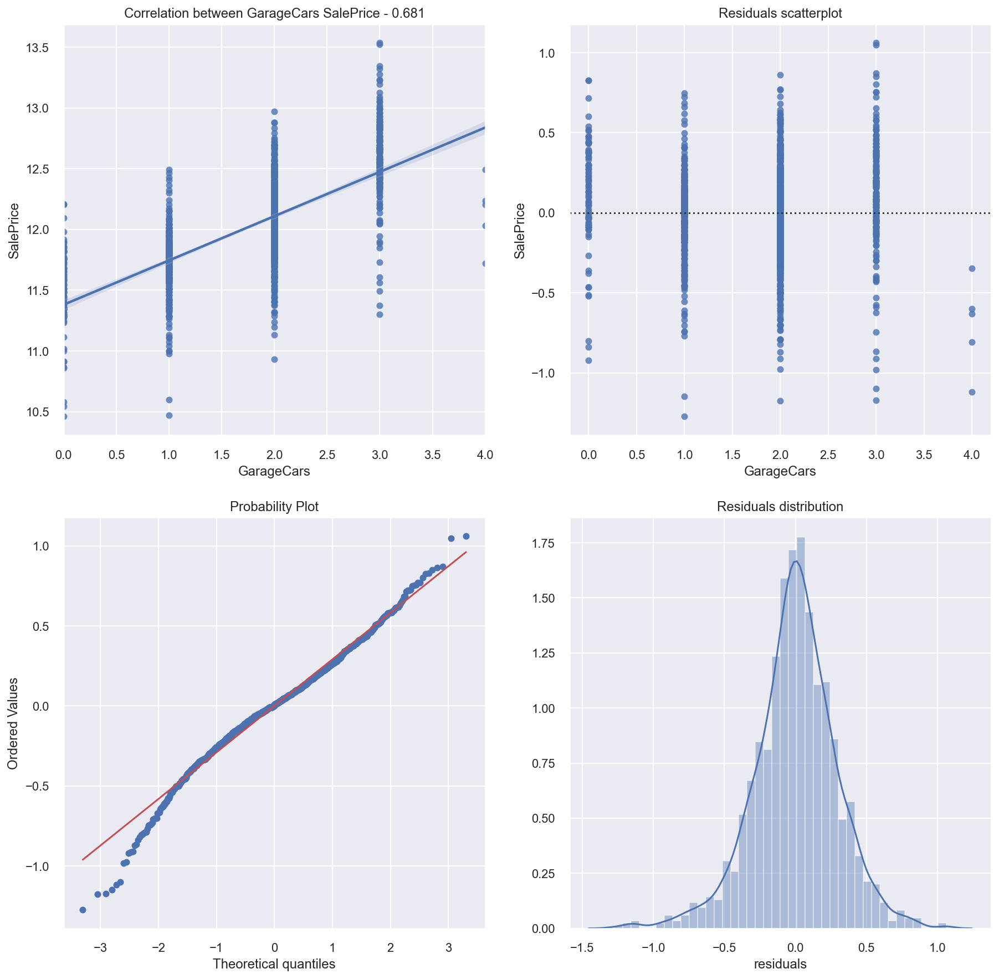

In [140]:
results_one_variable(train[['GarageCars']], y, reg)


In [143]:
train = pd.get_dummies(train)

In [145]:
cols= ['Condition1_Artery',
 'Condition1_PosA',
 'Neighborhood_OldTown',
 'HeatingQC_Ex',
 'age',
 'Electrical_FuseP',
 'YearRemodAdd',
 'YearBuilt_cat_very_old',
 'LotArea',
 'FireplaceQu_Po',
 'MSSubClass_4',
 'BsmtExposure_Gd',
 'Exterior1st_BrkComm',
 'GarageType_Attchd',
 'SaleCondition_Partial',
 'Functional_Sev',
 'OverallCond_4',
 'SF_wo_Bsmt',
 'OverallCond',
 'ExterQual_Fa',
 'Neighborhood_Crawfor',
 'Exterior2nd_Brk Cmn',
 'SaleType_New',
 'YearBuilt',
 'OverallCond_3',
 'Functional_Typ',
 'KitchenQual_Ex',
 'MSSubClass_5',
 'CentralAir_Y',
 'Functional_Maj1',
 'OverallCond_2',
 'KitchenAbvGr',
 'KitchenQual_TA',
 'OverallCond_6',
 'GarageQual_TA',
 'CentralAir_N',
 'MSZoning_RL',
 'BldgType_1Fam',
 'total_sqr',
 'GarageCond_TA',
 'ExterQual_TA',
 'MSZoning_RM',
 'Total_Bathrooms',
 'hasfireplace',
 'total_years',
 'Fireplaces',
 'BsmtQual_Ex',
 'OverallQual',
 'GarageCars',
 'SF_with_Bsmt']

R2 - 0.0169907665239446
Distribution of residuals is NOT normal with p-value 0.0
R2 - 0.0027607667309353934
Distribution of residuals is NOT normal with p-value 0.0
R2 - 0.05394458630978316
Distribution of residuals is NOT normal with p-value 0.0
R2 - 0.21810736029881816
Distribution of residuals is NOT normal with p-value 0.0
R2 - 0.32379871438121555
Distribution of residuals is NOT normal with p-value 0.0
R2 - 0.004302823412594359
Distribution of residuals is NOT normal with p-value 0.0
R2 - 0.32084210819094094
Distribution of residuals is NOT normal with p-value 0.0
R2 - 0.02446599637602198
Distribution of residuals is NOT normal with p-value 0.0
R2 - 0.16086230231903761
Distribution of residuals is NOT normal with p-value 0.0
R2 - 0.007086554489950325
Distribution of residuals is NOT normal with p-value 0.0
R2 - 0.027723332199109163
Distribution of residuals is NOT normal with p-value 0.0
R2 - 0.07422118809623446
Distribution of residuals is NOT normal with p-value 0.0
R2 - 0.00644

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.0032458278072735602
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.10978621207816641
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.3446982884920297
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.005225946803622206
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.017927301548202546
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.17427477618983245
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.029149861778890007
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.12364127986213325
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.001641591675088927
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.003855308419544956
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.021771550753061364
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.29012571627129513
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.0030751348181676796
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.10923889730183867
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.12364127986213325
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.08936247780217133
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.017552095651973576
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.5584246205247907
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.13382509782960517
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.35581582368431564
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.12075940122055306
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.4348851091394388
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.2605885017595715
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.4169787103197946
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.2429948830168549
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.21828096263668395
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.6749108973697096
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.46387010027270215
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



R2 - 0.6811607255136941
Distribution of residuals is NOT normal with p-value 0.0


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



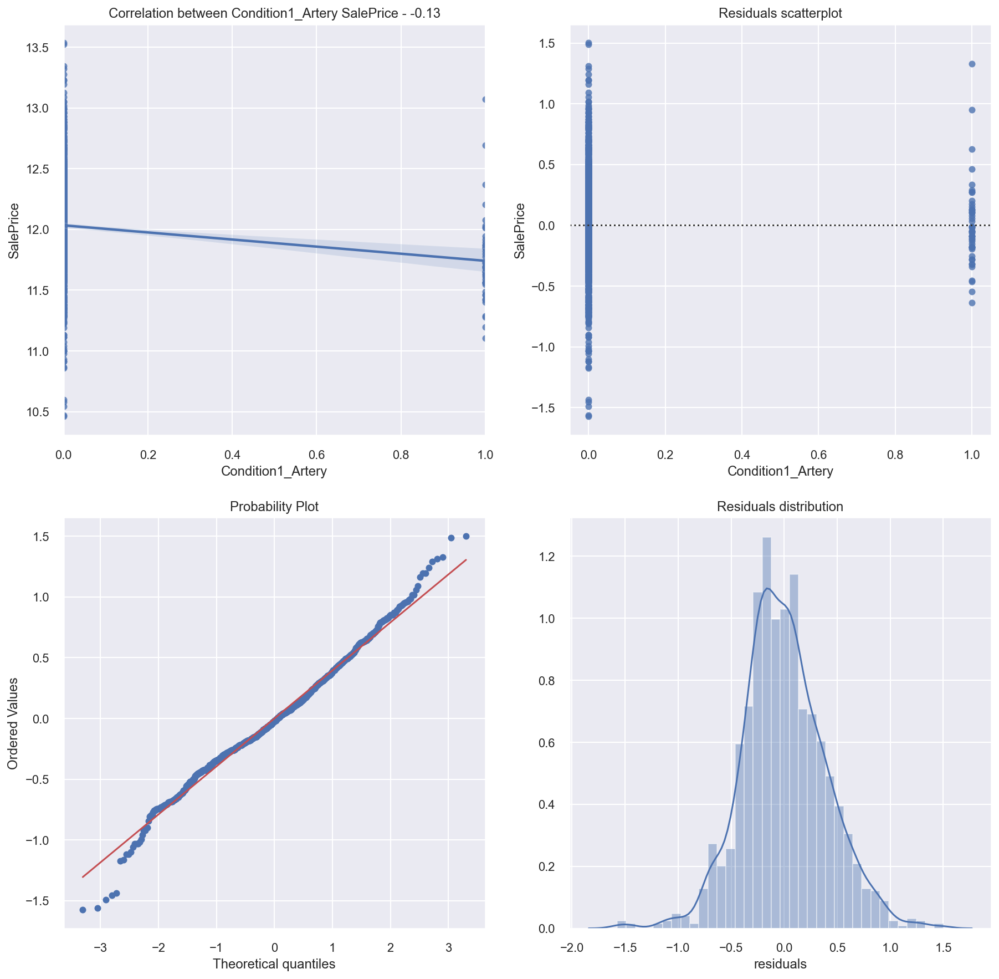

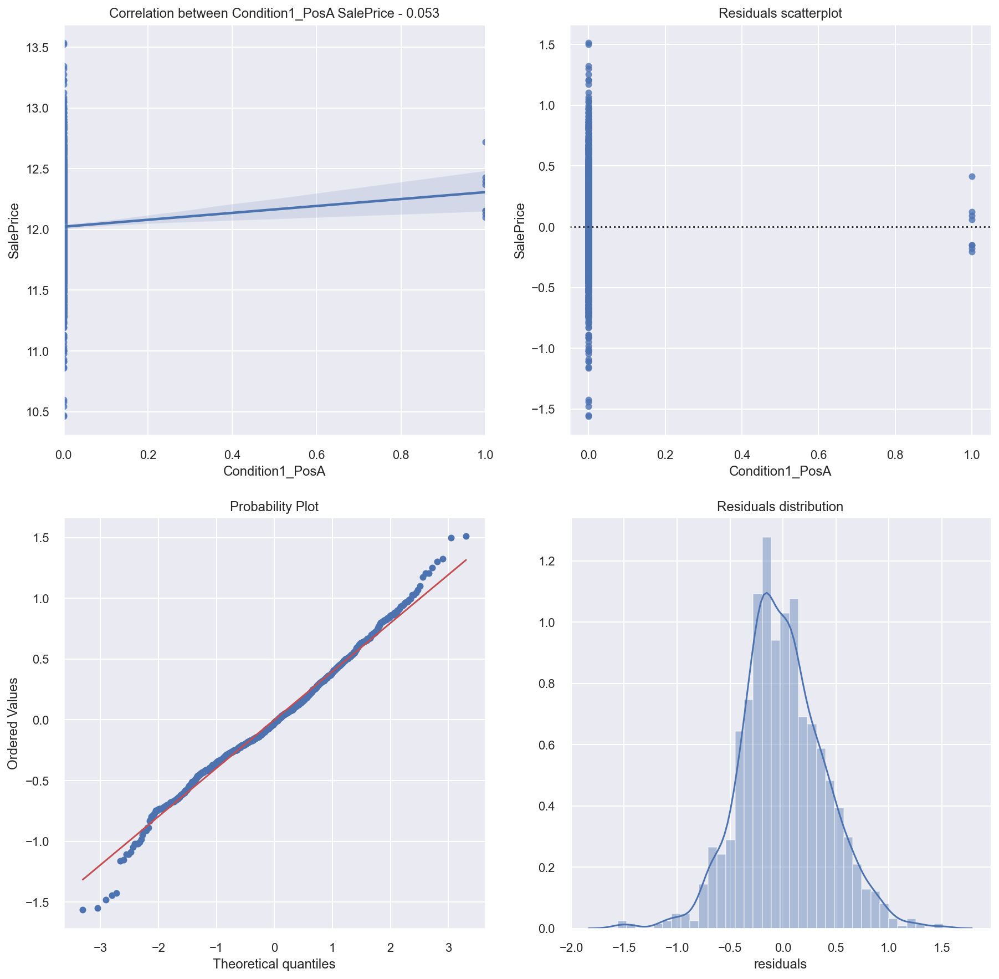

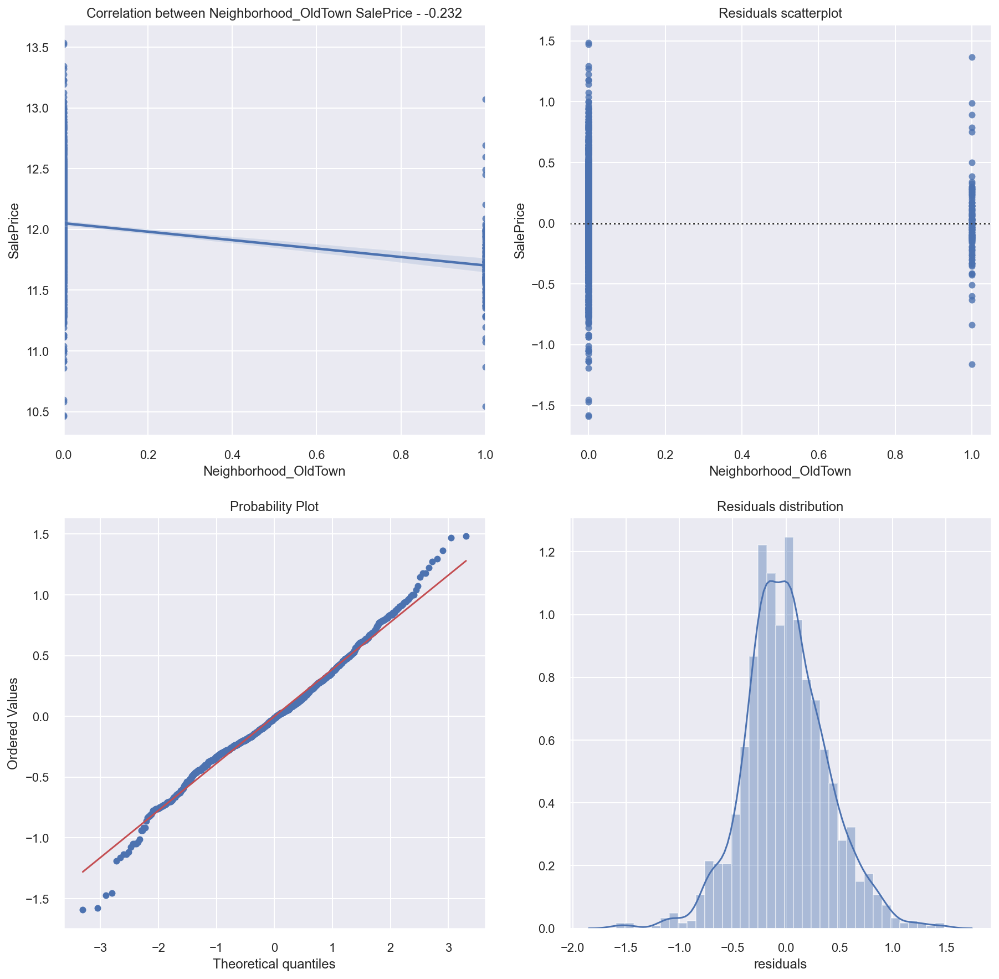

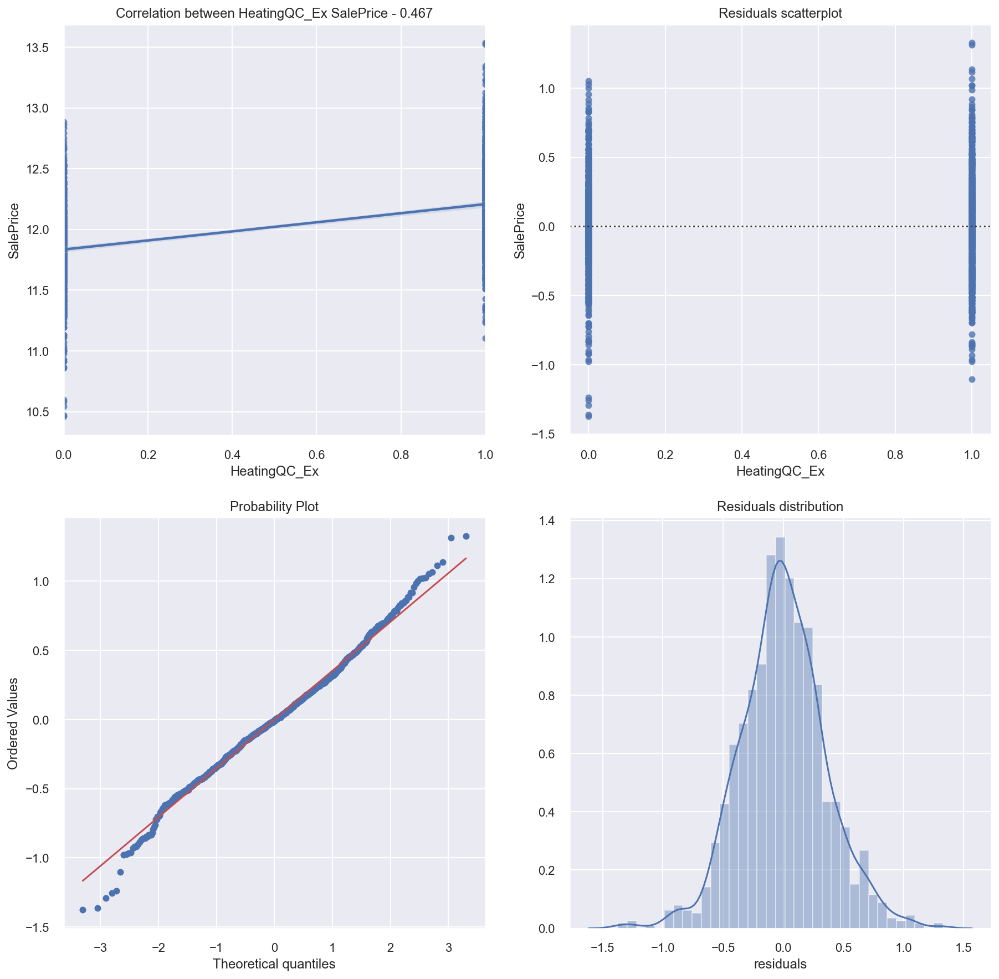

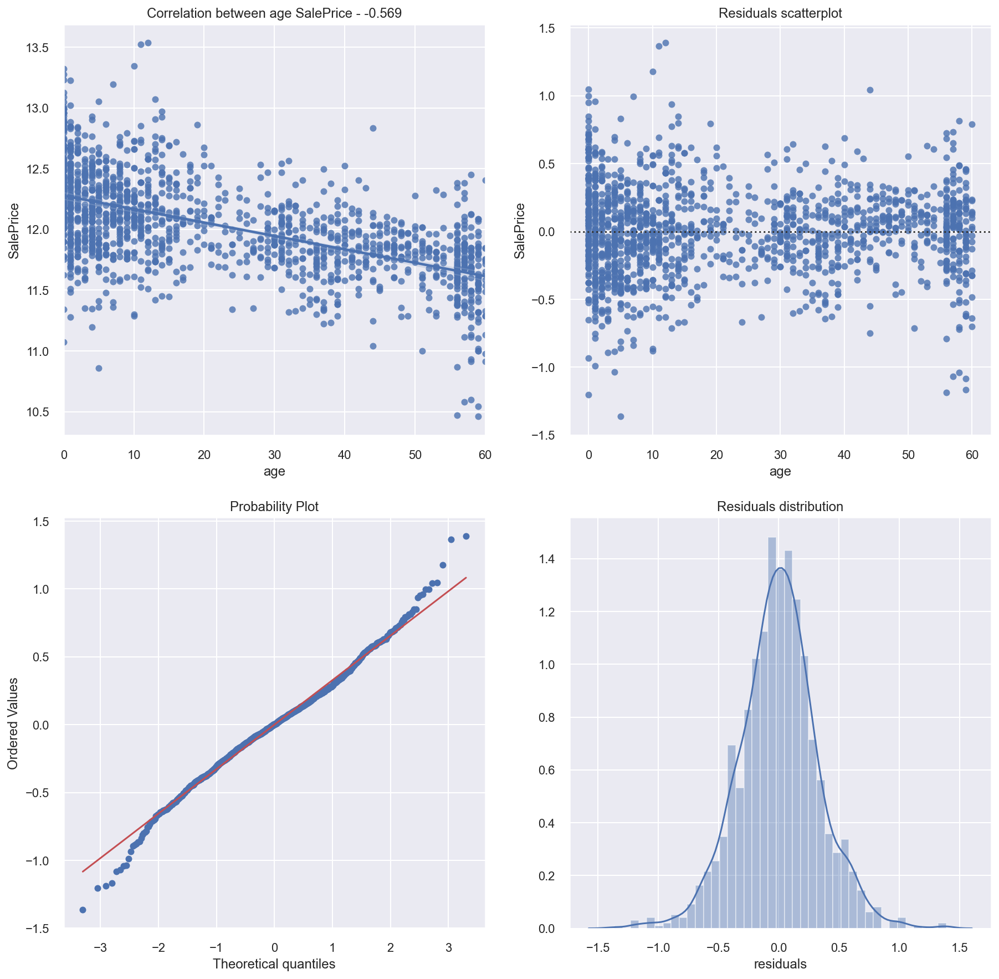

...

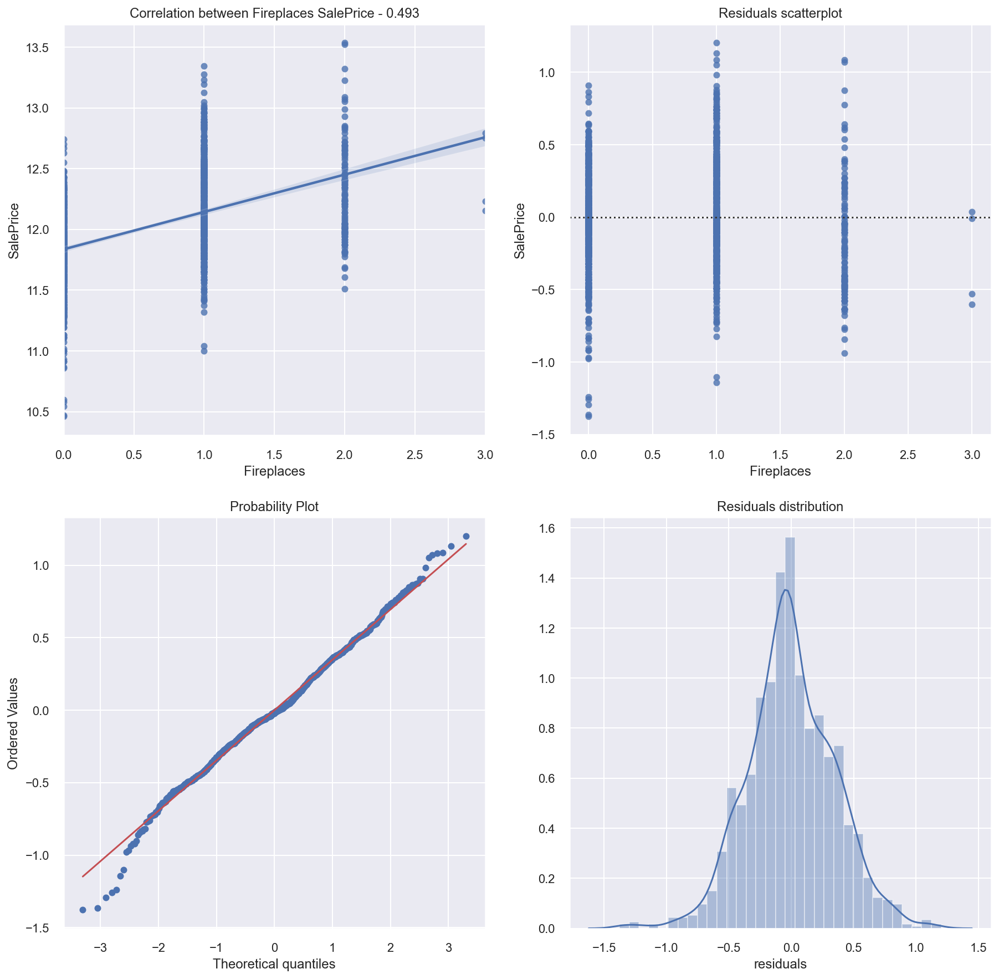

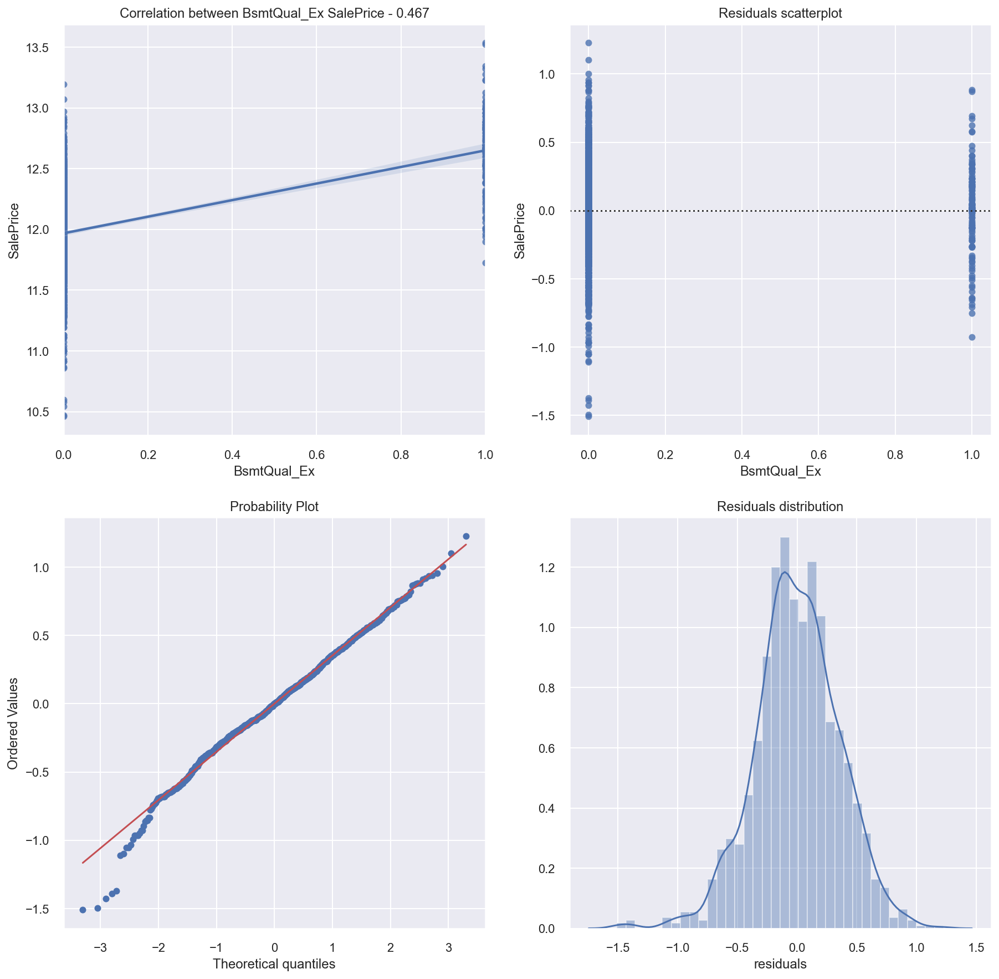

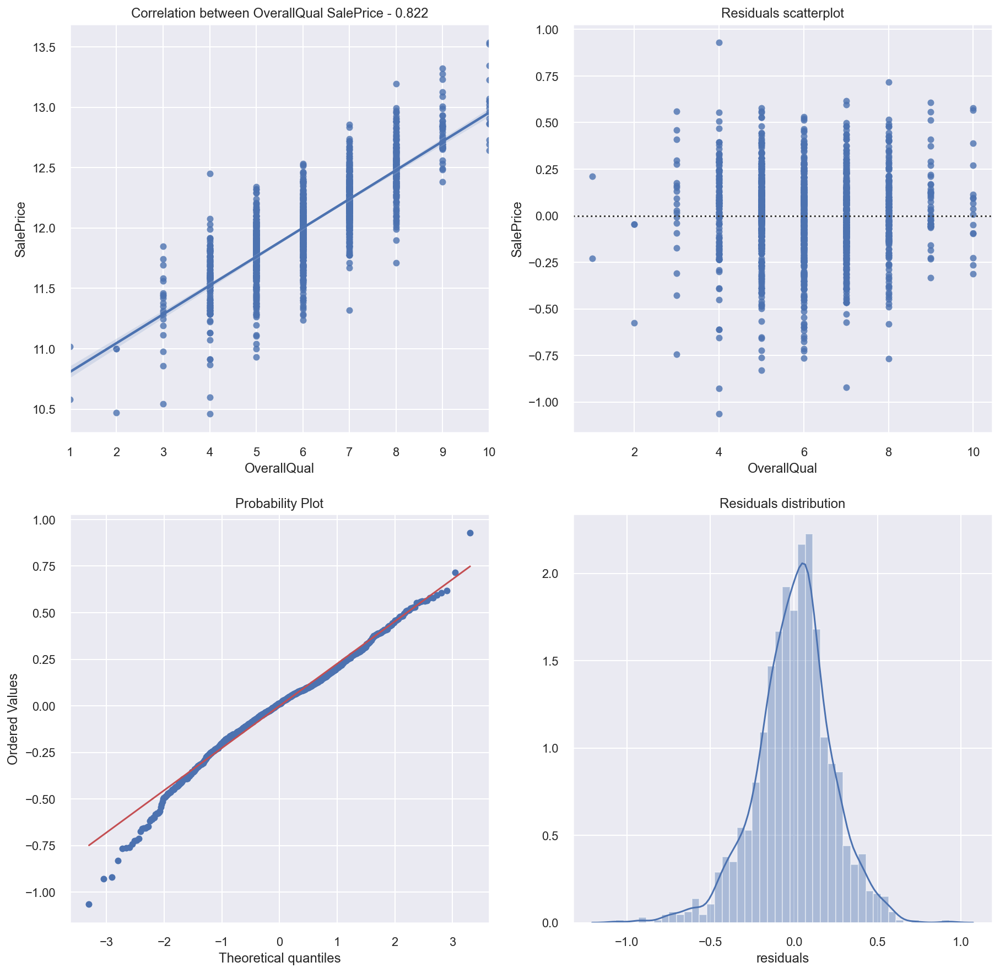

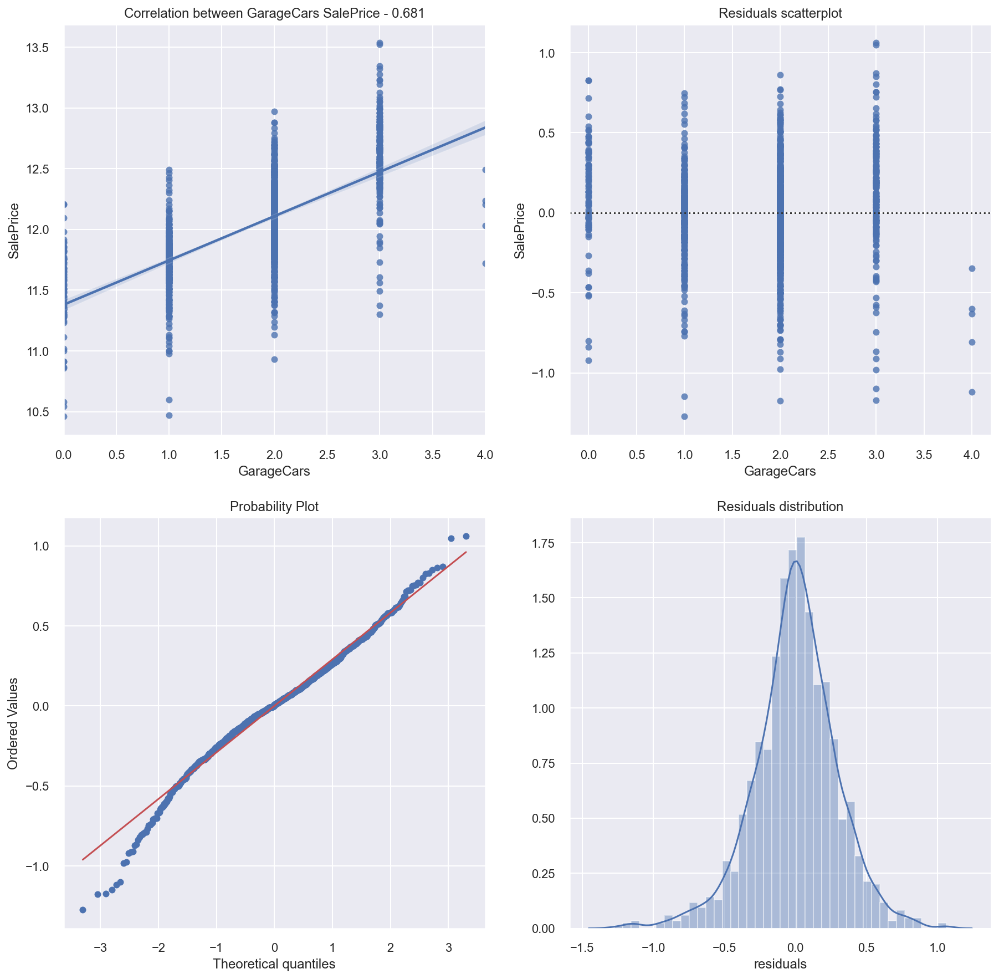

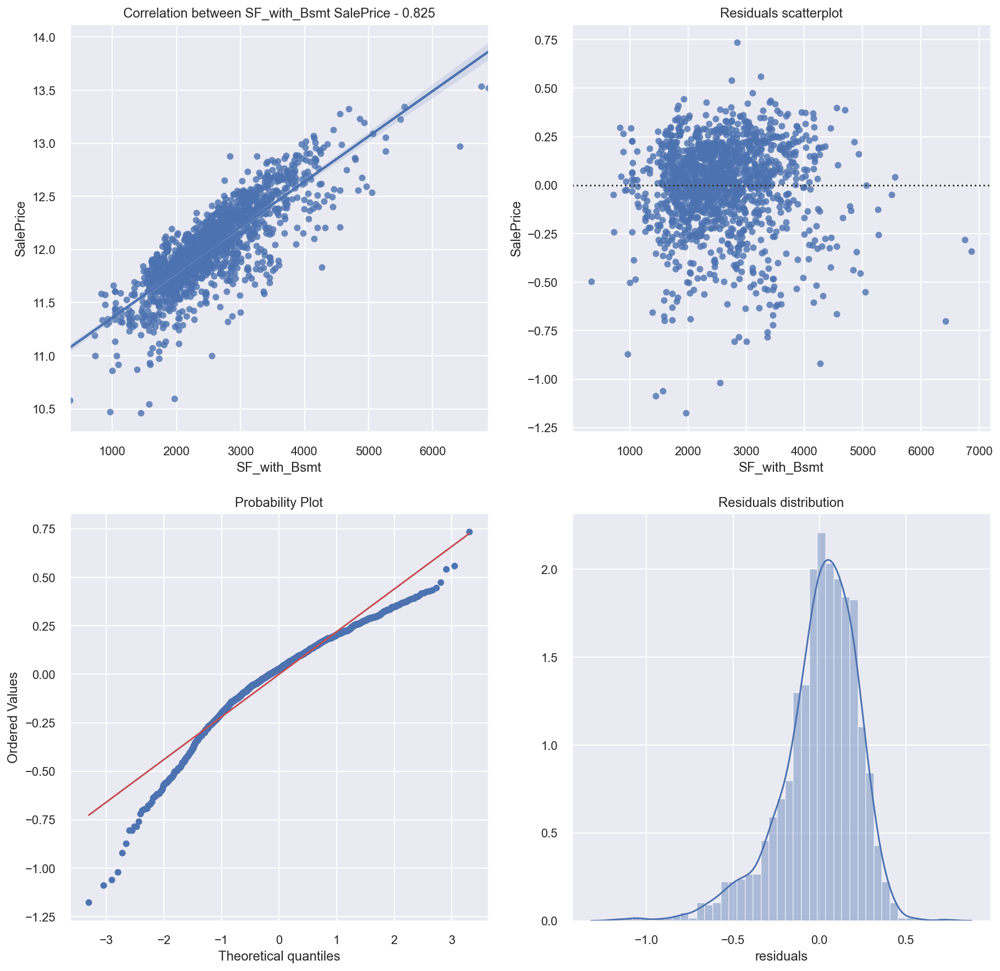

In [146]:
for i in cols:
    results_one_variable(train[[i]], y, reg)

In [116]:
train[['SF_wo_Bsmt']].max()

SF_wo_Bsmt    4476
dtype: int64

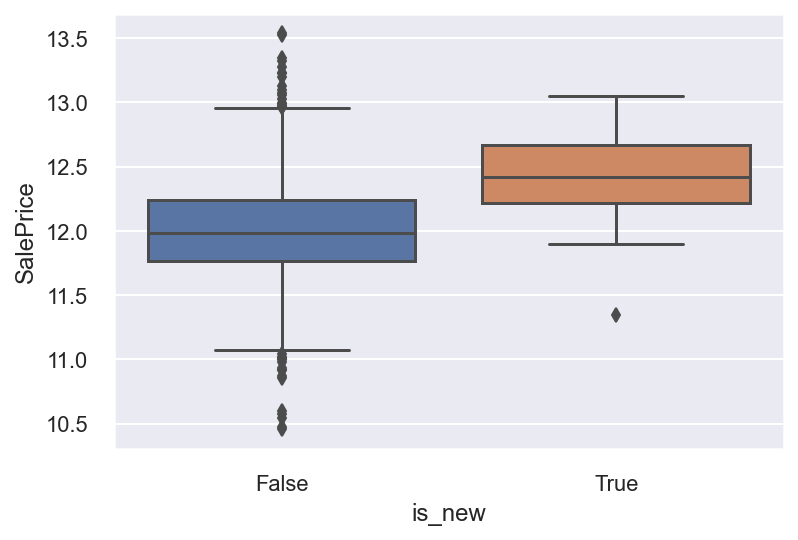

In [86]:
sns.boxplot(train['is_new'], y)

In [96]:
train_new = pd.concat([train, y], axis= 1)

In [88]:
train_new.to_csv('train_new.csv')

In [97]:
train_new.shape

(1457, 114)